In [1]:
import numpy as np
import pandas as pd
import scipy as sp
import scanpy as sc
from glob import glob
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib as mpl
from matplotlib.pyplot import rc_context
import os
import seaborn as sns
import importlib
import re

In [2]:
import degSummary
from scanpyColor import godsnot_102

In [3]:
from adjustText import adjust_text

In [4]:
from scipy.stats import ranksums

In [5]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=150, facecolor='white', dpi_save=600)

scanpy==1.8.2 anndata==0.7.5 umap==0.5.3 numpy==1.23.5 scipy==1.10.0 pandas==1.5.3 scikit-learn==1.2.0 statsmodels==0.13.5 python-igraph==0.10.3 louvain==0.8.0 pynndescent==0.5.8


In [6]:
sns.set_theme(style="ticks")

# Load data

In [7]:
os.chdir('../..')

In [8]:
pwd

'/data/tcl/Project/ADFCA'

In [9]:
age_L=['10', '20', '30']
ageColor_L=['#1F77B4', '#FF7F0E', '#2CA02C', '#D62728']
ageColor_L2=['#009ACD', '#FF7D40', '#2CA02C', '#D62728']
ggplotColor3_L= ["#F8766D", "#00BA38", "#619CFF"]
set2Color_L=["#66C2A5", "#E9936A", "#A89BB0"]

In [10]:
genotype_L=['control', 'AB42', 'hTau']

In [11]:
figureFolder = 'Analysis/Figure'
os.makedirs(figureFolder, exist_ok=True)

In [12]:
figureDataFolder=f'Analysis/Figure'
os.makedirs(figureDataFolder, exist_ok=True)
figure1Folder=f'{figureDataFolder}/Figure1'
os.makedirs(figure1Folder, exist_ok=True)
figure2Folder=f'{figureDataFolder}/Figure2'
os.makedirs(figure2Folder, exist_ok=True)
figure2PicFolder=f'{figure2Folder}/pic'
os.makedirs(figure2PicFolder, exist_ok=True)

In [13]:
figure3Folder=f'{figureDataFolder}/Figure3'
os.makedirs(figure3Folder, exist_ok=True)
figure3PicFolder=f'{figure3Folder}/pic'
os.makedirs(figure3PicFolder, exist_ok=True)

In [14]:
figure4Folder=f'{figureDataFolder}/Figure4'
os.makedirs(figure4Folder, exist_ok=True)
figure4PicFolder=f'{figure4Folder}/pic'
os.makedirs(figure4PicFolder, exist_ok=True)

In [15]:
cellnFolder=f'{figure2Folder}/cellN'
os.makedirs(cellnFolder, exist_ok=True)

compositionFolder=f'{figure2Folder}/composition'
os.makedirs(compositionFolder, exist_ok=True)

In [16]:
# degControlFolder=f'{figure2Folder}/DEG_toControl'
# os.makedirs(degControlFolder, exist_ok=True)

# degGenoAgeFolder=f'{figure2Folder}/DEG_genoAge'
# os.makedirs(degGenoAgeFolder, exist_ok=True)

# degCelltypeFolder=f'{figure2Folder}/DEG_celltype'
# os.makedirs(degCelltypeFolder, exist_ok=True)

In [17]:
# cellnFig4Folder=f'{figure4Folder}/cellN'
# os.makedirs(cellnFig4Folder, exist_ok=True)

# degN_genoAgeSummaryFolder=f'{figure4Folder}/degN_Summary'
# os.makedirs(degN_genoAgeSummaryFolder, exist_ok=True)
# degGenoAgeSummaryFolder=f'{figure4Folder}/degSummary'
# os.makedirs(degGenoAgeSummaryFolder, exist_ok=True)
# degGenoAgeSummarySelectFolder=f'{figure4Folder}/degSummary_select'
# os.makedirs(degGenoAgeSummarySelectFolder, exist_ok=True)

In [18]:
figure5Folder=f'{figureDataFolder}/Figure5'
os.makedirs(figure5Folder, exist_ok=True)
figure5PicFolder=f'{figure5Folder}/pic'
os.makedirs(figure5PicFolder, exist_ok=True)

In [19]:
figure6Folder=f'{figureDataFolder}/Figure6'
os.makedirs(figure6Folder, exist_ok=True)
figure6PicFolder=f'{figure6Folder}/pic'
os.makedirs(figure6PicFolder, exist_ok=True)

In [20]:
genoAge_L = ['control_10', 'control_20', 'control_30', 'AB42_10', 'AB42_20', 'hTau_20', 'hTau_30']

In [21]:
genoAgeSex_L = ['control_10_female', 'control_20_female', 'control_30_female', 'control_10_male', 'control_20_male', 'control_30_male', 
                'AB42_10_female', 'AB42_20_female', 'AB42_10_male', 'AB42_20_male', 
                'hTau_20_female', 'hTau_30_female', 'hTau_20_male', 'hTau_30_male']

In [22]:
celltypeN700_L = pd.read_csv(f'{cellnFolder}/celltype_cellN_n700.csv').annotation.to_list()

# neuronCellType_L = [x.strip() for x in open(f'{figure3Folder}/neuronCellType_L.txt')]
# nonNeuronCellType_L = [x.strip() for x in open(f'{figure3Folder}/nonNeuronCellType_L')]

In [23]:
# preMature_compare_L = ['hTau_20/control_20', 'hTau_30/control_30', 'AB42_10/control_10', 'AB42_20/control_20', 'control_30/control_20', 'control_20/control_10']
genoAgeCompare_L =    ['hTau_20/control_20', 'hTau_30/control_30', 'AB42_10/control_10', 'AB42_20/control_20', 'control_30/control_20', 'control_20/control_10']

In [24]:
# ageCompare
genoCompare_Df = pd.DataFrame(columns=['expSet', 'controlSet', 'age'])
genoCompare_Df.loc[0,:] = ['AB42', 'control_inAB42', '10,20']
genoCompare_Df.loc[1,:] = ['hTau', 'control_inTau', '20,30']
genoCompare_Df

,expSet,controlSet,age
0,AB42,control_inAB42,"10,20"
1,hTau,control_inTau,"20,30"


# Fig 6A: Frequency of differential expression

## Load files

In [25]:
adata_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.6/adfca_head_v0.6_woHarmony_raw.h5ad')
adata_body = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.6/adfca_body_v0.6_woHarmony_raw.h5ad')

In [26]:
adata_headBody = adata_head.concatenate(adata_body, join='outer')
adata_headBody

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


AnnData object with n_obs × n_vars = 624458 × 16219
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'leiden_1.0', 'leiden_1.5', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'leiden_7.0', 'leiden_8.0', 'leiden_9.0', 'leiden_10.0', 'adfca_annotation_group', 'adfca_annotation_subcluster'
    var: 'gene_ids', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'
    layers: 'logNormalize_exp', 'umi_counts'

In [27]:
# neuronCellType_L
broadNeuron_L = [broadtype for broadtype in pd.Categorical(adata_headBody.obs.adfca_annotation_broad).categories if 'neuron' in broadtype] # 
broadNeuron_L

['CNS neuron', 'PNS neuron', 'sensory neuron']

In [28]:
annotation_Df = pd.read_csv(f'/data/tcl/Project/ADFCA/adataProcess/v0.6/adfca_annotation_detailed_and_broad_detailed_subcluster.csv')
annotation_Df

,adfca_annotation_broad,adfca_annotation_group,adfca_annotation,adfca_annotation_subcluster,cellN
0,CNS neuron,ABeta42-specific cluster,ABeta42-specific cluster,ABeta42-specific cluster,3765
1,CNS neuron,CNS neuron ungrouped,neuron 1,neuron 1,1118
2,CNS neuron,CNS neuron ungrouped,neuron 10,neuron 10,589
3,CNS neuron,CNS neuron ungrouped,neuron 11,neuron 11,624
4,CNS neuron,CNS neuron ungrouped,neuron 12,neuron 12,417
...,...,...,...,...,...
215,sensory neuron,sensory neuron,scolopidial neuron,scolopidial neuron,659
216,tracheal cell,tracheal cell,adult tracheal cell_body,adult tracheal cell_body,7900
217,tracheal cell,tracheal cell,adult tracheal cell_head,adult tracheal cell_head,6560
218,unannotated,unannotated,antimicrobial peptide-producing cell,antimicrobial peptide-producing cell,507


In [29]:
neuronCellType_L = annotation_Df[annotation_Df.adfca_annotation_broad.isin(broadNeuron_L)].adfca_annotation.to_list()
nonNeuronCellType_L = annotation_Df[~annotation_Df.adfca_annotation_broad.isin(broadNeuron_L)].adfca_annotation.to_list()
# neuronCellType_L

In [30]:
annot2Broad_D = dict(zip(annotation_Df.adfca_annotation, annotation_Df.adfca_annotation_broad))
# annot2Broad_D

## Cell type specificity of DEG

### Load DEG file

In [31]:
degAllE05Gene_Df = pd.read_csv(f'{figure3Folder}/degSummary/degLong_Df_genotype_compareToControl_cellN700.csv', index_col=0)

In [32]:
degAllE05Gene_Df

,names,pvals,pvals_adj,logfoldchanges,annotation,group
0,Pde9,8.831894e-52,1.432445e-47,-1.246592,16-cell germline cyst in germarium region 2a a...,AB42
1,mt:lrRNA,2.705211e-32,2.193791e-28,3.499738,16-cell germline cyst in germarium region 2a a...,AB42
2,pre-rRNA:CR45845,6.289391e-26,3.400254e-22,0.674733,16-cell germline cyst in germarium region 2a a...,AB42
3,pAbp,4.220895e-26,6.845869e-22,-1.621699,16-cell germline cyst in germarium region 2a a...,hTau
4,Dscam4,6.435551e-25,2.609455e-21,6.977312,16-cell germline cyst in germarium region 2a a...,AB42
...,...,...,...,...,...,...
43616,mAChR-A,6.574077e-05,3.046427e-02,1.330468,transmedullary neuron Tm9,AB42
43617,CG32982,7.315896e-05,3.296014e-02,-0.725272,transmedullary neuron Tm9,AB42
43618,CadN2,1.217911e-05,3.950660e-02,1.349271,transmedullary neuron Tm9,hTau
43619,Fife,1.009878e-04,4.426814e-02,-1.287957,transmedullary neuron Tm9,AB42


In [33]:
degAllE05Gene_Df[(degAllE05Gene_Df.pvals_adj <= 0.05) & (degAllE05Gene_Df.group.isin(['AB42']))].to_csv(f'{figure3Folder}/degSummary/degAllE05Gene_Df_AB42.csv', index=False)
degAllE05Gene_Df[(degAllE05Gene_Df.pvals_adj <= 0.05) & (degAllE05Gene_Df.group.isin(['hTau']))].to_csv(f'{figure3Folder}/degSummary/degAllE05Gene_Df_hTau.csv', index=False)

In [34]:
degAB42_Df = pd.read_csv(f'{figure3Folder}/degSummary/degAllE05Gene_Df_AB42.csv')
degTau_Df = pd.read_csv(f'{figure3Folder}/degSummary/degAllE05Gene_Df_hTau.csv')
# degAB42_Df

In [35]:
degAB42_Df

,names,pvals,pvals_adj,logfoldchanges,annotation,group
0,Pde9,8.831894e-52,1.432445e-47,-1.246592,16-cell germline cyst in germarium region 2a a...,AB42
1,mt:lrRNA,2.705211e-32,2.193791e-28,3.499738,16-cell germline cyst in germarium region 2a a...,AB42
2,pre-rRNA:CR45845,6.289391e-26,3.400254e-22,0.674733,16-cell germline cyst in germarium region 2a a...,AB42
3,Dscam4,6.435551e-25,2.609455e-21,6.977312,16-cell germline cyst in germarium region 2a a...,AB42
4,ABeta42,5.338449e-22,1.731686e-18,28.988680,16-cell germline cyst in germarium region 2a a...,AB42
...,...,...,...,...,...,...
19396,Xbp1,6.343045e-05,3.025819e-02,5.114261,transmedullary neuron Tm9,AB42
19397,mAChR-A,6.574077e-05,3.046427e-02,1.330468,transmedullary neuron Tm9,AB42
19398,CG32982,7.315896e-05,3.296014e-02,-0.725272,transmedullary neuron Tm9,AB42
19399,Fife,1.009878e-04,4.426814e-02,-1.287957,transmedullary neuron Tm9,AB42


In [36]:
degAllE05Gene_Df_noAbeta = degAllE05Gene_Df[~degAllE05Gene_Df.names.isin(['ABeta42', 'hTau0N4Rfull'])]
degNeuron_Df_noAbeta = degAllE05Gene_Df_noAbeta[degAllE05Gene_Df_noAbeta.annotation.isin(neuronCellType_L)]
degNonNeuron_Df_noAbeta = degAllE05Gene_Df_noAbeta[degAllE05Gene_Df_noAbeta.annotation.isin(nonNeuronCellType_L)]
degNeuron_Df_noAbeta

,names,pvals,pvals_adj,logfoldchanges,annotation,group
313,Hsc70-3,1.367033e-80,2.217190e-76,6.876618,ABeta42-specific cluster,AB42
314,hzg,8.662320e-78,7.024709e-74,6.042689,ABeta42-specific cluster,AB42
315,Calr,5.075723e-39,2.744105e-35,5.846174,ABeta42-specific cluster,AB42
317,Gp93,5.557064e-28,1.802600e-24,4.749421,ABeta42-specific cluster,AB42
318,Lk6,2.344799e-28,3.803030e-24,1.899922,ABeta42-specific cluster,hTau
...,...,...,...,...,...,...
43616,mAChR-A,6.574077e-05,3.046427e-02,1.330468,transmedullary neuron Tm9,AB42
43617,CG32982,7.315896e-05,3.296014e-02,-0.725272,transmedullary neuron Tm9,AB42
43618,CadN2,1.217911e-05,3.950660e-02,1.349271,transmedullary neuron Tm9,hTau
43619,Fife,1.009878e-04,4.426814e-02,-1.287957,transmedullary neuron Tm9,AB42


### Neuronal Cells: compare DEG frequency between AB42 and hTau

In [37]:
degNeuron_L = degNeuron_Df_noAbeta.names.value_counts().index.to_list()
degN_neuron_Df = pd.DataFrame(columns=['gene', 'AB42', 'hTau'])

n=0
for n, gene in enumerate(degNeuron_L[:]):
    gene_Df = degNeuron_Df_noAbeta[degNeuron_Df_noAbeta.names == gene]
    
    abetaDegN = gene_Df.group.isin(['AB42']).sum()
    
    tauDegN = gene_Df.group.isin(['hTau']).sum()
    # print(gene, abetaDegN_10, tauDegN_20, abetaDegN_20, tauDegN_30)
    
    degN_neuron_Df.loc[len(degN_neuron_Df)] = [gene, abetaDegN, tauDegN]

degN_neuron_Df

,gene,AB42,hTau
0,lncRNA:noe,48,24
1,dpr21,51,4
2,lncRNA:Hsromega,12,38
3,hzg,44,1
4,Parp,2,38
...,...,...,...
2077,fwd,0,1
2078,wat,0,1
2079,CG12290,1,0
2080,beat-Ib,1,0


In [38]:
degN_neuron_Df[degN_neuron_Df.gene == 'Parp']

,gene,AB42,hTau
4,Parp,2,38


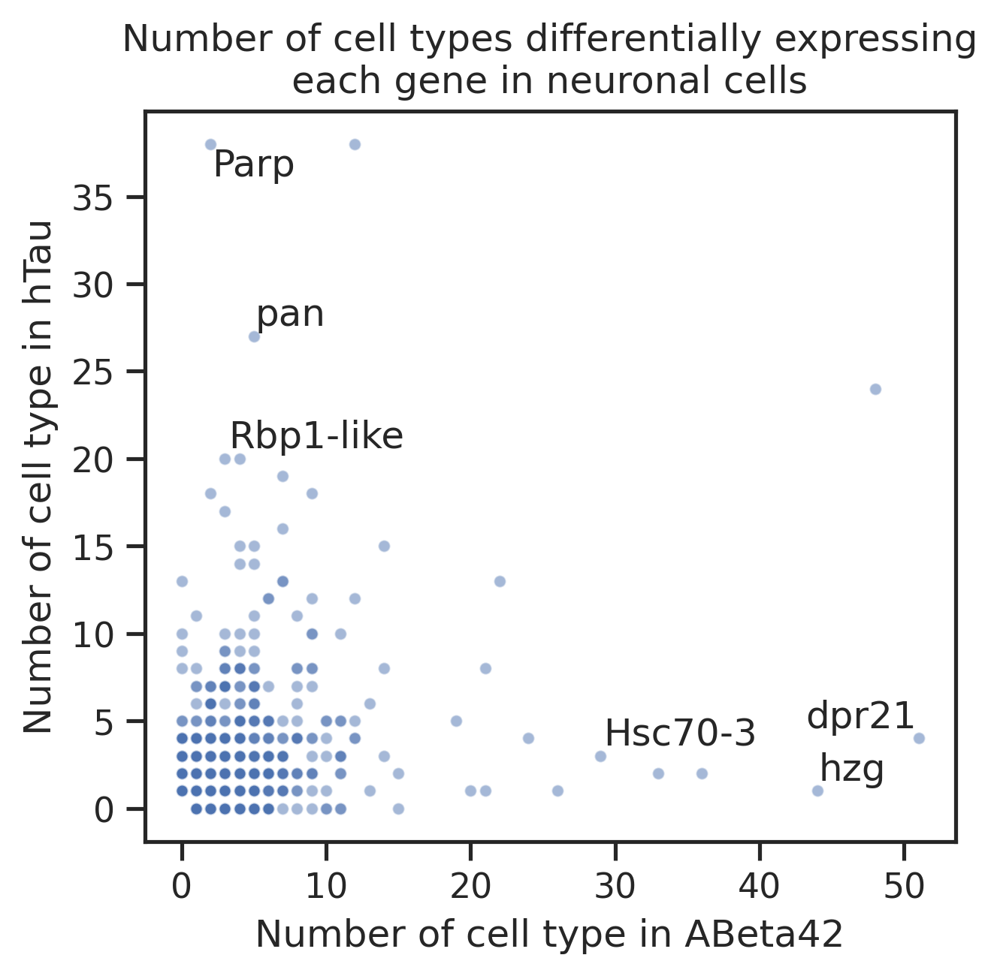

In [39]:
fig, ax = plt.subplots(figsize=(4.5, 4.5))
sns.scatterplot(x='AB42', y='hTau', data=degN_neuron_Df, alpha=0.5, ax=ax)
ax.collections[0].set_sizes([15])    
plt.xlabel('Number of cell type in ABeta42')
plt.ylabel('Number of cell type in hTau')
plt.title('Number of cell types differentially expressing\neach gene in neuronal cells')

highlight_L=['Parp', 'pan', 'Rbp1-like',  #tau
             'dpr21', 'hzg', 'Hsc70-3',  #ab42
            ]
texts = [plt.text(x=degN_neuron_Df['AB42'][n], y=degN_neuron_Df['hTau'][n], s=degN_neuron_Df.gene[n], fontsize=12) 
         for n, gene in enumerate(degN_neuron_Df.gene) if gene in highlight_L]
adjust_text(texts, ) 

plt.tight_layout()
plt.savefig(f'{figure6PicFolder}/degN_eachGene_neuron.pdf', bbox_inches='tight')
plt.show()

In [40]:
degN_neuron_Df.sort_values(by='AB42', ascending=False)[:10]

,gene,AB42,hTau
1,dpr21,51,4
0,lncRNA:noe,48,24
3,hzg,44,1
5,mt:lrRNA,36,2
6,ninaE,33,2
9,Hsc70-3,29,3
14,Pep,26,1
12,sxc,24,4
7,IA-2,22,13
11,w,21,8


In [41]:
degN_neuron_Df.sort_values(by='hTau', ascending=False, inplace=True)

In [42]:
degN_neuron_Df.index = degN_neuron_Df.gene.to_list()

In [43]:
degN_neuron_Df.head(10)

,gene,AB42,hTau
lncRNA:Hsromega,lncRNA:Hsromega,12,38
Parp,Parp,2,38
pan,pan,5,27
lncRNA:noe,lncRNA:noe,48,24
Cadps,Cadps,4,20
Rbp1-like,Rbp1-like,3,20
Lk6,Lk6,7,19
lncRNA:flam,lncRNA:flam,2,18
jim,jim,9,18
CG46385,CG46385,3,17


### Neuronal Cells: DE frequency in hTau

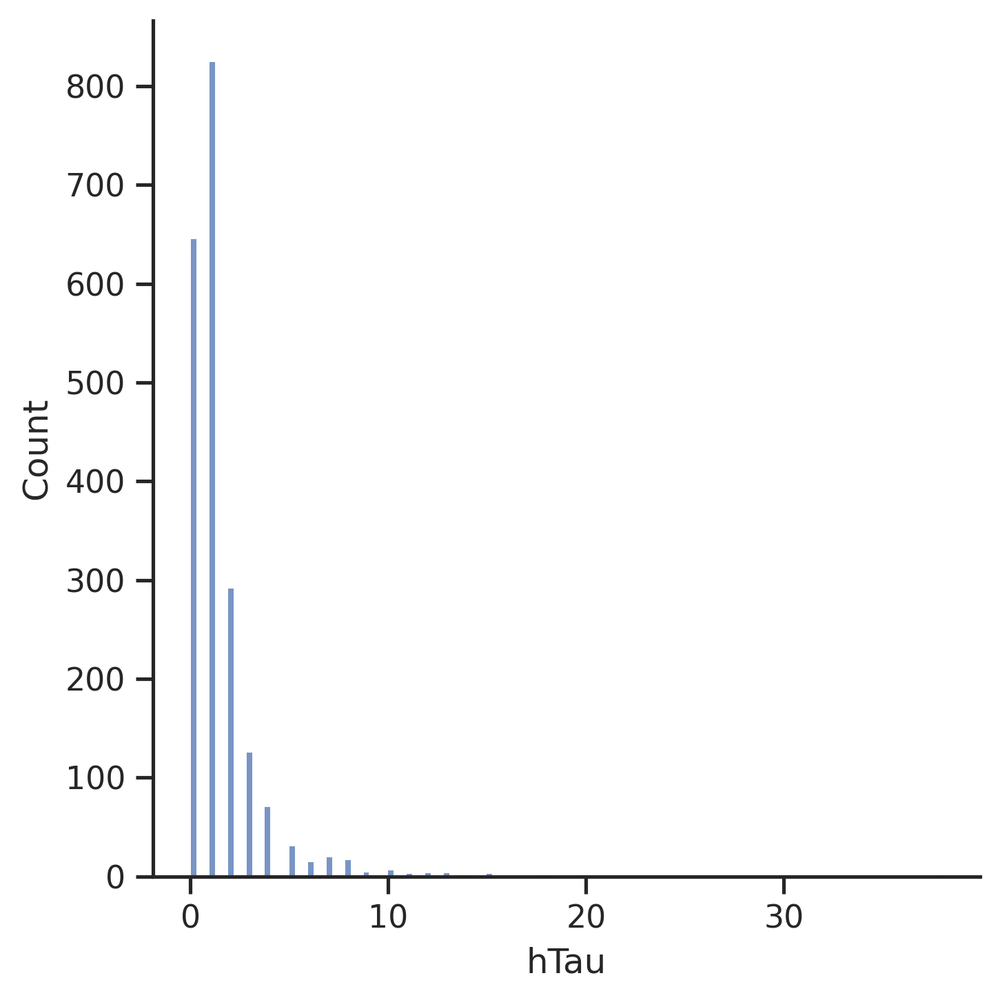

In [44]:
sns.displot(degN_neuron_Df.hTau)

In [45]:
hTau_group_L = []

for deN in degN_neuron_Df.hTau:
    if deN <=5: hTau_group_L.append('1-5')
    if 5 < deN <=10: hTau_group_L.append('5-10')
    if 10 < deN <=20: hTau_group_L.append('10-20')
    if deN > 20: hTau_group_L.append('>20')

In [47]:
degN_neuron_Df['hTau_group'] = pd.Categorical(hTau_group_L, categories=['1-5', '5-10', '10-20', '>20']) # 

In [48]:
degN_neuron_Df

,gene,AB42,hTau,hTau_group
lncRNA:Hsromega,lncRNA:Hsromega,12,38,>20
Parp,Parp,2,38,>20
pan,pan,5,27,>20
lncRNA:noe,lncRNA:noe,48,24,>20
Cadps,Cadps,4,20,10-20
...,...,...,...,...
dpr13,dpr13,1,0,1-5
BBS9,BBS9,1,0,1-5
Tat,Tat,1,0,1-5
Ptp10D,Ptp10D,1,0,1-5


In [49]:
degN_neuron_Df.to_csv(f'{figure6Folder}/degN_neuron_Df.csv', index=None)

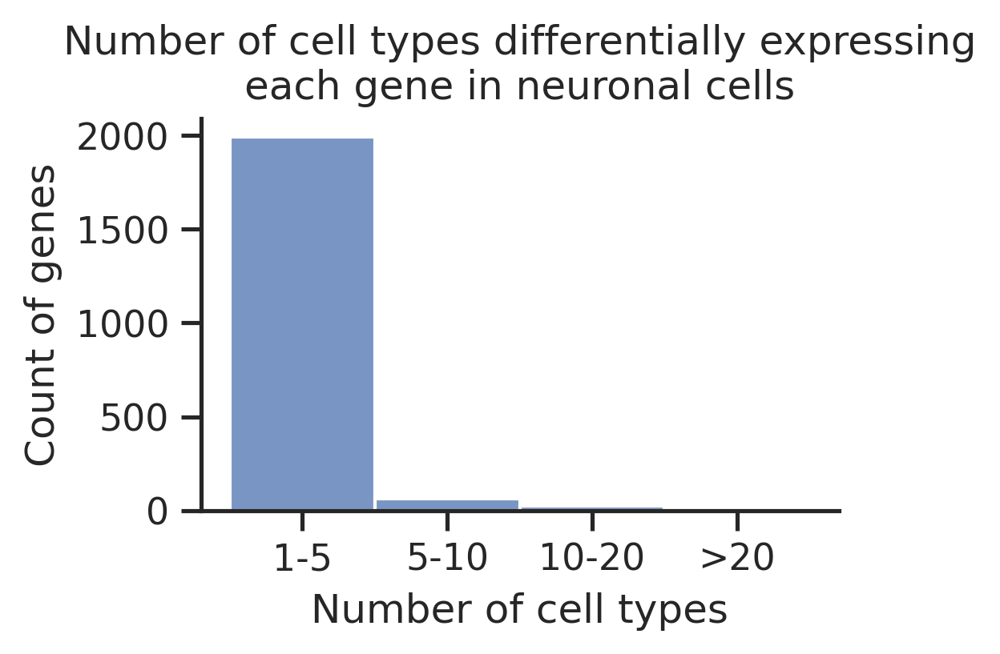

In [50]:
sns.displot(degN_neuron_Df['hTau_group'], height=2.5, aspect=1.5)
# plt.title('Genes differentially expressed in hTau')
plt.title('Number of cell types differentially expressing\neach gene in neuronal cells')
plt.xlabel('Number of cell types')
plt.ylabel('Count of genes')
plt.savefig(f'{figure6PicFolder}/deFequency_interval_hTau.pdf', bbox_inches = 'tight')
plt.show()

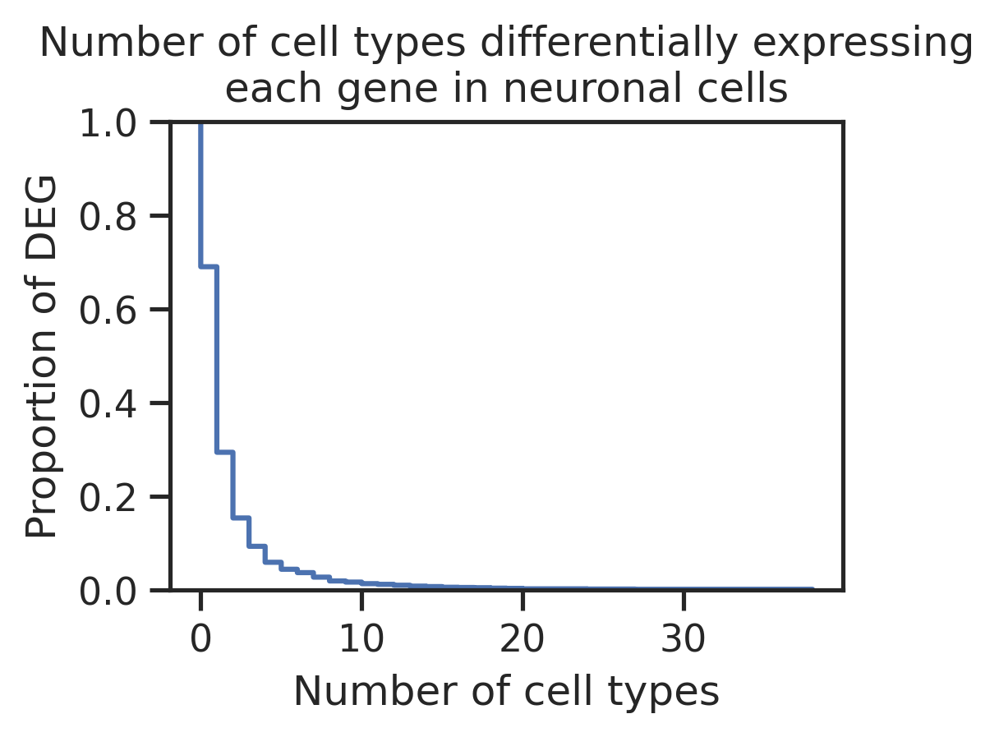

In [51]:
fig, ax = plt.subplots(figsize= (3.5, 2.5))
sns.ecdfplot(degN_neuron_Df.hTau, complementary=True, ax=ax)
# plt.title('Genes differentially expressed in hTau')
plt.title('Number of cell types differentially expressing\neach gene in neuronal cells')
plt.xlabel('Number of cell types')
plt.ylabel('Proportion of DEG')
# plt.savefig(f'{figure6PicFolder}/deFequency_interval_hTau.pdf')
plt.show()

In [53]:
degN_neuron_Df_tau = degN_neuron_Df[degN_neuron_Df.hTau != 0]
degN_neuron_Df_tau

,gene,AB42,hTau,hTau_group
lncRNA:Hsromega,lncRNA:Hsromega,12,38,>20
Parp,Parp,2,38,>20
pan,pan,5,27,>20
lncRNA:noe,lncRNA:noe,48,24,>20
Cadps,Cadps,4,20,10-20
...,...,...,...,...
wdp,wdp,0,1,1-5
tacc,tacc,1,1,1-5
CG17508,CG17508,1,1,1-5
CG3894,CG3894,1,1,1-5


In [54]:
highlight_L = degN_neuron_Df_tau.gene.to_list()[:5]
highlight_L

['lncRNA:Hsromega', 'Parp', 'pan', 'lncRNA:noe', 'Cadps']

In [55]:
degN_neuron_Df_tau['group'] = 'hTau'

/tmp/ipykernel_3363886/2807855069.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  degN_neuron_Df_tau['group'] = 'hTau'


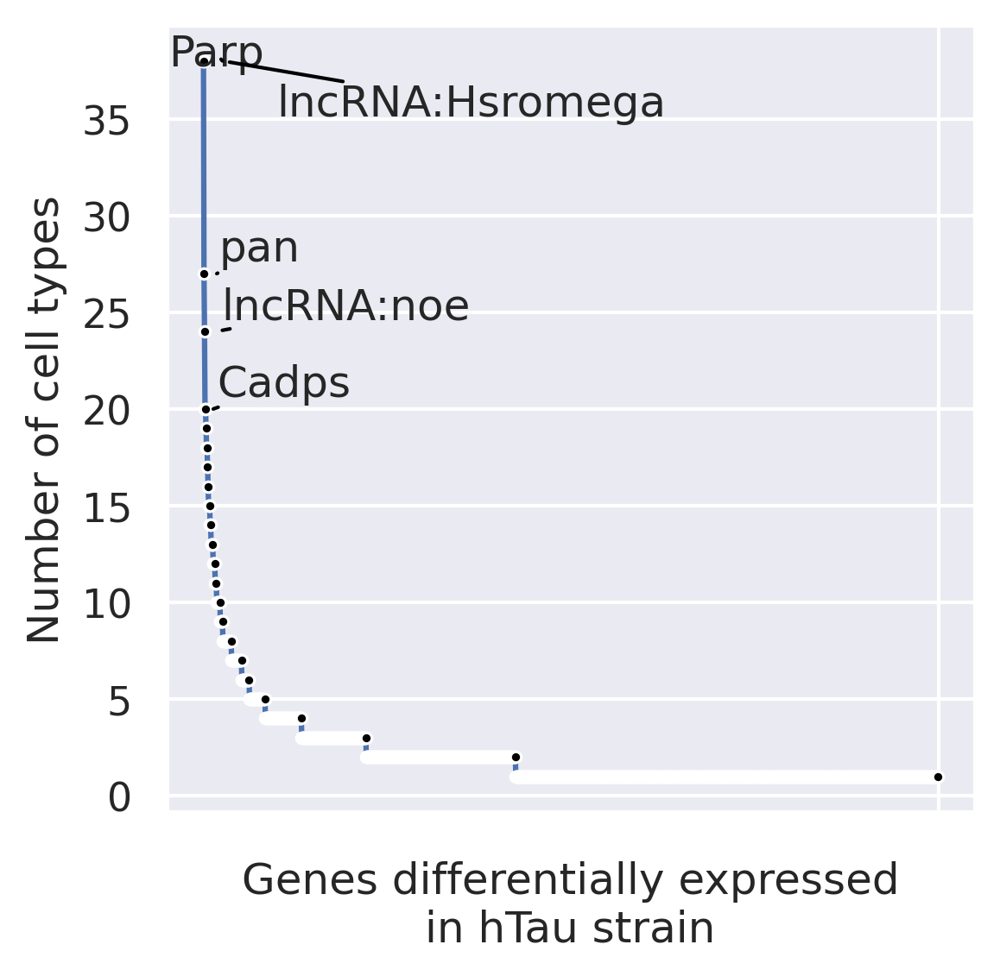

In [56]:
# sns.set_theme(style="whitegrid")
sns.set_theme()
sns.lineplot(x='gene', y='hTau', data=degN_neuron_Df_tau, marker='o', markersize=3, markerfacecolor='black') # marker='o', markersize=5, markerfacecolor='Black'
plt.xticks('')
plt.xlabel('Genes differentially expressed\nin hTau strain')
plt.ylabel('Number of cell types')


texts = [plt.text(x=degN_neuron_Df['hTau'][n], y=degN_neuron_Df['hTau'][n], s=degN_neuron_Df.gene[n])  # , fontsize=8
         for n, gene in enumerate(degN_neuron_Df.gene) if gene in highlight_L]
adjust_text(texts, arrowprops=dict(arrowstyle='-', color='black'), precision=0.001)

plt.savefig(f'{figure6PicFolder}/lineplot_deFequency_interval_hTau.pdf')

Use ggplot2 to plot this figure

# cell types with most differentail expression of Parp (hTau/control)

In [154]:
degAllE05Gene_Df_ab = pd.read_csv(f'{figure3Folder}/degSummary/degAllE05Gene_Df_AB42.csv')
degAllE05Gene_Df_tau =pd.read_csv(f'{figure3Folder}/degSummary/degAllE05Gene_Df_hTau.csv')
degAllE05Gene_Df_tau

,names,pvals,pvals_adj,logfoldchanges,annotation,group
0,pAbp,4.220895e-26,6.845869e-22,-1.621699,16-cell germline cyst in germarium region 2a a...,hTau
1,Pde9,5.593658e-25,4.536177e-21,-1.277917,16-cell germline cyst in germarium region 2a a...,hTau
2,Act5C,8.847133e-21,4.783055e-17,-1.890812,16-cell germline cyst in germarium region 2a a...,hTau
3,eIF4A,7.239146e-17,2.935293e-13,-1.398294,16-cell germline cyst in germarium region 2a a...,hTau
4,RpLP2,2.521055e-16,8.177797e-13,-2.155504,16-cell germline cyst in germarium region 2a a...,hTau
...,...,...,...,...,...,...
24215,hTau0N4Rfull,7.602237e-18,1.233007e-13,31.553896,transmedullary neuron Tm9,hTau
24216,Parp,4.122535e-06,2.648702e-02,1.357433,transmedullary neuron Tm9,hTau
24217,w,4.998918e-06,2.648702e-02,5.544986,transmedullary neuron Tm9,hTau
24218,lncRNA:Hsromega,6.532344e-06,2.648702e-02,-1.065685,transmedullary neuron Tm9,hTau


In [155]:
degAllE05_parp_Df_tau = degAllE05Gene_Df_tau[degAllE05Gene_Df_tau.names == 'Parp']
degAllE05_parp_Df_tau.sort_values(by = 'logfoldchanges', inplace=True, ascending=False)
degAllE05_parp_Df_tau['-log10_Padj'] = -np.log10(degAllE05_parp_Df_tau.pvals_adj)
degAllE05_parp_Df_tau['ChangeDirection'] = ['Increase' if logfc > 0 else 'Decrease' for logfc in degAllE05_parp_Df_tau.logfoldchanges]
degAllE05_parp_Df_tau.head(20)

/tmp/ipykernel_3188594/3446994566.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  degAllE05_parp_Df_tau.sort_values(by = 'logfoldchanges', inplace=True, ascending=False)
/tmp/ipykernel_3188594/3446994566.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  degAllE05_parp_Df_tau['-log10_Padj'] = -np.log10(degAllE05_parp_Df_tau.pvals_adj)
/tmp/ipykernel_3188594/3446994566.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: 

,names,pvals,pvals_adj,logfoldchanges,annotation,group,-log10_Padj,ChangeDirection
23183,Parp,1.462675e-18,1.186157e-14,1.787832,perineurial glial sheath,hTau,13.925858,Increase
3810,Parp,8.151338e-13,6.610328e-09,1.657970,adult glial cell,hTau,8.179777,Increase
723,Parp,2.128232e-62,3.451779e-58,1.515776,adult brain perineurial glial cell,hTau,57.461957,Increase
24143,Parp,2.413663e-17,1.304907e-13,1.383949,transmedullary neuron Tm2,hTau,12.884420,Increase
9539,Parp,7.741814e-06,3.139112e-02,1.380562,distal medullary amacrine neuron Dm3,hTau,1.503193,Increase
24205,Parp,1.978127e-08,1.069441e-04,1.378958,transmedullary neuron Tm4,hTau,3.970843,Increase
24216,Parp,4.122535e-06,2.648702e-02,1.357433,transmedullary neuron Tm9,hTau,1.576967,Increase
265,Parp,3.598308e-19,1.945366e-15,1.259915,T neuron T4/T5,hTau,14.710999,Increase
24052,Parp,4.698806e-07,8.467771e-04,1.257708,transmedullary Y neuron TmY3,hTau,3.072231,Increase
24166,Parp,3.809544e-06,1.544675e-02,1.214982,transmedullary neuron Tm20,hTau,1.811163,Increase


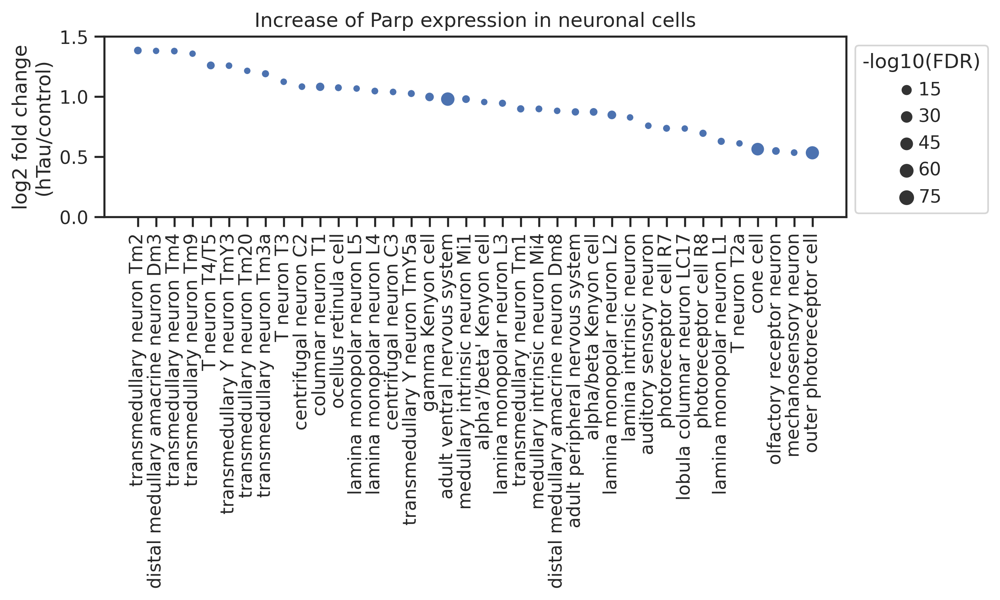

In [105]:
fig, ax = plt.subplots(figsize = (8, 2))
sns.scatterplot(data=degAllE05_parp_Df_tau[degAllE05_parp_Df_tau.annotation.isin(neuronCellType_L)], 
              x='annotation', y='logfoldchanges', size= '-log10_Padj', ax = ax)
plt.xticks(rotation=90)
plt.ylim(0, 1.5)
plt.legend(bbox_to_anchor=(1.0, 1.0), title = '-log10(FDR)')
plt.xlabel('')
plt.ylabel('log2 fold change\n(hTau/control)')
plt.title('Increase of Parp expression in neuronal cells')
plt.savefig(f'{figure6PicFolder}/dotplot_ParpExpression_neuron.pdf', bbox_inches = 'tight')

# Summry of CCC

## Load data

In [25]:
from scipy.stats import pearsonr
from scipy import stats

In [26]:
adata_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.6/adfca_head_v0.6_woHarmony_raw.h5ad')
adata_body = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.6/adfca_body_v0.6_woHarmony_raw.h5ad')

In [27]:
adata_headBody = adata_head.concatenate(adata_body, join='outer')
adata_headBody

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


AnnData object with n_obs × n_vars = 624458 × 16219
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'leiden_1.0', 'leiden_1.5', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'leiden_7.0', 'leiden_8.0', 'leiden_9.0', 'leiden_10.0', 'adfca_annotation_group', 'adfca_annotation_subcluster'
    var: 'gene_ids', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'
    layers: 'logNormalize_exp', 'umi_counts'

In [28]:
annotation_Df=pd.read_csv('/data/tcl/genomes/fly/geneName_flybaseID_602_616_631_ensemblBDGP6.88.csv')
annotation_Df

,FlyBaseID,geneName_6.02,geneName_6.16,geneName_6.31,ensembl_BDGP6.88
0,FBgn0000003,7SLRNA:CR32864,7SLRNA:CR32864,7SLRNA:CR32864,7SLRNA:CR32864
1,FBgn0000008,a,a,a,a
2,FBgn0000014,abd-A,abd-A,abd-A,abd-A
3,FBgn0000015,Abd-B,Abd-B,Abd-B,Abd-B
4,FBgn0000017,Abl,Abl,Abl,Abl
...,...,...,...,...,...
18048,FBgn0287218,NaN,NaN,CG46448,NaN
18049,FBgn0287225,NaN,NaN,bor,NaN
18050,FBgn0287234,NaN,NaN,slf,NaN
18051,FBgn0287423,NaN,NaN,Nplp2,NaN


## Load LR interaction dataset

### Load interaction data: generated by FlyPhone

In [31]:
tau_Df = pd.read_csv(f'{figure6Folder}/hTau/interaction_list.csv')
control_Df = pd.read_csv(f'{figure6Folder}/control_inTau/interaction_list.csv')
tau_Df

/tmp/ipykernel_3188594/596289768.py:1: DtypeWarning: Columns (11) have mixed types. Specify dtype option on import or set low_memory=False.
  tau_Df = pd.read_csv(f'{figure6Folder}/hTau/interaction_list.csv')
/tmp/ipykernel_3188594/596289768.py:2: DtypeWarning: Columns (11) have mixed types. Specify dtype option on import or set low_memory=False.
  control_Df = pd.read_csv(f'{figure6Folder}/control_inTau/interaction_list.csv')


,Unnamed: 0,geneid_secreted,FBgn_secreted,Gene_secreted,geneid_receptor,FBgn_receptor,Gene_receptor,pathway_receptor,standard,interaction,...,transmedullary Y neuron TmY8>transmedullary neuron Tm4_score,transmedullary Y neuron TmY8>transmedullary neuron Tm4_pvalues,transmedullary Y neuron TmY8>transmedullary neuron Tm9_score,transmedullary Y neuron TmY8>transmedullary neuron Tm9_pvalues,transmedullary Y neuron TmY8>transmedullary Y neuron TmY3_score,transmedullary Y neuron TmY8>transmedullary Y neuron TmY3_pvalues,transmedullary Y neuron TmY8>transmedullary Y neuron TmY5a_score,transmedullary Y neuron TmY8>transmedullary Y neuron TmY5a_pvalues,transmedullary Y neuron TmY8>transmedullary Y neuron TmY8_score,transmedullary Y neuron TmY8>transmedullary Y neuron TmY8_pvalues
0,1,39833,FBgn0004569,aos,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,0.000335,1.000,0.000786,1.000,0.000667,1.000,0.000958,1.000,0.000000,1.000
1,2,34171,FBgn0001137,grk,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,0.000000,1.000,0.000000,1.000,0.000000,1.000,0.000000,1.000,0.000000,1.000
2,3,326198,FBgn0052179,Krn,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,0.000089,0.999,0.000208,0.993,0.000177,0.991,0.000254,0.995,0.000000,1.000
3,4,35253,FBgn0005672,spi,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,0.002568,1.000,0.006021,1.000,0.005112,1.000,0.007340,1.000,0.000000,1.000
4,5,38657,FBgn0003984,vn,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,0.000104,1.000,0.000244,1.000,0.000207,1.000,0.000298,1.000,0.000000,1.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
189,192,33896,FBgn0011722,Tig,44885,FBgn0004657,mys,other,Stringent,other,...,0.000000,1.000,0.000000,1.000,0.000000,1.000,0.000000,1.000,0.000000,1.000
190,193,246538,FBgn0264273,Sema2b,43766,FBgn0025740,PlexB,other,Stringent,PPI,...,0.157141,0.000,0.164376,0.000,0.188004,0.000,0.167076,0.000,0.139848,0.004
191,194,41456,FBgn0037976,Tk,41286,FBgn0004841,TkR86C,other,Stringent,other,...,0.002255,0.044,0.000000,1.000,0.002328,0.051,0.011521,0.000,0.005115,0.001
192,195,41456,FBgn0037976,Tk,43551,FBgn0004622,TkR99D,other,Stringent,other,...,0.000000,1.000,0.011920,0.000,0.185661,0.000,0.024195,0.000,0.037422,0.000


In [32]:
tau_Df_TC = pd.read_csv(f'{figure6Folder}/hTau/hTau_interaction_list_TC.csv')
control_Df_TC = pd.read_csv(f'{figure6Folder}/control_inTau/control_inTau_interaction_list_TC.csv')

In [33]:
print(tau_Df.shape, control_Df.shape, tau_Df_TC.shape, control_Df_TC.shape)

(194, 20820) (194, 20820) (44, 20820) (44, 20820)


In [34]:
tau_Df = pd.concat([tau_Df, tau_Df_TC])
control_Df = pd.concat([control_Df, control_Df_TC])

tau_Df

,Unnamed: 0,geneid_secreted,FBgn_secreted,Gene_secreted,geneid_receptor,FBgn_receptor,Gene_receptor,pathway_receptor,standard,interaction,...,transmedullary Y neuron TmY8>transmedullary neuron Tm4_score,transmedullary Y neuron TmY8>transmedullary neuron Tm4_pvalues,transmedullary Y neuron TmY8>transmedullary neuron Tm9_score,transmedullary Y neuron TmY8>transmedullary neuron Tm9_pvalues,transmedullary Y neuron TmY8>transmedullary Y neuron TmY3_score,transmedullary Y neuron TmY8>transmedullary Y neuron TmY3_pvalues,transmedullary Y neuron TmY8>transmedullary Y neuron TmY5a_score,transmedullary Y neuron TmY8>transmedullary Y neuron TmY5a_pvalues,transmedullary Y neuron TmY8>transmedullary Y neuron TmY8_score,transmedullary Y neuron TmY8>transmedullary Y neuron TmY8_pvalues
0,1,39833,FBgn0004569,aos,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,0.000335,1.000,0.000786,1.000,0.000667,1.000,0.000958,1.000,0.000000,1.000
1,2,34171,FBgn0001137,grk,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,0.000000,1.000,0.000000,1.000,0.000000,1.000,0.000000,1.000,0.000000,1.000
2,3,326198,FBgn0052179,Krn,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,0.000089,0.999,0.000208,0.993,0.000177,0.991,0.000254,0.995,0.000000,1.000
3,4,35253,FBgn0005672,spi,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,0.002568,1.000,0.006021,1.000,0.005112,1.000,0.007340,1.000,0.000000,1.000
4,5,38657,FBgn0003984,vn,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,0.000104,1.000,0.000244,1.000,0.000207,1.000,0.000298,1.000,0.000000,1.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39,40,31292,FBgn0028369,kirre,44097,FBgn0024189,sns,other,Stringent,PPI,...,0.349197,0.000,0.195931,0.000,0.624489,0.000,0.222049,0.000,0.383523,0.000
40,41,31290,FBgn0003285,rst,44129,FBgn0029082,hbs,other,Stringent,PPI,...,0.004588,0.879,0.009061,0.386,0.006132,0.713,0.006025,0.739,0.010037,0.322
41,42,44129,FBgn0029082,hbs,31290,FBgn0003285,rst,other,Stringent,PPI,...,0.163476,0.000,0.108585,0.000,0.008247,0.502,0.016050,0.052,0.010037,0.322
42,43,35259,FBgn0000464,Lar,37447,FBgn0010415,Sdc,other,Stringent,PPI,...,0.778359,0.000,0.754329,0.001,0.869780,0.000,0.829631,0.000,0.793960,0.000


update gene names

In [35]:
id2GeneName_D = dict(zip(annotation_Df.FlyBaseID, annotation_Df['geneName_6.31']))

In [36]:
tau_Df['Gene_secreted'] = pd.Categorical([id2GeneName_D[flyId] for flyId in tau_Df.FBgn_secreted])
tau_Df['Gene_receptor'] = pd.Categorical([id2GeneName_D[flyId] for flyId in tau_Df.FBgn_receptor])

control_Df['Gene_secreted'] = pd.Categorical([id2GeneName_D[flyId] for flyId in control_Df.FBgn_secreted])
control_Df['Gene_receptor'] = pd.Categorical([id2GeneName_D[flyId] for flyId in control_Df.FBgn_receptor])

### import neuron and non-neuron list

In [37]:
# neuronCellType_L
broadNeuron_L = [broadtype for broadtype in pd.Categorical(adata_headBody.obs.adfca_annotation_broad).categories if 'neuron' in broadtype] # 
broadNeuron_L

['CNS neuron', 'PNS neuron', 'sensory neuron']

In [38]:
annotation_Df = pd.read_csv(f'/data/tcl/Project/ADFCA/adataProcess/v0.6/adfca_annotation_detailed_and_broad_detailed.csv')
annotation_Df

,adfca_annotation_broad,adfca_annotation_group,adfca_annotation
0,CNS neuron,ABeta42-specific cluster,ABeta42-specific cluster
1,CNS neuron,Poxn neuron,Poxn neuron
2,CNS neuron,T neuron,T neuron T2
3,CNS neuron,T neuron,T neuron T2a
4,CNS neuron,T neuron,T neuron T3
...,...,...,...
178,sensory neuron,sensory neuron,scolopidial neuron
179,tracheal cell,tracheal cell,adult tracheal cell_body
180,tracheal cell,tracheal cell,adult tracheal cell_head
181,unannotated,unannotated,antimicrobial peptide-producing cell


In [39]:
neuronCellType_L = annotation_Df[annotation_Df.adfca_annotation_broad.isin(broadNeuron_L)].adfca_annotation.to_list()
nonNeuronCellType_L = annotation_Df[~annotation_Df.adfca_annotation_broad.isin(broadNeuron_L)].adfca_annotation.to_list()
# neuronCellType_L

In [40]:
annot2Broad_D = dict(zip(annotation_Df.adfca_annotation, annotation_Df.adfca_annotation_broad))
# annot2Broad_D

### Remove comparisons without neuron cells

In [42]:
tau_Df.columns[list(range(12))].to_list()

['Unnamed: 0',
 'geneid_secreted',
 'FBgn_secreted',
 'Gene_secreted',
 'geneid_receptor',
 'FBgn_receptor',
 'Gene_receptor',
 'pathway_receptor',
 'standard',
 'interaction',
 'Source',
 'Additional_info_GO']

In [43]:
withNeuron_L = list(range(12))
for n, col in enumerate(tau_Df.columns):
    if '>' in col:
        if '_score' in col:
            spec1, spec2 = col.split('_score')[0].split('>')
        else:
            spec1, spec2 = col.split('_pvalues')[0].split('>')
            
        if spec1 in neuronCellType_L or spec2 in neuronCellType_L:
            withNeuron_L.append(n)

In [44]:
tau_Df_neu = tau_Df.iloc[:,withNeuron_L]
control_Df_neu = control_Df.iloc[:,withNeuron_L]
tau_Df_neu

,Unnamed: 0,geneid_secreted,FBgn_secreted,Gene_secreted,geneid_receptor,FBgn_receptor,Gene_receptor,pathway_receptor,standard,interaction,...,transmedullary Y neuron TmY8>transmedullary neuron Tm4_score,transmedullary Y neuron TmY8>transmedullary neuron Tm4_pvalues,transmedullary Y neuron TmY8>transmedullary neuron Tm9_score,transmedullary Y neuron TmY8>transmedullary neuron Tm9_pvalues,transmedullary Y neuron TmY8>transmedullary Y neuron TmY3_score,transmedullary Y neuron TmY8>transmedullary Y neuron TmY3_pvalues,transmedullary Y neuron TmY8>transmedullary Y neuron TmY5a_score,transmedullary Y neuron TmY8>transmedullary Y neuron TmY5a_pvalues,transmedullary Y neuron TmY8>transmedullary Y neuron TmY8_score,transmedullary Y neuron TmY8>transmedullary Y neuron TmY8_pvalues
0,1,39833,FBgn0004569,aos,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,0.000335,1.000,0.000786,1.000,0.000667,1.000,0.000958,1.000,0.000000,1.000
1,2,34171,FBgn0001137,grk,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,0.000000,1.000,0.000000,1.000,0.000000,1.000,0.000000,1.000,0.000000,1.000
2,3,326198,FBgn0052179,Krn,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,0.000089,0.999,0.000208,0.993,0.000177,0.991,0.000254,0.995,0.000000,1.000
3,4,35253,FBgn0005672,spi,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,0.002568,1.000,0.006021,1.000,0.005112,1.000,0.007340,1.000,0.000000,1.000
4,5,38657,FBgn0003984,vn,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,0.000104,1.000,0.000244,1.000,0.000207,1.000,0.000298,1.000,0.000000,1.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39,40,31292,FBgn0028369,kirre,44097,FBgn0024189,sns,other,Stringent,PPI,...,0.349197,0.000,0.195931,0.000,0.624489,0.000,0.222049,0.000,0.383523,0.000
40,41,31290,FBgn0003285,rst,44129,FBgn0029082,hbs,other,Stringent,PPI,...,0.004588,0.879,0.009061,0.386,0.006132,0.713,0.006025,0.739,0.010037,0.322
41,42,44129,FBgn0029082,hbs,31290,FBgn0003285,rst,other,Stringent,PPI,...,0.163476,0.000,0.108585,0.000,0.008247,0.502,0.016050,0.052,0.010037,0.322
42,43,35259,FBgn0000464,Lar,37447,FBgn0010415,Sdc,other,Stringent,PPI,...,0.778359,0.000,0.754329,0.001,0.869780,0.000,0.829631,0.000,0.793960,0.000


In [45]:
tau_Df_neu.to_csv(f'{figure6Folder}/hTau/interaction_list__tau_Df_neu.csv', index=False)
control_Df_neu.to_csv(f'{figure6Folder}/control_inTau/interaction_list__control_Df_neu.csv', index=False)

## Summarize deltaScore

### Create an empty dataframe for deltaScore & Pvalue

In [46]:
deltaScore_Df = tau_Df_neu.copy()
deltaScore_Df = deltaScore_Df.iloc[:, [True if '_pvalues' not in col else False for col in deltaScore_Df.columns.to_list()]]
deltaScore_Df.index = list(tau_Df_neu.Gene_secreted.astype(str) + '>' + tau_Df_neu.Gene_receptor.astype(str))
deltaScore_Df.iloc[:,12:] = np.nan
deltaScore_Df

,Unnamed: 0,geneid_secreted,FBgn_secreted,Gene_secreted,geneid_receptor,FBgn_receptor,Gene_receptor,pathway_receptor,standard,interaction,...,transmedullary Y neuron TmY8>T neuron T4/T5_score,transmedullary Y neuron TmY8>transmedullary neuron Tm1_score,transmedullary Y neuron TmY8>transmedullary neuron Tm2_score,transmedullary Y neuron TmY8>transmedullary neuron Tm20_score,transmedullary Y neuron TmY8>transmedullary neuron Tm3a_score,transmedullary Y neuron TmY8>transmedullary neuron Tm4_score,transmedullary Y neuron TmY8>transmedullary neuron Tm9_score,transmedullary Y neuron TmY8>transmedullary Y neuron TmY3_score,transmedullary Y neuron TmY8>transmedullary Y neuron TmY5a_score,transmedullary Y neuron TmY8>transmedullary Y neuron TmY8_score
aos>Egfr,1,39833,FBgn0004569,aos,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
grk>Egfr,2,34171,FBgn0001137,grk,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Krn>Egfr,3,326198,FBgn0052179,Krn,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
spi>Egfr,4,35253,FBgn0005672,spi,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
vn>Egfr,5,38657,FBgn0003984,vn,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
kirre>sns,40,31292,FBgn0028369,kirre,44097,FBgn0024189,sns,other,Stringent,PPI,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
rst>hbs,41,31290,FBgn0003285,rst,44129,FBgn0029082,hbs,other,Stringent,PPI,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
hbs>rst,42,44129,FBgn0029082,hbs,31290,FBgn0003285,rst,other,Stringent,PPI,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Lar>Sdc,43,35259,FBgn0000464,Lar,37447,FBgn0010415,Sdc,other,Stringent,PPI,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [47]:
deltaScore_Df.columns[:15]

Index(['Unnamed: 0', 'geneid_secreted', 'FBgn_secreted', 'Gene_secreted',
       'geneid_receptor', 'FBgn_receptor', 'Gene_receptor', 'pathway_receptor',
       'standard', 'interaction', 'Source', 'Additional_info_GO',
       '16-cell germline cyst in germarium region 2a and 2b>ABeta42-specific cluster_score',
       '16-cell germline cyst in germarium region 2a and 2b>adult peripheral nervous system_score',
       '16-cell germline cyst in germarium region 2a and 2b>adult ventral nervous system_score'],
      dtype='object')

In [48]:
deltaPvalue_Df = tau_Df_neu.copy()
deltaPvalue_Df = deltaPvalue_Df.iloc[:, [True if '_score' not in col else False for col in deltaPvalue_Df.columns ]]
deltaPvalue_Df.index = list(tau_Df_neu.Gene_secreted.astype(str) + '>' + tau_Df_neu.Gene_receptor.astype(str))
deltaPvalue_Df.iloc[:,12:] = np.nan
deltaPvalue_Df

,Unnamed: 0,geneid_secreted,FBgn_secreted,Gene_secreted,geneid_receptor,FBgn_receptor,Gene_receptor,pathway_receptor,standard,interaction,...,transmedullary Y neuron TmY8>T neuron T4/T5_pvalues,transmedullary Y neuron TmY8>transmedullary neuron Tm1_pvalues,transmedullary Y neuron TmY8>transmedullary neuron Tm2_pvalues,transmedullary Y neuron TmY8>transmedullary neuron Tm20_pvalues,transmedullary Y neuron TmY8>transmedullary neuron Tm3a_pvalues,transmedullary Y neuron TmY8>transmedullary neuron Tm4_pvalues,transmedullary Y neuron TmY8>transmedullary neuron Tm9_pvalues,transmedullary Y neuron TmY8>transmedullary Y neuron TmY3_pvalues,transmedullary Y neuron TmY8>transmedullary Y neuron TmY5a_pvalues,transmedullary Y neuron TmY8>transmedullary Y neuron TmY8_pvalues
aos>Egfr,1,39833,FBgn0004569,aos,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
grk>Egfr,2,34171,FBgn0001137,grk,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Krn>Egfr,3,326198,FBgn0052179,Krn,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
spi>Egfr,4,35253,FBgn0005672,spi,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
vn>Egfr,5,38657,FBgn0003984,vn,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
kirre>sns,40,31292,FBgn0028369,kirre,44097,FBgn0024189,sns,other,Stringent,PPI,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
rst>hbs,41,31290,FBgn0003285,rst,44129,FBgn0029082,hbs,other,Stringent,PPI,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
hbs>rst,42,44129,FBgn0029082,hbs,31290,FBgn0003285,rst,other,Stringent,PPI,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Lar>Sdc,43,35259,FBgn0000464,Lar,37447,FBgn0010415,Sdc,other,Stringent,PPI,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### collect scores and pvalue

In [49]:
tauScore_Df = deltaScore_Df.copy()
controlScore_Df = deltaScore_Df.copy()

tauPvalue_Df = deltaPvalue_Df.copy()
controlPvalue_Df = deltaPvalue_Df.copy()

In [50]:
tau_Df_neu

,Unnamed: 0,geneid_secreted,FBgn_secreted,Gene_secreted,geneid_receptor,FBgn_receptor,Gene_receptor,pathway_receptor,standard,interaction,...,transmedullary Y neuron TmY8>transmedullary neuron Tm4_score,transmedullary Y neuron TmY8>transmedullary neuron Tm4_pvalues,transmedullary Y neuron TmY8>transmedullary neuron Tm9_score,transmedullary Y neuron TmY8>transmedullary neuron Tm9_pvalues,transmedullary Y neuron TmY8>transmedullary Y neuron TmY3_score,transmedullary Y neuron TmY8>transmedullary Y neuron TmY3_pvalues,transmedullary Y neuron TmY8>transmedullary Y neuron TmY5a_score,transmedullary Y neuron TmY8>transmedullary Y neuron TmY5a_pvalues,transmedullary Y neuron TmY8>transmedullary Y neuron TmY8_score,transmedullary Y neuron TmY8>transmedullary Y neuron TmY8_pvalues
0,1,39833,FBgn0004569,aos,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,0.000335,1.000,0.000786,1.000,0.000667,1.000,0.000958,1.000,0.000000,1.000
1,2,34171,FBgn0001137,grk,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,0.000000,1.000,0.000000,1.000,0.000000,1.000,0.000000,1.000,0.000000,1.000
2,3,326198,FBgn0052179,Krn,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,0.000089,0.999,0.000208,0.993,0.000177,0.991,0.000254,0.995,0.000000,1.000
3,4,35253,FBgn0005672,spi,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,0.002568,1.000,0.006021,1.000,0.005112,1.000,0.007340,1.000,0.000000,1.000
4,5,38657,FBgn0003984,vn,37455,FBgn0003731,Egfr,EGFR signaling pathway,Stringent,PPI,...,0.000104,1.000,0.000244,1.000,0.000207,1.000,0.000298,1.000,0.000000,1.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39,40,31292,FBgn0028369,kirre,44097,FBgn0024189,sns,other,Stringent,PPI,...,0.349197,0.000,0.195931,0.000,0.624489,0.000,0.222049,0.000,0.383523,0.000
40,41,31290,FBgn0003285,rst,44129,FBgn0029082,hbs,other,Stringent,PPI,...,0.004588,0.879,0.009061,0.386,0.006132,0.713,0.006025,0.739,0.010037,0.322
41,42,44129,FBgn0029082,hbs,31290,FBgn0003285,rst,other,Stringent,PPI,...,0.163476,0.000,0.108585,0.000,0.008247,0.502,0.016050,0.052,0.010037,0.322
42,43,35259,FBgn0000464,Lar,37447,FBgn0010415,Sdc,other,Stringent,PPI,...,0.778359,0.000,0.754329,0.001,0.869780,0.000,0.829631,0.000,0.793960,0.000


In [51]:
for i in range(len(deltaScore_Df.index)):
    # print(i)
    
    for n, j in enumerate(range(12, len(deltaScore_Df.columns))):
        # print(deltaScore_Df.columns[j], i, j, tau_Df_neu.iloc[i, j])
        
        ### Align score
        tauScore = tau_Df_neu.iloc[i, j + n]
        controlScore = control_Df_neu.iloc[i, j + n]
        deltaScore = float(tauScore) - float(controlScore)
        
        tauScore_Df.iloc[i, j] = tauScore
        controlScore_Df.iloc[i, j] = controlScore
        deltaScore_Df.iloc[i, j] = deltaScore
        
        ### Align pvalue
        tauPvalue = tau_Df_neu.iloc[i, j+n+1]
        controlPvalue = control_Df_neu.iloc[i, j+n+1]
        
        tauPvalue_Df.iloc[i, j] = tauPvalue
        controlPvalue_Df.iloc[i, j] = controlPvalue
        
        
        # print(i, j, tauScore, controlScore, deltaScore, tauPvalue, controlPvalue)

In [52]:
deltaScore_Df.iloc[:,-12:]

,transmedullary Y neuron TmY8>T neuron T2a_score,transmedullary Y neuron TmY8>T neuron T3_score,transmedullary Y neuron TmY8>T neuron T4/T5_score,transmedullary Y neuron TmY8>transmedullary neuron Tm1_score,transmedullary Y neuron TmY8>transmedullary neuron Tm2_score,transmedullary Y neuron TmY8>transmedullary neuron Tm20_score,transmedullary Y neuron TmY8>transmedullary neuron Tm3a_score,transmedullary Y neuron TmY8>transmedullary neuron Tm4_score,transmedullary Y neuron TmY8>transmedullary neuron Tm9_score,transmedullary Y neuron TmY8>transmedullary Y neuron TmY3_score,transmedullary Y neuron TmY8>transmedullary Y neuron TmY5a_score,transmedullary Y neuron TmY8>transmedullary Y neuron TmY8_score
aos>Egfr,-0.001446,-0.002653,-0.001018,-0.001745,-0.001181,0.000000,-0.000213,-0.001967,-0.000373,0.000667,-0.002682,-0.002811
grk>Egfr,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Krn>Egfr,-0.000075,-0.000388,-0.000097,-0.000227,-0.000130,0.000000,0.000057,-0.000248,0.000039,0.000177,-0.000279,-0.000412
spi>Egfr,-0.001470,-0.010488,-0.002389,-0.006016,-0.003347,0.000000,0.001919,-0.006535,0.001441,0.005112,-0.007050,-0.011114
vn>Egfr,-0.001425,-0.001823,-0.000866,-0.001289,-0.000946,0.000000,-0.000427,-0.001478,-0.000552,0.000207,-0.002204,-0.001932
...,...,...,...,...,...,...,...,...,...,...,...,...
kirre>sns,-0.025375,-0.068088,-0.003405,-0.030592,0.034374,-0.036673,-0.025715,-0.046968,-0.002074,-0.075945,-0.026046,-0.006273
rst>hbs,0.003305,0.002723,0.005673,0.001756,0.004507,0.004634,0.003787,0.002073,0.006644,0.004482,0.003539,0.006983
hbs>rst,0.018068,0.028539,0.008572,-0.021500,0.000384,-0.001848,-0.026953,0.001354,0.011326,-0.007081,0.001593,0.006983
Lar>Sdc,-0.106157,-0.120117,-0.151640,-0.144532,-0.143815,-0.111953,-0.104711,-0.110038,-0.098667,-0.143032,-0.189205,-0.213509


In [53]:
tauScore_Df = tauScore_Df.iloc[:, [3, 6, 7, 11]+list(range(12, len(tauScore_Df.columns)))]
controlScore_Df = controlScore_Df.iloc[:, [3, 6, 7, 11]+list(range(12, len(controlScore_Df.columns)))]
deltaScore_Df = deltaScore_Df.iloc[:, [3, 6, 7, 11]+list(range(12, len(deltaScore_Df.columns)))]
deltaScore_Df

,Gene_secreted,Gene_receptor,pathway_receptor,Additional_info_GO,16-cell germline cyst in germarium region 2a and 2b>ABeta42-specific cluster_score,16-cell germline cyst in germarium region 2a and 2b>adult peripheral nervous system_score,16-cell germline cyst in germarium region 2a and 2b>adult ventral nervous system_score,16-cell germline cyst in germarium region 2a and 2b>alpha'/beta' Kenyon cell_score,16-cell germline cyst in germarium region 2a and 2b>alpha/beta Kenyon cell_score,16-cell germline cyst in germarium region 2a and 2b>auditory sensory neuron_score,...,transmedullary Y neuron TmY8>T neuron T4/T5_score,transmedullary Y neuron TmY8>transmedullary neuron Tm1_score,transmedullary Y neuron TmY8>transmedullary neuron Tm2_score,transmedullary Y neuron TmY8>transmedullary neuron Tm20_score,transmedullary Y neuron TmY8>transmedullary neuron Tm3a_score,transmedullary Y neuron TmY8>transmedullary neuron Tm4_score,transmedullary Y neuron TmY8>transmedullary neuron Tm9_score,transmedullary Y neuron TmY8>transmedullary Y neuron TmY3_score,transmedullary Y neuron TmY8>transmedullary Y neuron TmY5a_score,transmedullary Y neuron TmY8>transmedullary Y neuron TmY8_score
aos>Egfr,aos,Egfr,EGFR signaling pathway,NaN,0.004700,0.008612,0.012960,0.002694,0.001828,-0.001416,...,-0.001018,-0.001745,-0.001181,0.000000,-0.000213,-0.001967,-0.000373,0.000667,-0.002682,-0.002811
grk>Egfr,grk,Egfr,EGFR signaling pathway,NaN,-0.001537,-0.000618,0.001894,0.000093,-0.000520,-0.003065,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Krn>Egfr,Krn,Egfr,EGFR signaling pathway,NaN,-0.000285,0.000969,0.003373,0.000497,-0.000058,-0.002306,...,-0.000097,-0.000227,-0.000130,0.000000,0.000057,-0.000248,0.000039,0.000177,-0.000279,-0.000412
spi>Egfr,spi,Egfr,EGFR signaling pathway,NaN,0.000523,0.008778,0.023248,0.003762,0.000482,-0.012699,...,-0.002389,-0.006016,-0.003347,0.000000,0.001919,-0.006535,0.001441,0.005112,-0.007050,-0.011114
vn>Egfr,vn,Egfr,EGFR signaling pathway,NaN,0.000076,0.002107,0.005697,0.000915,0.000100,-0.003179,...,-0.000866,-0.001289,-0.000946,0.000000,-0.000427,-0.001478,-0.000552,0.000207,-0.002204,-0.001932
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
kirre>sns,kirre,sns,other,heterophilic cell-cell adhesion via plasma mem...,0.008137,0.023580,0.122658,0.005910,-0.059915,0.046990,...,-0.003405,-0.030592,0.034374,-0.036673,-0.025715,-0.046968,-0.002074,-0.075945,-0.026046,-0.006273
rst>hbs,rst,hbs,other,heterophilic cell-cell adhesion via plasma mem...,-0.035842,0.003996,-0.006157,-0.029004,-0.012180,-0.023063,...,0.005673,0.001756,0.004507,0.004634,0.003787,0.002073,0.006644,0.004482,0.003539,0.006983
hbs>rst,hbs,rst,other,heterophilic cell-cell adhesion via plasma mem...,-0.001106,-0.000784,-0.001007,-0.000265,-0.000370,-0.001501,...,0.008572,-0.021500,0.000384,-0.001848,-0.026953,0.001354,0.011326,-0.007081,0.001593,0.006983
Lar>Sdc,Lar,Sdc,other,NaN,-0.057198,0.037183,-0.053079,-0.034192,-0.042820,-0.053947,...,-0.151640,-0.144532,-0.143815,-0.111953,-0.104711,-0.110038,-0.098667,-0.143032,-0.189205,-0.213509


In [54]:
tauPvalue_Df = tauPvalue_Df.iloc[:, [3, 6, 7, 11]+list(range(12, len(tauPvalue_Df.columns)))]
controlPvalue_Df = controlPvalue_Df.iloc[:, [3, 6, 7, 11]+list(range(12, len(controlPvalue_Df.columns)))]
tauPvalue_Df

,Gene_secreted,Gene_receptor,pathway_receptor,Additional_info_GO,16-cell germline cyst in germarium region 2a and 2b>ABeta42-specific cluster_pvalues,16-cell germline cyst in germarium region 2a and 2b>adult peripheral nervous system_pvalues,16-cell germline cyst in germarium region 2a and 2b>adult ventral nervous system_pvalues,16-cell germline cyst in germarium region 2a and 2b>alpha'/beta' Kenyon cell_pvalues,16-cell germline cyst in germarium region 2a and 2b>alpha/beta Kenyon cell_pvalues,16-cell germline cyst in germarium region 2a and 2b>auditory sensory neuron_pvalues,...,transmedullary Y neuron TmY8>T neuron T4/T5_pvalues,transmedullary Y neuron TmY8>transmedullary neuron Tm1_pvalues,transmedullary Y neuron TmY8>transmedullary neuron Tm2_pvalues,transmedullary Y neuron TmY8>transmedullary neuron Tm20_pvalues,transmedullary Y neuron TmY8>transmedullary neuron Tm3a_pvalues,transmedullary Y neuron TmY8>transmedullary neuron Tm4_pvalues,transmedullary Y neuron TmY8>transmedullary neuron Tm9_pvalues,transmedullary Y neuron TmY8>transmedullary Y neuron TmY3_pvalues,transmedullary Y neuron TmY8>transmedullary Y neuron TmY5a_pvalues,transmedullary Y neuron TmY8>transmedullary Y neuron TmY8_pvalues
aos>Egfr,aos,Egfr,EGFR signaling pathway,NaN,1.000,1.000,1.000,1.0,1.000,1.000,...,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000
grk>Egfr,grk,Egfr,EGFR signaling pathway,NaN,1.000,0.999,0.999,1.0,0.999,1.000,...,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000
Krn>Egfr,Krn,Egfr,EGFR signaling pathway,NaN,1.000,0.998,0.999,1.0,1.000,1.000,...,0.996,0.996,0.993,1.000,0.992,0.999,0.993,0.991,0.995,1.000
spi>Egfr,spi,Egfr,EGFR signaling pathway,NaN,1.000,1.000,1.000,1.0,1.000,1.000,...,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000
vn>Egfr,vn,Egfr,EGFR signaling pathway,NaN,1.000,1.000,1.000,1.0,1.000,1.000,...,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
kirre>sns,kirre,sns,other,heterophilic cell-cell adhesion via plasma mem...,0.000,0.000,0.000,0.0,0.000,0.000,...,0.000,0.225,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
rst>hbs,rst,hbs,other,heterophilic cell-cell adhesion via plasma mem...,0.000,0.000,0.000,0.0,0.000,0.000,...,0.472,0.998,0.739,0.527,0.754,0.879,0.386,0.713,0.739,0.322
hbs>rst,hbs,rst,other,heterophilic cell-cell adhesion via plasma mem...,1.000,1.000,1.000,1.0,1.000,0.999,...,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.502,0.052,0.322
Lar>Sdc,Lar,Sdc,other,NaN,0.945,0.989,0.328,1.0,1.000,0.049,...,0.000,0.000,0.000,0.000,0.000,0.000,0.001,0.000,0.000,0.000


In [55]:
# score
tauScore_Df.insert(loc=0, column='LR_pair', value=tauScore_Df.index.to_list())
tauScore_Df.insert( loc=1, column='pathway_GO', value= list(tau_Df_neu.pathway_receptor.astype(str) + '|' + tau_Df_neu.Additional_info_GO.astype(str)) )
controlScore_Df.insert(loc=0, column='LR_pair', value=controlScore_Df.index.to_list())
controlScore_Df.insert( loc=1, column='pathway_GO', value= list(tau_Df_neu.pathway_receptor.astype(str) + '|' + tau_Df_neu.Additional_info_GO.astype(str)) )
deltaScore_Df.insert(loc=0, column='LR_pair', value=deltaScore_Df.index.to_list())
deltaScore_Df.insert( loc=1, column='pathway_GO', value= list(tau_Df_neu.pathway_receptor.astype(str) + '|' + tau_Df_neu.Additional_info_GO.astype(str)) )
# pvalue
tauPvalue_Df.insert(loc=0, column='LR_pair', value=tauPvalue_Df.index.to_list())
tauPvalue_Df.insert( loc=1, column='pathway_GO', value= list(tau_Df_neu.pathway_receptor.astype(str) + '|' + tau_Df_neu.Additional_info_GO.astype(str)) )
controlPvalue_Df.insert(loc=0, column='LR_pair', value=controlPvalue_Df.index.to_list())
controlPvalue_Df.insert( loc=1, column='pathway_GO', value= list(tau_Df_neu.pathway_receptor.astype(str) + '|' + tau_Df_neu.Additional_info_GO.astype(str)) )

In [56]:
tau_DEG_Df = tauScore_Df.iloc[:, list(range(4)) + list(range(6, len(tauScore_Df.columns))) ].melt(
    id_vars=['LR_pair', 'pathway_GO', 'Gene_secreted', 'Gene_receptor'] ,var_name='cellTypePair', value_name = 'tauScore')
control_DEG_Df = controlScore_Df.iloc[:, list(range(4)) + list(range(6, len(controlScore_Df.columns))) ].melt(
    id_vars=['LR_pair', 'pathway_GO', 'Gene_secreted', 'Gene_receptor'] ,var_name='cellTypePair', value_name = 'controlScore')
delta_DEG_Df = deltaScore_Df.iloc[:, list(range(4)) + list(range(6, len(deltaScore_Df.columns))) ].melt(
    id_vars=['LR_pair', 'pathway_GO', 'Gene_secreted', 'Gene_receptor'] ,var_name='cellTypePair', value_name = 'deltaScore')

# tau_DEG_Df = tauPvalue_Df.iloc[:, list(range(4)) + list(range(6, len(tauPvalue_Df.columns))) ].melt(
#     id_vars=['LR_pair', 'pathway_GO', 'Gene_secreted', 'Gene_receptor'] ,var_name='cellTypePair', value_name = 'tauPvalue')
# control_DEG_Df = controlPvalue_Df.iloc[:, list(range(4)) + list(range(6, len(controlPvalue_Df.columns))) ].melt(
#     id_vars=['LR_pair', 'pathway_GO', 'Gene_secreted', 'Gene_receptor'] ,var_name='cellTypePair', value_name = 'controlPvalue')

In [57]:
tau_DEG_Df

,LR_pair,pathway_GO,Gene_secreted,Gene_receptor,cellTypePair,tauScore
0,aos>Egfr,EGFR signaling pathway|nan,aos,Egfr,16-cell germline cyst in germarium region 2a a...,0.015143
1,grk>Egfr,EGFR signaling pathway|nan,grk,Egfr,16-cell germline cyst in germarium region 2a a...,0.003554
2,Krn>Egfr,EGFR signaling pathway|nan,Krn,Egfr,16-cell germline cyst in germarium region 2a a...,0.004850
3,spi>Egfr,EGFR signaling pathway|nan,spi,Egfr,16-cell germline cyst in germarium region 2a a...,0.031930
4,vn>Egfr,EGFR signaling pathway|nan,vn,Egfr,16-cell germline cyst in germarium region 2a a...,0.007856
...,...,...,...,...,...,...
1927795,kirre>sns,other|heterophilic cell-cell adhesion via plas...,kirre,sns,transmedullary Y neuron TmY8>transmedullary Y ...,0.383523
1927796,rst>hbs,other|heterophilic cell-cell adhesion via plas...,rst,hbs,transmedullary Y neuron TmY8>transmedullary Y ...,0.010037
1927797,hbs>rst,other|heterophilic cell-cell adhesion via plas...,hbs,rst,transmedullary Y neuron TmY8>transmedullary Y ...,0.010037
1927798,Lar>Sdc,other|nan,Lar,Sdc,transmedullary Y neuron TmY8>transmedullary Y ...,0.793960


In [58]:
tau_DEG_Df['tauPvalue'] = tauPvalue_Df.iloc[:, list(range(4)) + list(range(6, len(tauPvalue_Df.columns))) ].melt(
    id_vars=['LR_pair', 'pathway_GO', 'Gene_secreted', 'Gene_receptor'] ,var_name='cellTypePair', value_name = 'tauPvalue').loc[:,'tauPvalue'].to_list()
control_DEG_Df['controlPvalue'] = controlPvalue_Df.iloc[:, list(range(4)) + list(range(6, len(controlPvalue_Df.columns))) ].melt(
    id_vars=['LR_pair', 'pathway_GO', 'Gene_secreted', 'Gene_receptor'] ,var_name='cellTypePair', value_name = 'controlPvalue').loc[:,'controlPvalue'].to_list()

In [59]:
tau_DEG_Df['ligand_celltype'] = [ct.split('>')[0] for ct in tau_DEG_Df.cellTypePair]
tau_DEG_Df['receptor_celltype'] = [ct.split('>')[-1].split('_score')[0] if 'score' in ct else ct.split('>')[-1].split('_pvalues')[0] for ct in tau_DEG_Df.cellTypePair]
control_DEG_Df['ligand_celltype'] = [ct.split('>')[0] for ct in control_DEG_Df.cellTypePair]
control_DEG_Df['receptor_celltype'] = [ct.split('>')[-1].split('_score')[0] if 'score' in ct else ct.split('>')[-1].split('_pvalues')[0] for ct in control_DEG_Df.cellTypePair]
delta_DEG_Df['ligand_celltype'] = [ct.split('>')[0] for ct in delta_DEG_Df.cellTypePair]
delta_DEG_Df['receptor_celltype'] = [ct.split('>')[-1].split('_score')[0] if 'score' in ct else ct.split('>')[-1].split('_pvalues')[0] for ct in delta_DEG_Df.cellTypePair]

In [60]:
delta_DEG_Df.insert(5, 'tauScore', tau_DEG_Df['tauScore'])
delta_DEG_Df.insert(5, 'controlScore', control_DEG_Df['controlScore'])

In [61]:
delta_DEG_Df.insert(8, 'controlPvalue', control_DEG_Df['controlPvalue'])
delta_DEG_Df.insert(9, 'tauPvalue', tau_DEG_Df['tauPvalue'])

In [62]:
delta_DEG_Df

,LR_pair,pathway_GO,Gene_secreted,Gene_receptor,cellTypePair,controlScore,tauScore,deltaScore,controlPvalue,tauPvalue,ligand_celltype,receptor_celltype
0,aos>Egfr,EGFR signaling pathway|nan,aos,Egfr,16-cell germline cyst in germarium region 2a a...,0.010444,0.015143,0.004700,1.000,1.000,16-cell germline cyst in germarium region 2a a...,ABeta42-specific cluster
1,grk>Egfr,EGFR signaling pathway|nan,grk,Egfr,16-cell germline cyst in germarium region 2a a...,0.005092,0.003554,-0.001537,0.987,1.000,16-cell germline cyst in germarium region 2a a...,ABeta42-specific cluster
2,Krn>Egfr,EGFR signaling pathway|nan,Krn,Egfr,16-cell germline cyst in germarium region 2a a...,0.005136,0.004850,-0.000285,1.000,1.000,16-cell germline cyst in germarium region 2a a...,ABeta42-specific cluster
3,spi>Egfr,EGFR signaling pathway|nan,spi,Egfr,16-cell germline cyst in germarium region 2a a...,0.031407,0.031930,0.000523,1.000,1.000,16-cell germline cyst in germarium region 2a a...,ABeta42-specific cluster
4,vn>Egfr,EGFR signaling pathway|nan,vn,Egfr,16-cell germline cyst in germarium region 2a a...,0.007780,0.007856,0.000076,1.000,1.000,16-cell germline cyst in germarium region 2a a...,ABeta42-specific cluster
...,...,...,...,...,...,...,...,...,...,...,...,...
1927795,kirre>sns,other|heterophilic cell-cell adhesion via plas...,kirre,sns,transmedullary Y neuron TmY8>transmedullary Y ...,0.389797,0.383523,-0.006273,0.000,0.000,transmedullary Y neuron TmY8,transmedullary Y neuron TmY8
1927796,rst>hbs,other|heterophilic cell-cell adhesion via plas...,rst,hbs,transmedullary Y neuron TmY8>transmedullary Y ...,0.003054,0.010037,0.006983,0.896,0.322,transmedullary Y neuron TmY8,transmedullary Y neuron TmY8
1927797,hbs>rst,other|heterophilic cell-cell adhesion via plas...,hbs,rst,transmedullary Y neuron TmY8>transmedullary Y ...,0.003054,0.010037,0.006983,0.901,0.322,transmedullary Y neuron TmY8,transmedullary Y neuron TmY8
1927798,Lar>Sdc,other|nan,Lar,Sdc,transmedullary Y neuron TmY8>transmedullary Y ...,1.007469,0.793960,-0.213509,0.000,0.000,transmedullary Y neuron TmY8,transmedullary Y neuron TmY8


In [64]:
allDEG_Df = pd.read_csv('/data/tcl/Project/ADFCA/Analysis/Figure/Figure3/degSummary/allGeneLong_Df_genotype_compareToControl_cellN700.csv').iloc[:,1:]

In [65]:
all_LR_L = list(set(deltaScore_Df.Gene_secreted) | set(deltaScore_Df.Gene_receptor))
print(len(all_LR_L))

208


In [66]:
allDEG_Df_LR = allDEG_Df[allDEG_Df.names.isin(all_LR_L)]

In [67]:
allDEG_Df_LR

,names,pvals,pvals_adj,logfoldchanges,annotation,group
4,Dscam4,6.435551e-25,2.609455e-21,6.977312,16-cell germline cyst in germarium region 2a a...,AB42
11,kirre,1.326159e-17,2.389885e-14,0.318309,16-cell germline cyst in germarium region 2a a...,AB42
27,kirre,8.991106e-14,9.721783e-11,0.299103,16-cell germline cyst in germarium region 2a a...,hTau
35,rst,2.896165e-12,3.355208e-09,0.453752,16-cell germline cyst in germarium region 2a a...,AB42
170,kek5,1.018541e-05,1.411942e-03,-0.447046,16-cell germline cyst in germarium region 2a a...,hTau
...,...,...,...,...,...,...
3307395,upd3,1.000000e+00,1.000000e+00,0.000000,transmedullary neuron Tm9,AB42
3307498,Lk,1.000000e+00,1.000000e+00,0.000000,transmedullary neuron Tm9,AB42
3307582,NT1,1.000000e+00,1.000000e+00,0.000000,transmedullary neuron Tm9,AB42
3307622,PK2-R2,1.000000e+00,1.000000e+00,0.000000,transmedullary neuron Tm9,AB42


### Subset LR pairs with Pvalue < 0.05

In [68]:
pvalueCutoff = 0.05
delta_DEG_Df_e05 = delta_DEG_Df[ (delta_DEG_Df.controlPvalue < pvalueCutoff) | (delta_DEG_Df.tauPvalue < pvalueCutoff) ]

In [69]:
delta_DEG_Df_e05=delta_DEG_Df_e05.reset_index().iloc[:,1:]

In [70]:
delta_DEG_Df

,LR_pair,pathway_GO,Gene_secreted,Gene_receptor,cellTypePair,controlScore,tauScore,deltaScore,controlPvalue,tauPvalue,ligand_celltype,receptor_celltype
0,aos>Egfr,EGFR signaling pathway|nan,aos,Egfr,16-cell germline cyst in germarium region 2a a...,0.010444,0.015143,0.004700,1.000,1.000,16-cell germline cyst in germarium region 2a a...,ABeta42-specific cluster
1,grk>Egfr,EGFR signaling pathway|nan,grk,Egfr,16-cell germline cyst in germarium region 2a a...,0.005092,0.003554,-0.001537,0.987,1.000,16-cell germline cyst in germarium region 2a a...,ABeta42-specific cluster
2,Krn>Egfr,EGFR signaling pathway|nan,Krn,Egfr,16-cell germline cyst in germarium region 2a a...,0.005136,0.004850,-0.000285,1.000,1.000,16-cell germline cyst in germarium region 2a a...,ABeta42-specific cluster
3,spi>Egfr,EGFR signaling pathway|nan,spi,Egfr,16-cell germline cyst in germarium region 2a a...,0.031407,0.031930,0.000523,1.000,1.000,16-cell germline cyst in germarium region 2a a...,ABeta42-specific cluster
4,vn>Egfr,EGFR signaling pathway|nan,vn,Egfr,16-cell germline cyst in germarium region 2a a...,0.007780,0.007856,0.000076,1.000,1.000,16-cell germline cyst in germarium region 2a a...,ABeta42-specific cluster
...,...,...,...,...,...,...,...,...,...,...,...,...
1927795,kirre>sns,other|heterophilic cell-cell adhesion via plas...,kirre,sns,transmedullary Y neuron TmY8>transmedullary Y ...,0.389797,0.383523,-0.006273,0.000,0.000,transmedullary Y neuron TmY8,transmedullary Y neuron TmY8
1927796,rst>hbs,other|heterophilic cell-cell adhesion via plas...,rst,hbs,transmedullary Y neuron TmY8>transmedullary Y ...,0.003054,0.010037,0.006983,0.896,0.322,transmedullary Y neuron TmY8,transmedullary Y neuron TmY8
1927797,hbs>rst,other|heterophilic cell-cell adhesion via plas...,hbs,rst,transmedullary Y neuron TmY8>transmedullary Y ...,0.003054,0.010037,0.006983,0.901,0.322,transmedullary Y neuron TmY8,transmedullary Y neuron TmY8
1927798,Lar>Sdc,other|nan,Lar,Sdc,transmedullary Y neuron TmY8>transmedullary Y ...,1.007469,0.793960,-0.213509,0.000,0.000,transmedullary Y neuron TmY8,transmedullary Y neuron TmY8


In [71]:
delta_DEG_Df_e05

,LR_pair,pathway_GO,Gene_secreted,Gene_receptor,cellTypePair,controlScore,tauScore,deltaScore,controlPvalue,tauPvalue,ligand_celltype,receptor_celltype
0,ds>ft,HIPPO signaling pathway|nan,ds,ft,16-cell germline cyst in germarium region 2a a...,0.016749,0.041622,0.024873,0.004,0.000,16-cell germline cyst in germarium region 2a a...,ABeta42-specific cluster
1,Wnt5>arr,WNT signaling pathway|nan,Wnt5,arr,16-cell germline cyst in germarium region 2a a...,0.020793,0.014573,-0.006220,0.001,0.044,16-cell germline cyst in germarium region 2a a...,ABeta42-specific cluster
2,dlp>dally,WNT signaling pathway|nan,dlp,dally,16-cell germline cyst in germarium region 2a a...,0.288073,0.228359,-0.059714,0.000,0.000,16-cell germline cyst in germarium region 2a a...,ABeta42-specific cluster
3,Wnt5>fz,WNT signaling pathway|nan,Wnt5,fz,16-cell germline cyst in germarium region 2a a...,0.041408,0.040723,-0.000685,0.000,0.000,16-cell germline cyst in germarium region 2a a...,ABeta42-specific cluster
4,Wnt6>fz,WNT signaling pathway|nan,Wnt6,fz,16-cell germline cyst in germarium region 2a a...,0.057004,0.080186,0.023182,0.558,0.026,16-cell germline cyst in germarium region 2a a...,ABeta42-specific cluster
...,...,...,...,...,...,...,...,...,...,...,...,...
319918,tutl>tutl,other|homophilic cell adhesion via plasma memb...,tutl,tutl,transmedullary Y neuron TmY8>transmedullary Y ...,1.059881,1.063305,0.003424,0.000,0.000,transmedullary Y neuron TmY8,transmedullary Y neuron TmY8
319919,sns>kirre,other|heterophilic cell-cell adhesion via plas...,sns,kirre,transmedullary Y neuron TmY8>transmedullary Y ...,0.389797,0.383523,-0.006273,0.000,0.000,transmedullary Y neuron TmY8,transmedullary Y neuron TmY8
319920,kirre>sns,other|heterophilic cell-cell adhesion via plas...,kirre,sns,transmedullary Y neuron TmY8>transmedullary Y ...,0.389797,0.383523,-0.006273,0.000,0.000,transmedullary Y neuron TmY8,transmedullary Y neuron TmY8
319921,Lar>Sdc,other|nan,Lar,Sdc,transmedullary Y neuron TmY8>transmedullary Y ...,1.007469,0.793960,-0.213509,0.000,0.000,transmedullary Y neuron TmY8,transmedullary Y neuron TmY8


In [72]:
ligand_adj_L =[]
ligand_FC_L = []
receptor_adj_L = []
receptor_FC_L = []

genotype = 'hTau'
for n, ligandGene in enumerate(delta_DEG_Df_e05.Gene_secreted[:]):
    # print(ligandGene)
    
    receptorGene = delta_DEG_Df_e05.Gene_receptor[n]
    ligandCelltype = delta_DEG_Df_e05.ligand_celltype[n]
    receptorCelltype = delta_DEG_Df_e05.receptor_celltype[n]
    # print(n, ligandGene, receptorGene, ligandCelltype, receptorCelltype)

    ligand_padj, ligand_logFC = allDEG_Df_LR[ (allDEG_Df_LR.names == ligandGene) & (allDEG_Df_LR.group == genotype) & (allDEG_Df_LR.annotation == ligandCelltype)].iloc[0,2:-2]
    receptor_padj, receptor_logFC = allDEG_Df_LR[ (allDEG_Df_LR.names == receptorGene) & (allDEG_Df_LR.group == genotype) & (allDEG_Df_LR.annotation == receptorCelltype)].iloc[0,2:-2]

    # print(ligand_padj, ligand_logFC, receptor_padj, receptor_logFC)
    
    ligand_adj_L.append(ligand_padj)
    ligand_FC_L.append(ligand_logFC)
    receptor_adj_L.append(receptor_padj)
    receptor_FC_L.append(receptor_logFC)

In [73]:
delta_DEG_Df_e05['ligand_adj'] = ligand_adj_L
delta_DEG_Df_e05['ligand_logFC'] = ligand_FC_L
delta_DEG_Df_e05['receptor_adj'] = receptor_adj_L
delta_DEG_Df_e05['receptor_logFC'] = receptor_FC_L

In [74]:
delta_DEG_Df_e05['ligand_-log10Padj'] = -np.log10(delta_DEG_Df_e05['ligand_adj'])
delta_DEG_Df_e05['receptor_-log10Padj'] = -np.log10(delta_DEG_Df_e05['receptor_adj'])
delta_DEG_Df_e05['abs_deltaScore'] = abs(delta_DEG_Df_e05['deltaScore'])

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [75]:
delta_DEG_Df_e05['controlPvalue_-log10'] = [-np.log10(pvalue) for pvalue in delta_DEG_Df_e05['controlPvalue']]
delta_DEG_Df_e05['tauPvalue_-log10'] = [-np.log10(pvalue) for pvalue in delta_DEG_Df_e05['tauPvalue']]

/tmp/ipykernel_3188594/2149386099.py:1: RuntimeWarning: divide by zero encountered in log10
  delta_DEG_Df_e05['controlPvalue_-log10'] = [-np.log10(pvalue) for pvalue in delta_DEG_Df_e05['controlPvalue']]
/tmp/ipykernel_3188594/2149386099.py:2: RuntimeWarning: divide by zero encountered in log10
  delta_DEG_Df_e05['tauPvalue_-log10'] = [-np.log10(pvalue) for pvalue in delta_DEG_Df_e05['tauPvalue']]


In [76]:
delta_DEG_Df_e05

,LR_pair,pathway_GO,Gene_secreted,Gene_receptor,cellTypePair,controlScore,tauScore,deltaScore,controlPvalue,tauPvalue,...,receptor_celltype,ligand_adj,ligand_logFC,receptor_adj,receptor_logFC,ligand_-log10Padj,receptor_-log10Padj,abs_deltaScore,controlPvalue_-log10,tauPvalue_-log10
0,ds>ft,HIPPO signaling pathway|nan,ds,ft,16-cell germline cyst in germarium region 2a a...,0.016749,0.041622,0.024873,0.004,0.000,...,ABeta42-specific cluster,0.60763,0.062477,1.0,1.328970,0.216361,-0.0,0.024873,2.397940,inf
1,Wnt5>arr,WNT signaling pathway|nan,Wnt5,arr,16-cell germline cyst in germarium region 2a a...,0.020793,0.014573,-0.006220,0.001,0.044,...,ABeta42-specific cluster,1.00000,-0.142797,1.0,-0.458241,-0.000000,-0.0,0.006220,3.000000,1.356547
2,dlp>dally,WNT signaling pathway|nan,dlp,dally,16-cell germline cyst in germarium region 2a a...,0.288073,0.228359,-0.059714,0.000,0.000,...,ABeta42-specific cluster,1.00000,-0.401178,1.0,-0.155013,-0.000000,-0.0,0.059714,inf,inf
3,Wnt5>fz,WNT signaling pathway|nan,Wnt5,fz,16-cell germline cyst in germarium region 2a a...,0.041408,0.040723,-0.000685,0.000,0.000,...,ABeta42-specific cluster,1.00000,-0.142797,1.0,0.161305,-0.000000,-0.0,0.000685,inf,inf
4,Wnt6>fz,WNT signaling pathway|nan,Wnt6,fz,16-cell germline cyst in germarium region 2a a...,0.057004,0.080186,0.023182,0.558,0.026,...,ABeta42-specific cluster,1.00000,0.461030,1.0,0.161305,-0.000000,-0.0,0.023182,0.253366,1.585027
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
319918,tutl>tutl,other|homophilic cell adhesion via plasma memb...,tutl,tutl,transmedullary Y neuron TmY8>transmedullary Y ...,1.059881,1.063305,0.003424,0.000,0.000,...,transmedullary Y neuron TmY8,1.00000,0.008044,1.0,0.008044,-0.000000,-0.0,0.003424,inf,inf
319919,sns>kirre,other|heterophilic cell-cell adhesion via plas...,sns,kirre,transmedullary Y neuron TmY8>transmedullary Y ...,0.389797,0.383523,-0.006273,0.000,0.000,...,transmedullary Y neuron TmY8,1.00000,0.061914,1.0,-0.121454,-0.000000,-0.0,0.006273,inf,inf
319920,kirre>sns,other|heterophilic cell-cell adhesion via plas...,kirre,sns,transmedullary Y neuron TmY8>transmedullary Y ...,0.389797,0.383523,-0.006273,0.000,0.000,...,transmedullary Y neuron TmY8,1.00000,-0.121454,1.0,0.061914,-0.000000,-0.0,0.006273,inf,inf
319921,Lar>Sdc,other|nan,Lar,Sdc,transmedullary Y neuron TmY8>transmedullary Y ...,1.007469,0.793960,-0.213509,0.000,0.000,...,transmedullary Y neuron TmY8,1.00000,-0.504876,1.0,-0.556892,-0.000000,-0.0,0.213509,inf,inf


In [77]:
delta_DEG_Df_e05['cellTypePair'] = pd.Categorical([ctPair.split('_score')[0] for ctPair in delta_DEG_Df_e05['cellTypePair']])

In [78]:
delta_DEG_Df_e05.to_csv(f'{figure6Folder}/delta_DEG_Df_e05.csv', index=False)

## Plot the deltaScore

In [79]:
delta_DEG_Df_e05 = pd.read_csv(f'{figure6Folder}/delta_DEG_Df_e05.csv')

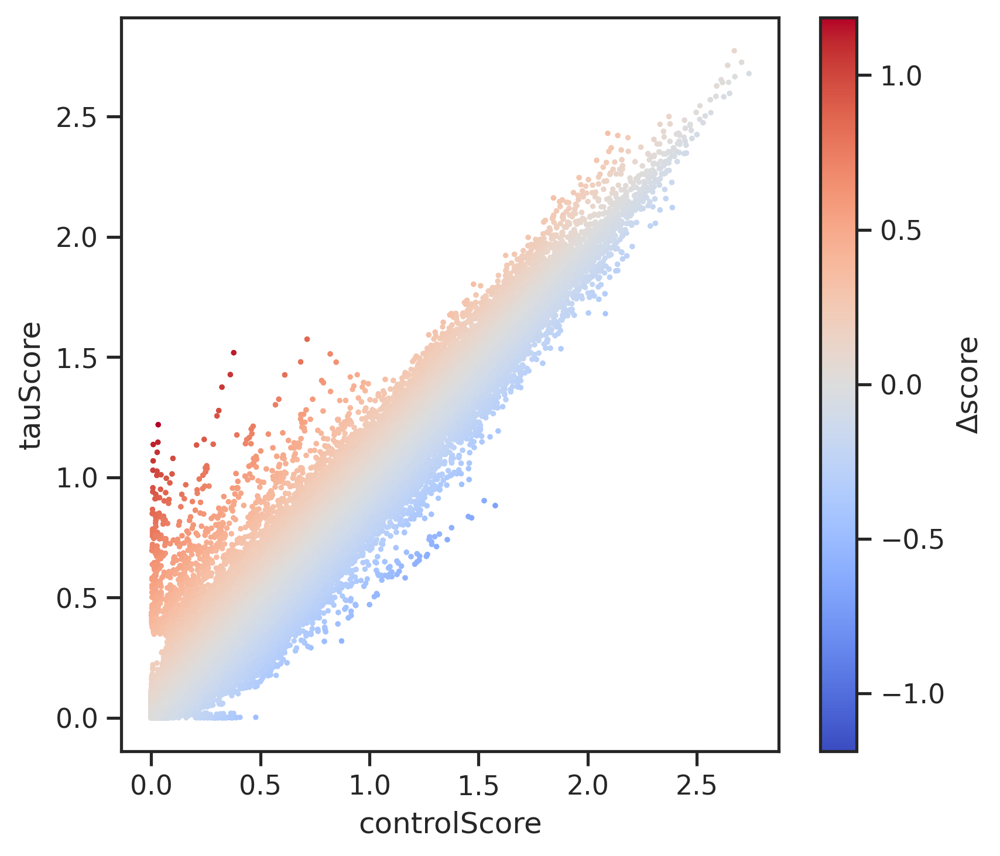

In [80]:
# norm = plt.Normalize(delta_DEG_Df_e05.tauScore.min(), delta_DEG_Df_e05.tauScore.max())
# norm = plt.Normalize(delta_DEG_Df_e05.deltaScore.min(), delta_DEG_Df_e05.deltaScore.max())
norm = plt.Normalize(-delta_DEG_Df_e05.deltaScore.max(), delta_DEG_Df_e05.deltaScore.max())
sm = plt.cm.ScalarMappable(cmap="coolwarm", norm=norm)

with rc_context({'figure.figsize': (6, 5.5)}):
    ax=sns.scatterplot(data=delta_DEG_Df_e05, x='controlScore', y='tauScore', hue = 'deltaScore', palette="coolwarm", s=5, edgecolor = 'none', hue_norm=(-delta_DEG_Df_e05.deltaScore.max(), delta_DEG_Df_e05.deltaScore.max()) ) # size='abs_deltaScore', 
    plt.legend(bbox_to_anchor=(1.1, 1.0))

    ax.get_legend().remove()
    ax.figure.colorbar(sm, ax=ax, label="Δscore")
    plt.savefig(f'{figure6PicFolder}/delatScore_tau_vs_control_small.pdf', bbox_inches='tight')
    plt.show()

# ax.

# # Plot colorbar 
# plt.colorbar(label="Δscore") 

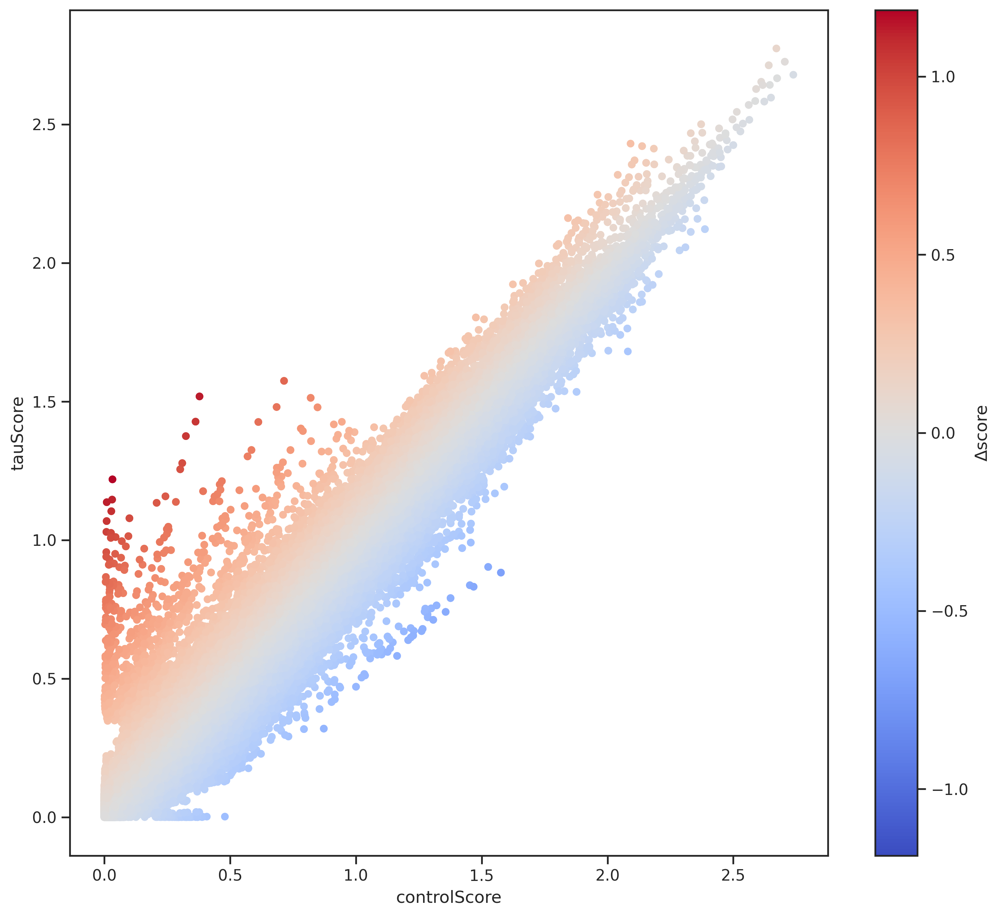

In [81]:
# norm = plt.Normalize(delta_DEG_Df_e05.tauScore.min(), delta_DEG_Df_e05.tauScore.max())
# norm = plt.Normalize(delta_DEG_Df_e05.deltaScore.min(), delta_DEG_Df_e05.deltaScore.max())
norm = plt.Normalize(-delta_DEG_Df_e05.deltaScore.max(), delta_DEG_Df_e05.deltaScore.max())
sm = plt.cm.ScalarMappable(cmap="coolwarm", norm=norm)

with rc_context({'figure.figsize': (12, 11)}):
    ax=sns.scatterplot(data=delta_DEG_Df_e05, x='controlScore', y='tauScore', hue = 'deltaScore', palette="coolwarm", s=30, edgecolor = 'none', hue_norm=(-delta_DEG_Df_e05.deltaScore.max(), delta_DEG_Df_e05.deltaScore.max()) ) # size='abs_deltaScore', 
    plt.legend(bbox_to_anchor=(1.1, 1.0))

    ax.get_legend().remove()
    ax.figure.colorbar(sm, ax=ax, label="Δscore")
    plt.savefig(f'{figure6PicFolder}/delatScore_tau_vs_control.pdf', bbox_inches='tight')
    plt.show()

# ax.

# # Plot colorbar 
# plt.colorbar(label="Δscore") 

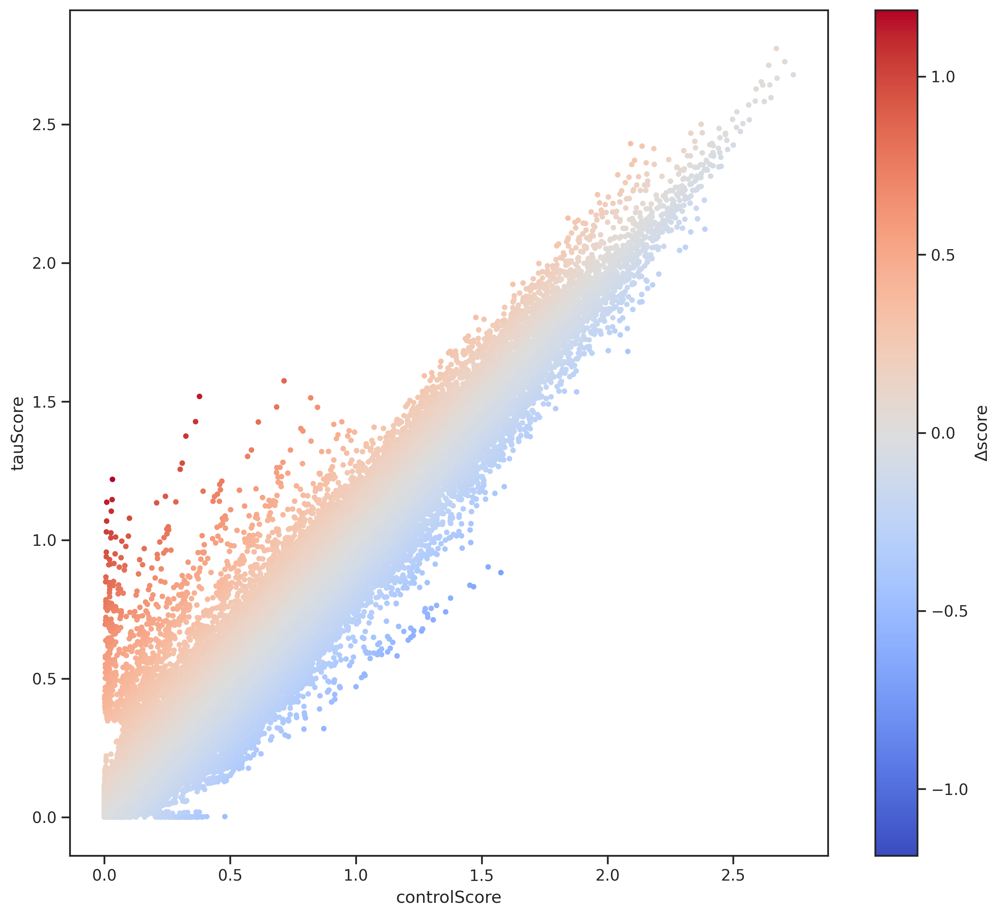

In [82]:
# norm = plt.Normalize(delta_DEG_Df_e05.tauScore.min(), delta_DEG_Df_e05.tauScore.max())
# norm = plt.Normalize(delta_DEG_Df_e05.deltaScore.min(), delta_DEG_Df_e05.deltaScore.max())
norm = plt.Normalize(-delta_DEG_Df_e05.deltaScore.max(), delta_DEG_Df_e05.deltaScore.max())
sm = plt.cm.ScalarMappable(cmap="coolwarm", norm=norm)

with rc_context({'figure.figsize': (12, 11)}):
    ax=sns.scatterplot(data=delta_DEG_Df_e05, x='controlScore', y='tauScore', hue = 'deltaScore', palette="coolwarm", s=15, edgecolor = 'none', hue_norm=(-delta_DEG_Df_e05.deltaScore.max(), delta_DEG_Df_e05.deltaScore.max()) ) # size='abs_deltaScore', 
    plt.legend(bbox_to_anchor=(1.1, 1.0))

    ax.get_legend().remove()
    ax.figure.colorbar(sm, ax=ax, label="Δscore")
    plt.savefig(f'{figure6PicFolder}/delatScore_tau_vs_control.png', bbox_inches='tight', format='png')
    plt.show()

# ax.

# # Plot colorbar 
# plt.colorbar(label="Δscore") 

Text(0.02, 0.95, 'r=0.98, p=0')

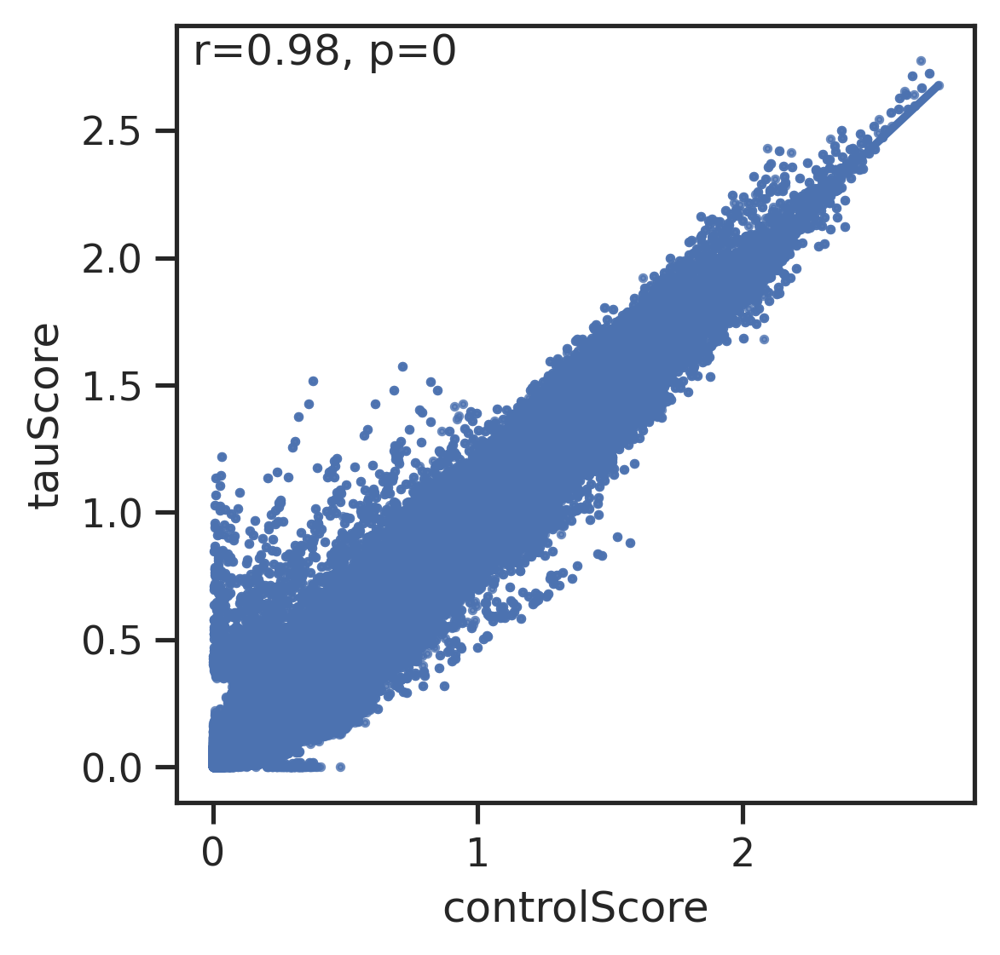

In [83]:
norm = plt.Normalize(delta_DEG_Df_e05.deltaScore.min(), delta_DEG_Df_e05.deltaScore.max())
sm = plt.cm.ScalarMappable(cmap="coolwarm", norm=norm)

ax = sns.regplot(data=delta_DEG_Df_e05, x='controlScore', y='tauScore', scatter_kws={'s': 3}) # color = 'deltaScore', palette="coolwarm",  edgecolor = 'none'

r, p = stats.pearsonr(delta_DEG_Df_e05["controlScore"], delta_DEG_Df_e05['tauScore'])
ax.text(.02, .95, f'r={r:.2f}, p={p:.2g}', transform=ax.transAxes) #  


### ligand_logFC/receptor_logFC vs deltaScore

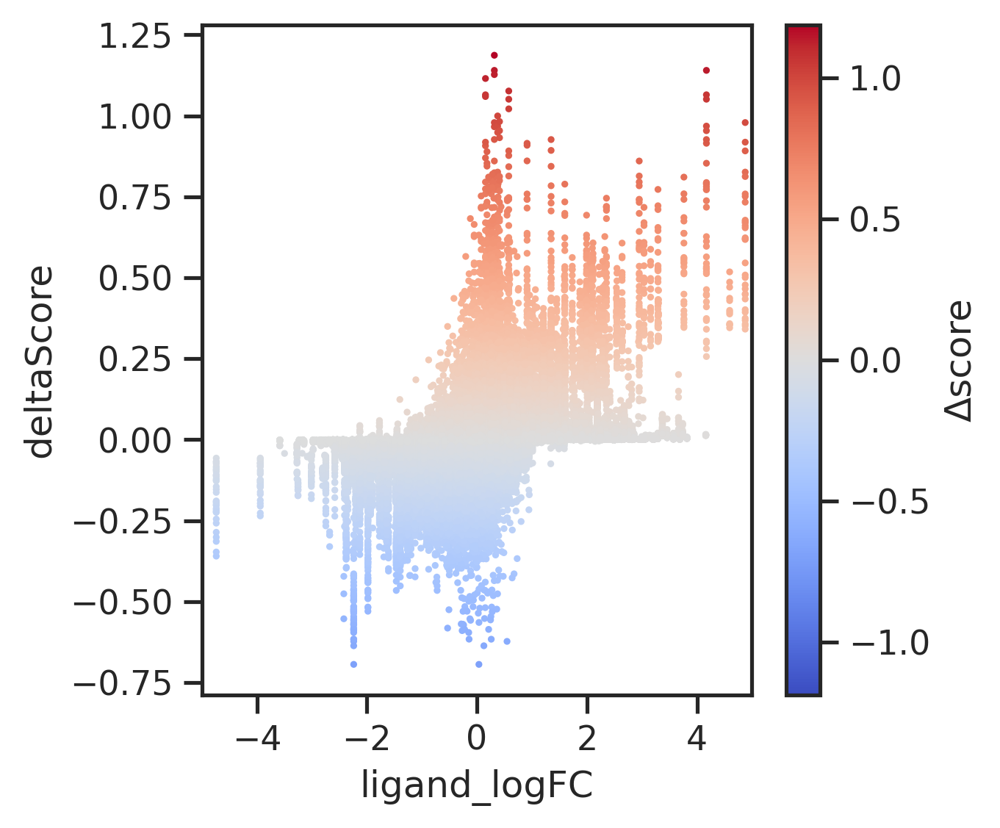

In [84]:
# norm = plt.Normalize(delta_DEG_Df_e05.tauScore.min(), delta_DEG_Df_e05.tauScore.max())
# norm = plt.Normalize(delta_DEG_Df_e05['deltaScore'].min(), delta_DEG_Df_e05['deltaScore'].max())
norm = plt.Normalize(-delta_DEG_Df_e05.deltaScore.max(), delta_DEG_Df_e05.deltaScore.max())
sm = plt.cm.ScalarMappable(cmap="coolwarm", norm=norm)

ax=sns.scatterplot(data=delta_DEG_Df_e05, x='ligand_logFC', y='deltaScore', hue = 'deltaScore', palette="coolwarm", 
                   s=5, edgecolor = 'none', hue_norm=(-delta_DEG_Df_e05.deltaScore.max(), delta_DEG_Df_e05.deltaScore.max()) ) # size='abs_deltaScore', 
plt.legend(bbox_to_anchor=(1.1, 1.0))

plt.xlim(-5,5)

ax.get_legend().remove()
ax.figure.colorbar(sm, ax=ax, label="Δscore")
plt.savefig(f'{figure6PicFolder}/ligand_logFC__vs__deltaScore.png', bbox_inches='tight')

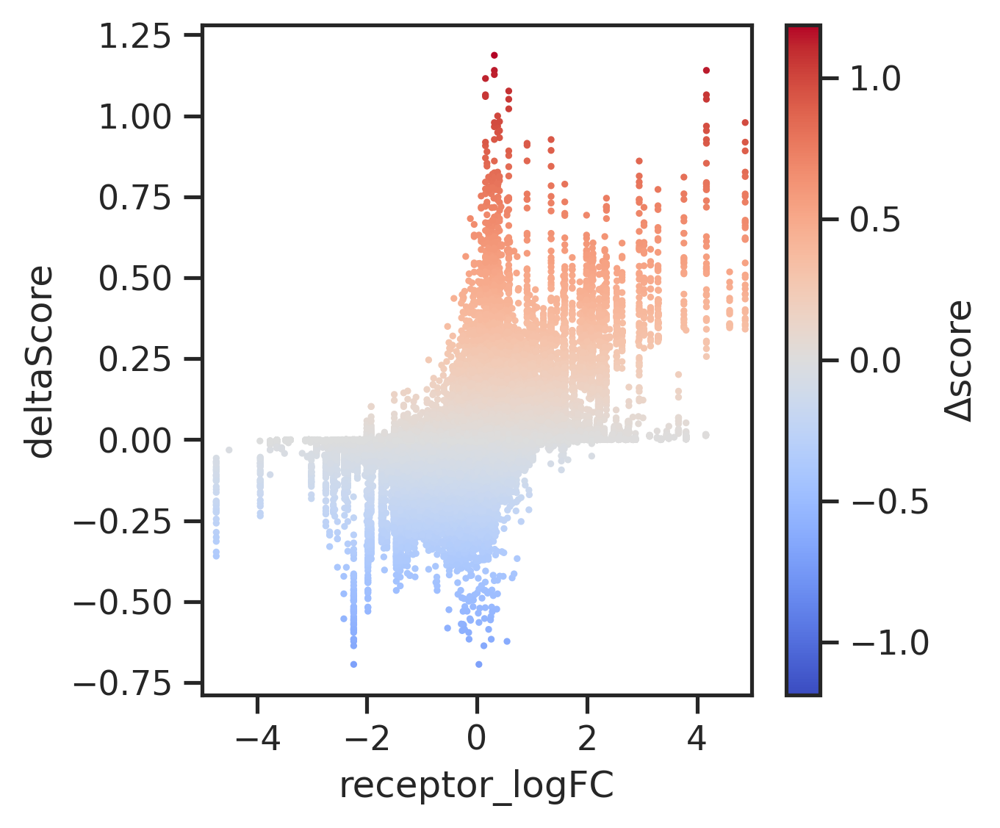

In [85]:
# norm = plt.Normalize(delta_DEG_Df_e05.tauScore.min(), delta_DEG_Df_e05.tauScore.max())
# norm = plt.Normalize(delta_DEG_Df_e05['deltaScore'].min(), delta_DEG_Df_e05['deltaScore'].max())
norm = plt.Normalize(-delta_DEG_Df_e05.deltaScore.max(), delta_DEG_Df_e05.deltaScore.max())
sm = plt.cm.ScalarMappable(cmap="coolwarm", norm=norm)

ax=sns.scatterplot(data=delta_DEG_Df_e05, x='receptor_logFC', y='deltaScore', hue = 'deltaScore', palette="coolwarm", 
                   s=5, edgecolor = 'none', hue_norm=(-delta_DEG_Df_e05.deltaScore.max(), delta_DEG_Df_e05.deltaScore.max()) ) # size='abs_deltaScore', 
plt.legend(bbox_to_anchor=(1.1, 1.0))

plt.xlim(-5,5)

ax.get_legend().remove()
ax.figure.colorbar(sm, ax=ax, label="Δscore")
plt.savefig(f'{figure6PicFolder}/receptor_logFC__vs__deltaScore.png', bbox_inches='tight')

In [86]:
deltaMean = delta_DEG_Df_e05.deltaScore.mean()
deltaStd = delta_DEG_Df_e05.deltaScore.std()

### 3 SD
# upperDelta = deltaMean+3*deltaStd
# lowerDelta = deltaMean-3*deltaStd

### 2SD
upperDelta = deltaMean+2*deltaStd
lowerDelta = deltaMean-2*deltaStd

print(deltaMean, deltaStd, upperDelta, lowerDelta)

0.0017579563915110078 0.07405163569747598 0.14986122778646296 -0.14634531500344097


In [87]:
delta_DEG_Df_e05['Z Score'] = [(deltaScore-deltaMean)/deltaStd for deltaScore in delta_DEG_Df_e05.deltaScore]

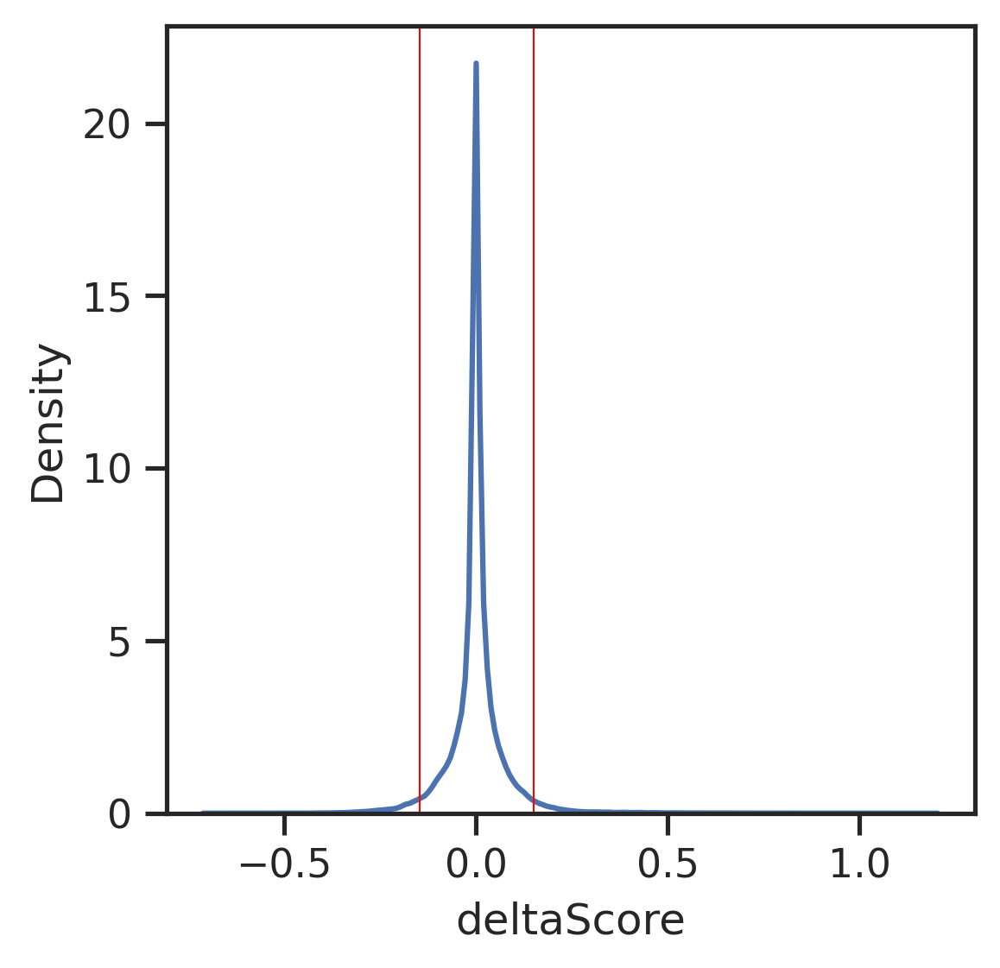

In [88]:
sns.kdeplot(x = "deltaScore", data = delta_DEG_Df_e05)

plt.axvline(upperDelta, color='red', linewidth=0.5)
plt.axvline(lowerDelta, color='red', linewidth=0.5)

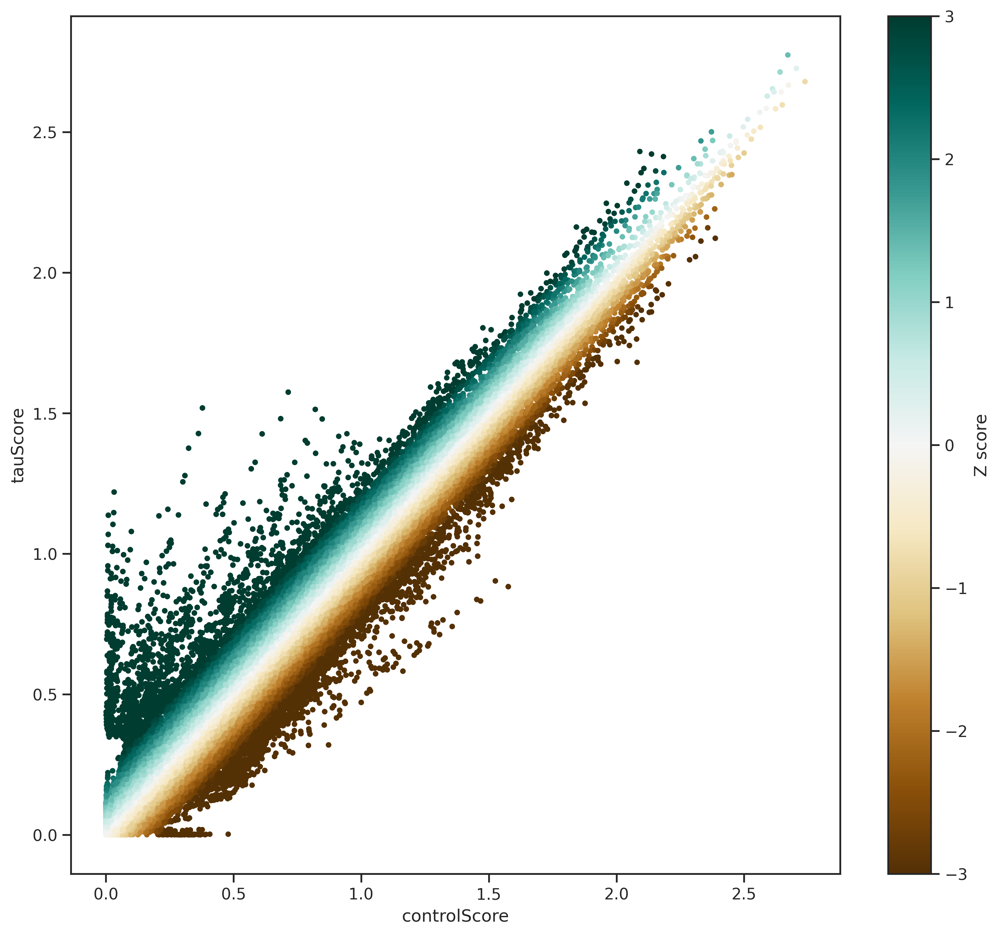

In [89]:
# norm = plt.Normalize(delta_DEG_Df_e05.tauScore.min(), delta_DEG_Df_e05.tauScore.max())
# norm = plt.Normalize(delta_DEG_Df_e05.deltaScore.min(), delta_DEG_Df_e05.deltaScore.max())
# norm = plt.Normalize(-delta_DEG_Df_e05['Z Score'].max(), delta_DEG_Df_e05['Z Score'].max())
norm = plt.Normalize(-3, 3)
sm = plt.cm.ScalarMappable(cmap="BrBG", norm=norm)

with rc_context({'figure.figsize': (12, 11)}):
    ax=sns.scatterplot(data=delta_DEG_Df_e05, x='controlScore', y='tauScore', hue = 'Z Score', palette="BrBG", s=15, edgecolor = 'none', hue_norm=(-3, 3)) # size='abs_deltaScore', 
    plt.legend(bbox_to_anchor=(1.1, 1.0))

    ax.get_legend().remove()
    ax.figure.colorbar(sm, ax=ax, label="Z score")
    plt.savefig(f'{figure6PicFolder}/delatScore_zScore_tau_vs_control.png', bbox_inches='tight', format='png')
    plt.show()

# ax.

# # Plot colorbar 
# plt.colorbar(label="Δscore") 

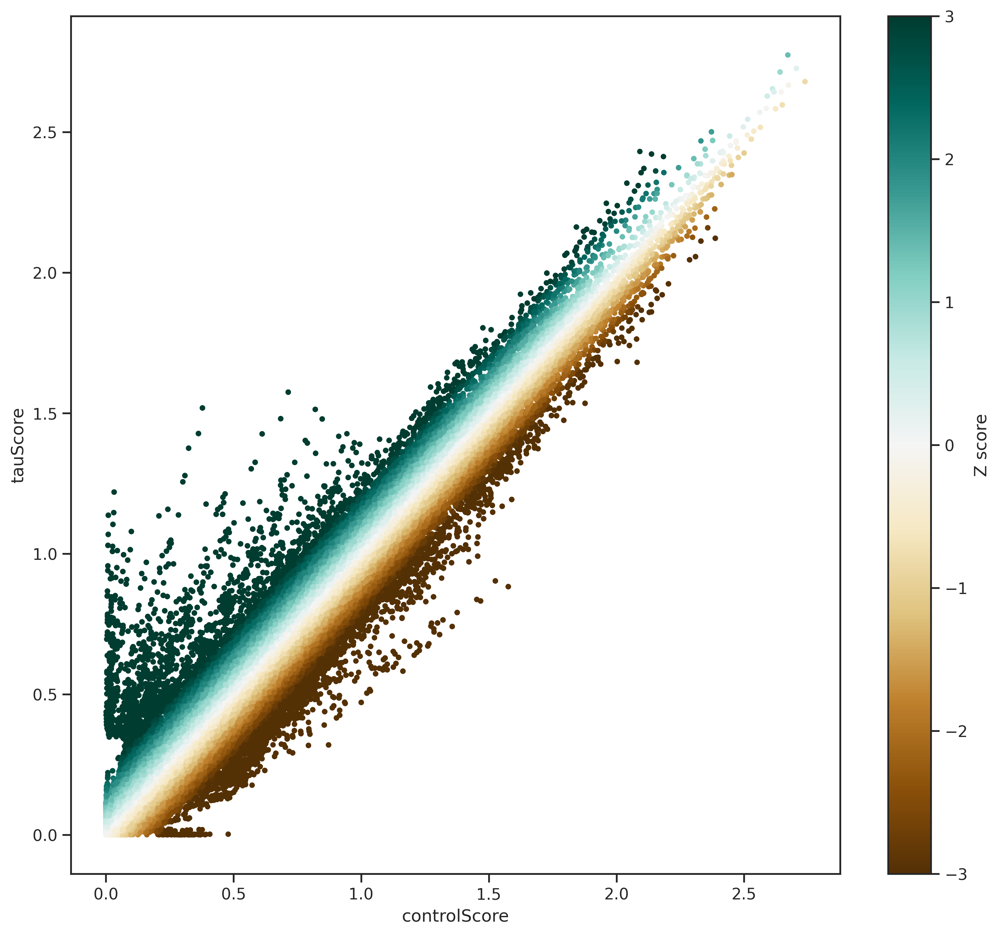

In [90]:
# norm = plt.Normalize(delta_DEG_Df_e05.tauScore.min(), delta_DEG_Df_e05.tauScore.max())
# norm = plt.Normalize(delta_DEG_Df_e05.deltaScore.min(), delta_DEG_Df_e05.deltaScore.max())
# norm = plt.Normalize(-delta_DEG_Df_e05['Z Score'].max(), delta_DEG_Df_e05['Z Score'].max())
norm = plt.Normalize(-3, 3)
sm = plt.cm.ScalarMappable(cmap="BrBG", norm=norm)

with rc_context({'figure.figsize': (12, 11)}):
    ax=sns.scatterplot(data=delta_DEG_Df_e05, x='controlScore', y='tauScore', hue = 'Z Score', palette="BrBG", s=15, edgecolor = 'none', hue_norm=(-3, 3)) # size='abs_deltaScore', 
    plt.legend(bbox_to_anchor=(1.1, 1.0))

    ax.get_legend().remove()
    ax.figure.colorbar(sm, ax=ax, label="Z score")
    plt.savefig(f'{figure6PicFolder}/delatScore_zScore_tau_vs_control.pdf', bbox_inches='tight', format='pdf')
    plt.show()

# ax.

# # Plot colorbar 
# plt.colorbar(label="Δscore") 

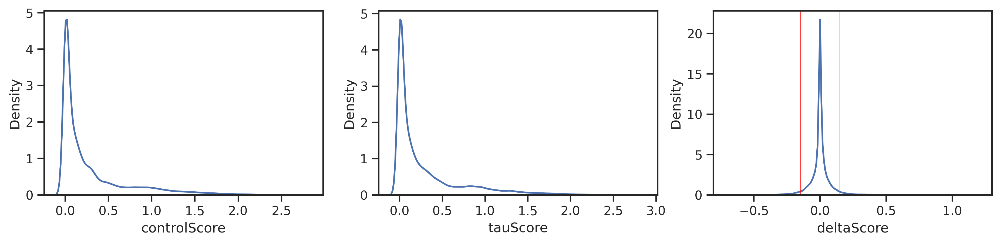

In [91]:
figs, axs = plt.subplots(1, 3, figsize=(15, 3))
sns.kdeplot(x = "controlScore", data = delta_DEG_Df_e05, ax=axs[0])
sns.kdeplot(x = "tauScore", data = delta_DEG_Df_e05, ax=axs[1])
sns.kdeplot(x = "deltaScore", data = delta_DEG_Df_e05, ax=axs[2])

axs[2].axvline(upperDelta, color='red', linewidth=0.5)
axs[2].axvline(lowerDelta, color='red', linewidth=0.5)

plt.savefig(f'{figure6PicFolder}/cccScore_control_tau_deltaScoreWith2SD.pdf', bbox_inches='tight')
plt.show()

In [93]:
# delta_DEG_Df_e05_z3 = delta_DEG_Df_e05[ (delta_DEG_Df_e05.deltaScore >= upperDelta) | (delta_DEG_Df_e05.deltaScore <= lowerDelta) ]
# delta_DEG_Df_e05_z3

delta_DEG_Df_e05_z2 = delta_DEG_Df_e05[ (delta_DEG_Df_e05.deltaScore >= upperDelta) | (delta_DEG_Df_e05.deltaScore <= lowerDelta) ]
delta_DEG_Df_e05_z2

,LR_pair,pathway_GO,Gene_secreted,Gene_receptor,cellTypePair,controlScore,tauScore,deltaScore,controlPvalue,tauPvalue,...,ligand_adj,ligand_logFC,receptor_adj,receptor_logFC,ligand_-log10Padj,receptor_-log10Padj,abs_deltaScore,controlPvalue_-log10,tauPvalue_-log10,Z Score
30,Sdc>Lar,other|nan,Sdc,Lar,16-cell germline cyst in germarium region 2a a...,1.244238,1.077359,-0.166878,0.0,0.0,...,0.002772,-0.491862,1.000000e+00,-0.313898,2.557279,-0.000000,0.166878,inf,inf,-2.277281
137,Bsg>Bsg,other|homophilic cell adhesion via plasma memb...,Bsg,Bsg,16-cell germline cyst in germarium region 2a a...,1.511225,1.363050,-0.148175,0.0,0.0,...,0.696155,-0.341356,1.000000e+00,-0.312404,0.157294,-0.000000,0.148175,inf,inf,-2.024708
222,Sdc>Lar,other|nan,Sdc,Lar,16-cell germline cyst in germarium region 2a a...,1.327977,1.153000,-0.174977,0.0,0.0,...,0.002772,-0.491862,1.000000e+00,-0.329973,2.557279,-0.000000,0.174977,inf,inf,-2.386647
240,ed>ed,other|homophilic cell adhesion via plasma memb...,ed,ed,16-cell germline cyst in germarium region 2a a...,0.841821,1.007792,0.165971,0.0,0.0,...,0.773857,-0.372139,1.000000e+00,0.717518,0.111339,-0.000000,0.165971,inf,inf,2.217546
348,rst>rst,other|homophilic cell adhesion via plasma memb...,rst,rst,16-cell germline cyst in germarium region 2a a...,0.918176,0.594688,-0.323488,0.0,0.0,...,1.000000,-0.040845,1.038155e-52,-1.212743,-0.000000,51.983738,0.323488,inf,inf,-4.392149
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
319882,Lar>Sdc,other|nan,Lar,Sdc,transmedullary Y neuron TmY8>transmedullary Y ...,1.018836,0.829631,-0.189205,0.0,0.0,...,1.000000,-0.504876,1.000000e+00,-0.413045,-0.000000,-0.000000,0.189205,inf,inf,-2.578781
319897,Sema1a>PlexA,other|axon guidance,Sema1a,PlexA,transmedullary Y neuron TmY8>transmedullary Y ...,0.609536,0.817987,0.208451,0.0,0.0,...,1.000000,0.602533,1.000000e+00,0.546172,-0.000000,-0.000000,0.208451,inf,inf,2.791204
319913,Lar>Lar,other|homophilic cell adhesion via plasma memb...,Lar,Lar,transmedullary Y neuron TmY8>transmedullary Y ...,0.881810,0.688072,-0.193738,0.0,0.0,...,1.000000,-0.504876,1.000000e+00,-0.504876,-0.000000,-0.000000,0.193738,inf,inf,-2.640000
319921,Lar>Sdc,other|nan,Lar,Sdc,transmedullary Y neuron TmY8>transmedullary Y ...,1.007469,0.793960,-0.213509,0.0,0.0,...,1.000000,-0.504876,1.000000e+00,-0.556892,-0.000000,-0.000000,0.213509,inf,inf,-2.906986


In [94]:
# delta_DEG_Df_e05_z3_Neu = delta_DEG_Df_e05_z3[ (delta_DEG_Df_e05_z3.ligand_celltype.isin(neuronCellType_L) ) & (~delta_DEG_Df_e05_z3.receptor_celltype.isin(neuronCellType_L) ) ]
# delta_DEG_Df_e05_z3_Neu

delta_DEG_Df_e05_z2_Neu = delta_DEG_Df_e05_z2[ (delta_DEG_Df_e05_z2.ligand_celltype.isin(neuronCellType_L) ) & (~delta_DEG_Df_e05_z2.receptor_celltype.isin(neuronCellType_L) ) ] # neu to peri
delta_DEG_Df_e05_z2_Neu

,LR_pair,pathway_GO,Gene_secreted,Gene_receptor,cellTypePair,controlScore,tauScore,deltaScore,controlPvalue,tauPvalue,...,ligand_adj,ligand_logFC,receptor_adj,receptor_logFC,ligand_-log10Padj,receptor_-log10Padj,abs_deltaScore,controlPvalue_-log10,tauPvalue_-log10,Z Score
1746,Lar>Sdc,other|nan,Lar,Sdc,ABeta42-specific cluster>16-cell germline cyst...,1.244238,1.077359,-0.166878,0.000,0.000,...,1.000000,-0.313898,2.771539e-03,-0.491862,-0.00000,2.557279,0.166878,inf,inf,-2.277281
1811,Pvf3>Pvr,PVR RTK signaling pathway|nan,Pvf3,Pvr,ABeta42-specific cluster>adult alary muscle,0.368812,0.214292,-0.154520,0.000,0.000,...,1.000000,-0.486132,2.191457e-01,-0.893897,-0.00000,0.659267,0.154520,inf,inf,-2.110395
1836,CadN2>CadN2,other|homophilic cell adhesion via plasma memb...,CadN2,CadN2,ABeta42-specific cluster>adult alary muscle,0.044561,0.759595,0.715034,0.919,0.000,...,0.041746,0.912425,2.117135e-26,5.154333,1.37939,25.674251,0.715034,0.036684,inf,9.632148
1877,CadN2>CadN2,other|homophilic cell adhesion via plasma memb...,CadN2,CadN2,ABeta42-specific cluster>adult brain cell body...,0.051108,0.412933,0.361826,0.808,0.000,...,0.041746,0.912425,2.353856e-16,3.293863,1.37939,15.628220,0.361826,0.092589,inf,4.862387
1882,Fas1>Fas1,other|homophilic cell adhesion via plasma memb...,Fas1,Fas1,ABeta42-specific cluster>adult brain cell body...,1.881495,1.654231,-0.227264,0.000,0.000,...,1.000000,-0.429578,2.348294e-31,-0.580200,-0.00000,30.629247,0.227264,inf,inf,-3.092729
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
319201,Bsg>Bsg,other|homophilic cell adhesion via plasma memb...,Bsg,Bsg,transmedullary Y neuron TmY8>perineurial glial...,1.499367,1.291545,-0.207823,0.000,0.012,...,1.000000,-0.311011,6.757169e-04,-0.671328,-0.00000,3.170235,0.207823,inf,1.920819,-2.830194
319270,CadN>CadN,other|homophilic cell adhesion via plasma memb...,CadN,CadN,transmedullary Y neuron TmY8>pigment cell,0.696135,0.493230,-0.202905,0.000,0.007,...,1.000000,-0.148122,2.440070e-02,-0.796769,-0.00000,1.612598,0.202905,inf,2.154902,-2.763787
319339,Dscam2>Dscam2,other|homophilic cell adhesion via plasma memb...,Dscam2,Dscam2,transmedullary Y neuron TmY8>skeletal muscle o...,0.721326,0.538122,-0.183203,0.000,0.000,...,1.000000,-0.107001,4.660556e-02,-0.623726,-0.00000,1.331562,0.183203,inf,inf,-2.497735
319367,Sema1a>PlexA,other|axon guidance,Sema1a,PlexA,transmedullary Y neuron TmY8>subperineurial gl...,0.489553,0.677717,0.188164,0.000,0.000,...,1.000000,0.602533,1.000000e+00,0.550324,-0.00000,-0.000000,0.188164,inf,inf,2.517238


In [95]:
# delta_DEG_Df_e05_z3_Peri = delta_DEG_Df_e05_z3[~delta_DEG_Df_e05_z3.ligand_celltype.isin(neuronCellType_L)]
# delta_DEG_Df_e05_z3_Peri

delta_DEG_Df_e05_z2_Peri = delta_DEG_Df_e05_z2[~delta_DEG_Df_e05_z2.ligand_celltype.isin(neuronCellType_L)]
delta_DEG_Df_e05_z2_Peri

,LR_pair,pathway_GO,Gene_secreted,Gene_receptor,cellTypePair,controlScore,tauScore,deltaScore,controlPvalue,tauPvalue,...,ligand_adj,ligand_logFC,receptor_adj,receptor_logFC,ligand_-log10Padj,receptor_-log10Padj,abs_deltaScore,controlPvalue_-log10,tauPvalue_-log10,Z Score
30,Sdc>Lar,other|nan,Sdc,Lar,16-cell germline cyst in germarium region 2a a...,1.244238,1.077359,-0.166878,0.0,0.0,...,0.002772,-0.491862,1.000000e+00,-0.313898,2.557279,-0.000000,0.166878,inf,inf,-2.277281
137,Bsg>Bsg,other|homophilic cell adhesion via plasma memb...,Bsg,Bsg,16-cell germline cyst in germarium region 2a a...,1.511225,1.363050,-0.148175,0.0,0.0,...,0.696155,-0.341356,1.000000e+00,-0.312404,0.157294,-0.000000,0.148175,inf,inf,-2.024708
222,Sdc>Lar,other|nan,Sdc,Lar,16-cell germline cyst in germarium region 2a a...,1.327977,1.153000,-0.174977,0.0,0.0,...,0.002772,-0.491862,1.000000e+00,-0.329973,2.557279,-0.000000,0.174977,inf,inf,-2.386647
240,ed>ed,other|homophilic cell adhesion via plasma memb...,ed,ed,16-cell germline cyst in germarium region 2a a...,0.841821,1.007792,0.165971,0.0,0.0,...,0.773857,-0.372139,1.000000e+00,0.717518,0.111339,-0.000000,0.165971,inf,inf,2.217546
348,rst>rst,other|homophilic cell adhesion via plasma memb...,rst,rst,16-cell germline cyst in germarium region 2a a...,0.918176,0.594688,-0.323488,0.0,0.0,...,1.000000,-0.040845,1.038155e-52,-1.212743,-0.000000,51.983738,0.323488,inf,inf,-4.392149
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
265473,Fas1>Fas1,other|homophilic cell adhesion via plasma memb...,Fas1,Fas1,subperineurial glial cell_head>transmedullary ...,1.546943,1.705700,0.158757,0.0,0.0,...,0.778244,0.334970,1.000000e+00,0.362234,0.108884,-0.000000,0.158757,inf,inf,2.120123
265496,Wnt6>fz2,WNT signaling pathway|nan,Wnt6,fz2,subperineurial glial cell_head>transmedullary ...,0.171572,0.328218,0.156646,0.0,0.0,...,1.000000,0.936174,1.000000e+00,0.652650,-0.000000,-0.000000,0.156646,inf,inf,2.091616
265521,CadN>CadN,other|homophilic cell adhesion via plasma memb...,CadN,CadN,subperineurial glial cell_head>transmedullary ...,0.761986,0.976277,0.214291,0.0,0.0,...,0.093529,0.861924,1.000000e+00,-0.141709,1.029053,-0.000000,0.214291,inf,inf,2.870064
265583,CadN>CadN,other|homophilic cell adhesion via plasma memb...,CadN,CadN,subperineurial glial cell_head>transmedullary ...,0.524643,0.771034,0.246391,0.0,0.0,...,0.093529,0.861924,1.000000e+00,0.490619,1.029053,-0.000000,0.246391,inf,inf,3.303553


In [96]:
delta_DEG_Df_e05_z2_Neu.LR_pair.value_counts()[:20]

CadN2>CadN2      952
Lar>Sdc          477
Bsg>Bsg          333
kirre>kirre      316
CadN>CadN        312
Dscam2>Dscam2    289
Pvf3>Pvr         278
Sema1a>PlexA     254
Fas1>Fas1        253
Actbeta>tkv      230
Lar>Lar          201
caps>caps        159
Fas2>Fas2        128
tutl>tutl        126
wry>N            122
Fas3>Fas3        117
Con>Con          114
ed>ed            113
Sema1a>otk        97
sns>kirre         90
Name: LR_pair, dtype: int64

In [97]:
delta_DEG_Df_e05_z2_Peri.LR_pair.value_counts()[:20]

CadN2>CadN2        952
Sdc>Lar            479
Bsg>Bsg            333
kirre>kirre        316
CadN>CadN          310
Dscam2>Dscam2      289
Fas1>Fas1          254
Lar>Lar            201
caps>caps          159
Fas2>Fas2          128
tutl>tutl          127
Fas3>Fas3          116
Con>Con            114
ed>ed              113
kirre>sns           90
Cals>Cals           86
Sema5c>PlexA        84
CG34353>CG34353     82
Sema1a>PlexA        77
myo>babo            76
Name: LR_pair, dtype: int64

## Output numbers of differential CCCs

In [98]:
delta_DEG_Df_e05.to_csv(f'{figure6Folder}/delta_DEG_Df_e05_zscore.csv', index=False)
delta_DEG_Df_e05_z2.to_csv(f'{figure6Folder}/delta_DEG_Df_e05_z2.csv', index=False)
delta_DEG_Df_e05_z2_Neu.to_csv(f'{figure6Folder}/delta_DEG_Df_e05_z2_Neu.csv', index=False)
delta_DEG_Df_e05_z2_Peri.to_csv(f'{figure6Folder}/delta_DEG_Df_e05_z2_Peri.csv', index=False)

## Plot LRs with siginificant changes

In [99]:
delta_DEG_Df_e05_z2 = pd.read_csv(f'{figure6Folder}/delta_DEG_Df_e05_z2.csv')
delta_DEG_Df_e05_z2_Neu = pd.read_csv(f'{figure6Folder}/delta_DEG_Df_e05_z2_Neu.csv')
delta_DEG_Df_e05_z2_Peri = pd.read_csv(f'{figure6Folder}/delta_DEG_Df_e05_z2_Peri.csv')
delta_DEG_Df_e05_z2_Neu

,LR_pair,pathway_GO,Gene_secreted,Gene_receptor,cellTypePair,controlScore,tauScore,deltaScore,controlPvalue,tauPvalue,...,ligand_adj,ligand_logFC,receptor_adj,receptor_logFC,ligand_-log10Padj,receptor_-log10Padj,abs_deltaScore,controlPvalue_-log10,tauPvalue_-log10,Z Score
0,Lar>Sdc,other|nan,Lar,Sdc,ABeta42-specific cluster>16-cell germline cyst...,1.244238,1.077359,-0.166878,0.000,0.000,...,1.000000,-0.313898,2.771539e-03,-0.491862,-0.00000,2.557279,0.166878,inf,inf,-2.277281
1,Pvf3>Pvr,PVR RTK signaling pathway|nan,Pvf3,Pvr,ABeta42-specific cluster>adult alary muscle,0.368812,0.214292,-0.154520,0.000,0.000,...,1.000000,-0.486132,2.191457e-01,-0.893897,-0.00000,0.659267,0.154520,inf,inf,-2.110395
2,CadN2>CadN2,other|homophilic cell adhesion via plasma memb...,CadN2,CadN2,ABeta42-specific cluster>adult alary muscle,0.044561,0.759595,0.715034,0.919,0.000,...,0.041746,0.912425,2.117135e-26,5.154333,1.37939,25.674251,0.715034,0.036684,inf,9.632148
3,CadN2>CadN2,other|homophilic cell adhesion via plasma memb...,CadN2,CadN2,ABeta42-specific cluster>adult brain cell body...,0.051108,0.412933,0.361826,0.808,0.000,...,0.041746,0.912425,2.353856e-16,3.293863,1.37939,15.628220,0.361826,0.092589,inf,4.862387
4,Fas1>Fas1,other|homophilic cell adhesion via plasma memb...,Fas1,Fas1,ABeta42-specific cluster>adult brain cell body...,1.881495,1.654231,-0.227264,0.000,0.000,...,1.000000,-0.429578,2.348294e-31,-0.580200,-0.00000,30.629247,0.227264,inf,inf,-3.092729
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5728,Bsg>Bsg,other|homophilic cell adhesion via plasma memb...,Bsg,Bsg,transmedullary Y neuron TmY8>perineurial glial...,1.499367,1.291545,-0.207823,0.000,0.012,...,1.000000,-0.311011,6.757169e-04,-0.671328,-0.00000,3.170235,0.207823,inf,1.920819,-2.830194
5729,CadN>CadN,other|homophilic cell adhesion via plasma memb...,CadN,CadN,transmedullary Y neuron TmY8>pigment cell,0.696135,0.493230,-0.202905,0.000,0.007,...,1.000000,-0.148122,2.440070e-02,-0.796769,-0.00000,1.612598,0.202905,inf,2.154902,-2.763787
5730,Dscam2>Dscam2,other|homophilic cell adhesion via plasma memb...,Dscam2,Dscam2,transmedullary Y neuron TmY8>skeletal muscle o...,0.721326,0.538122,-0.183203,0.000,0.000,...,1.000000,-0.107001,4.660556e-02,-0.623726,-0.00000,1.331562,0.183203,inf,inf,-2.497735
5731,Sema1a>PlexA,other|axon guidance,Sema1a,PlexA,transmedullary Y neuron TmY8>subperineurial gl...,0.489553,0.677717,0.188164,0.000,0.000,...,1.000000,0.602533,1.000000e+00,0.550324,-0.00000,-0.000000,0.188164,inf,inf,2.517238


In [114]:
delta_DEG_Df_e05_z2_Neu.columns

Index(['LR_pair', 'pathway_GO', 'Gene_secreted', 'Gene_receptor',
       'cellTypePair', 'controlScore', 'tauScore', 'deltaScore',
       'controlPvalue', 'tauPvalue', 'ligand_celltype', 'receptor_celltype',
       'ligand_adj', 'ligand_logFC', 'receptor_adj', 'receptor_logFC',
       'ligand_-log10Padj', 'receptor_-log10Padj', 'abs_deltaScore',
       'controlPvalue_-log10', 'tauPvalue_-log10', 'Z Score'],
      dtype='object')

In [115]:
delta_DEG_Df_e05_z2_Neu['changeDirection'] = pd.Categorical(['Increase' if delta > 0 else "Decrease" for delta in delta_DEG_Df_e05_z2_Neu.deltaScore])

In [122]:
list(delta_counts_Df.columns.get_level_values(0))

['Decrease', 'Increase']

In [132]:
delta_counts_Df = delta_DEG_Df_e05_z2_Neu.groupby(['LR_pair', 'changeDirection']).size().unstack('changeDirection')
delta_counts_Df.columns = list(delta_counts_Df.columns.get_level_values(0))
delta_counts_Df.index.name = None
delta_counts_Df['count'] = delta_counts_Df.Decrease + delta_counts_Df.Increase

delta_counts_Df['LR_pair'] = pd.Categorical(delta_counts_Df.index.to_list())
delta_counts_Df['neu>peri'] = 'neu>peri'
delta_counts_Df.sort_values(by='count', ascending=False, inplace=True)

delta_counts_Df

,Decrease,Increase,count,LR_pair,neu>peri
CadN2>CadN2,0,952,952,CadN2>CadN2,neu>peri
Lar>Sdc,472,5,477,Lar>Sdc,neu>peri
Bsg>Bsg,333,0,333,Bsg>Bsg,neu>peri
kirre>kirre,97,219,316,kirre>kirre,neu>peri
CadN>CadN,125,187,312,CadN>CadN,neu>peri
...,...,...,...,...,...
Proc>Proc-R,1,0,1,Proc>Proc-R,neu>peri
Wnt10>arr,1,0,1,Wnt10>arr,neu>peri
Wnt4>fz3,1,0,1,Wnt4>fz3,neu>peri
Crz>CrzR,1,0,1,Crz>CrzR,neu>peri


In [133]:
LR_count_Df_top10 = delta_counts_Df.iloc[:10,:]
LR_count_Df_top10['LR_pair'] = pd.Categorical(LR_count_Df_top10['LR_pair'].to_list(), categories=LR_count_Df_top10['LR_pair'].to_list())
LR_count_Df_top10

/tmp/ipykernel_3188594/1942744704.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  LR_count_Df_top10['LR_pair'] = pd.Categorical(LR_count_Df_top10['LR_pair'].to_list(), categories=LR_count_Df_top10['LR_pair'].to_list())


,Decrease,Increase,count,LR_pair,neu>peri
CadN2>CadN2,0,952,952,CadN2>CadN2,neu>peri
Lar>Sdc,472,5,477,Lar>Sdc,neu>peri
Bsg>Bsg,333,0,333,Bsg>Bsg,neu>peri
kirre>kirre,97,219,316,kirre>kirre,neu>peri
CadN>CadN,125,187,312,CadN>CadN,neu>peri
Dscam2>Dscam2,243,46,289,Dscam2>Dscam2,neu>peri
Pvf3>Pvr,155,123,278,Pvf3>Pvr,neu>peri
Sema1a>PlexA,49,205,254,Sema1a>PlexA,neu>peri
Fas1>Fas1,204,49,253,Fas1>Fas1,neu>peri
Actbeta>tkv,175,55,230,Actbeta>tkv,neu>peri


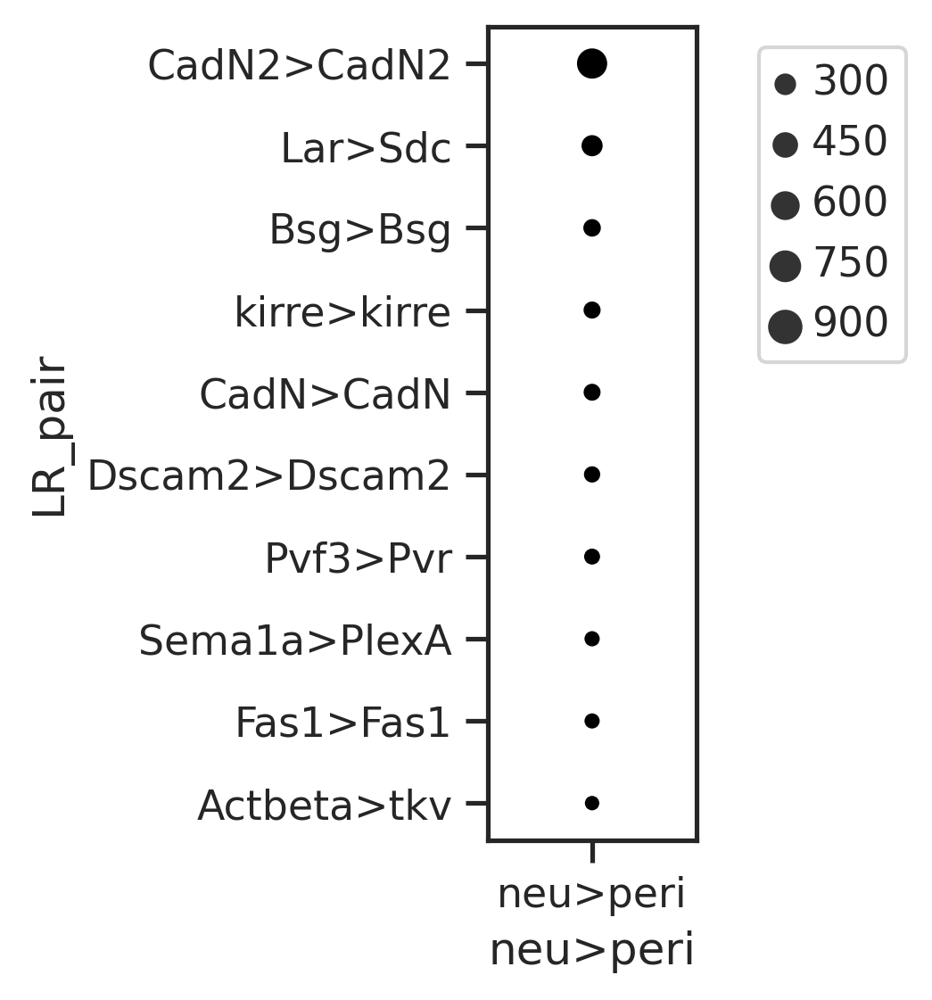

In [134]:
fig, ax = plt.subplots(figsize=(1, 4))
sns.scatterplot(x= 'neu>peri', y='LR_pair', data=LR_count_Df_top10, size='count', ax = ax, color = 'black') # sizes=(300, 900)
plt.legend(bbox_to_anchor=(1.20, 1.00))
plt.savefig(f'{figure6PicFolder}/difCCC_neuToPeri_top10_dotplot.pdf', bbox_inches='tight')

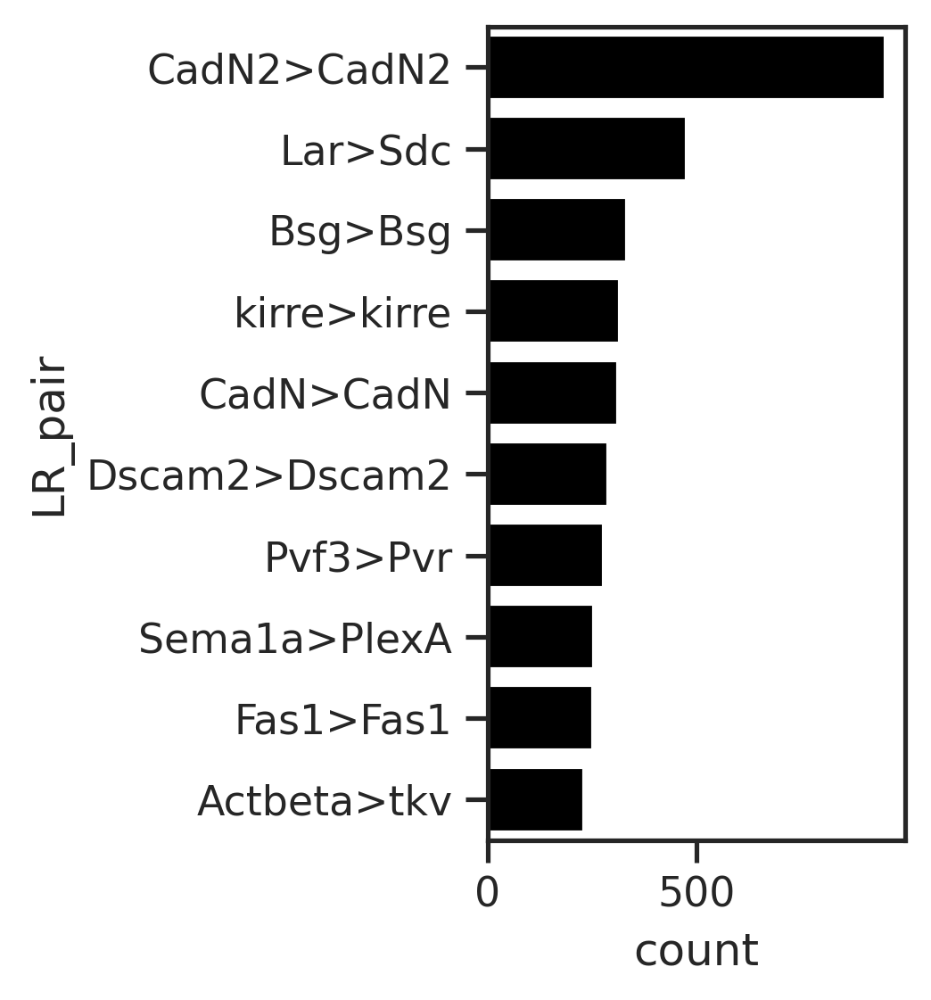

In [135]:
fig, ax = plt.subplots(figsize=(2, 4))
sns.barplot(x= 'count', y='LR_pair', data=LR_count_Df_top10, ax = ax, color = 'black')
# plt.legend(bbox_to_anchor=(1.20, 1.00))
plt.savefig(f'{figure6PicFolder}/difCCC_neuToPeri_top10_barplot.pdf', bbox_inches='tight')

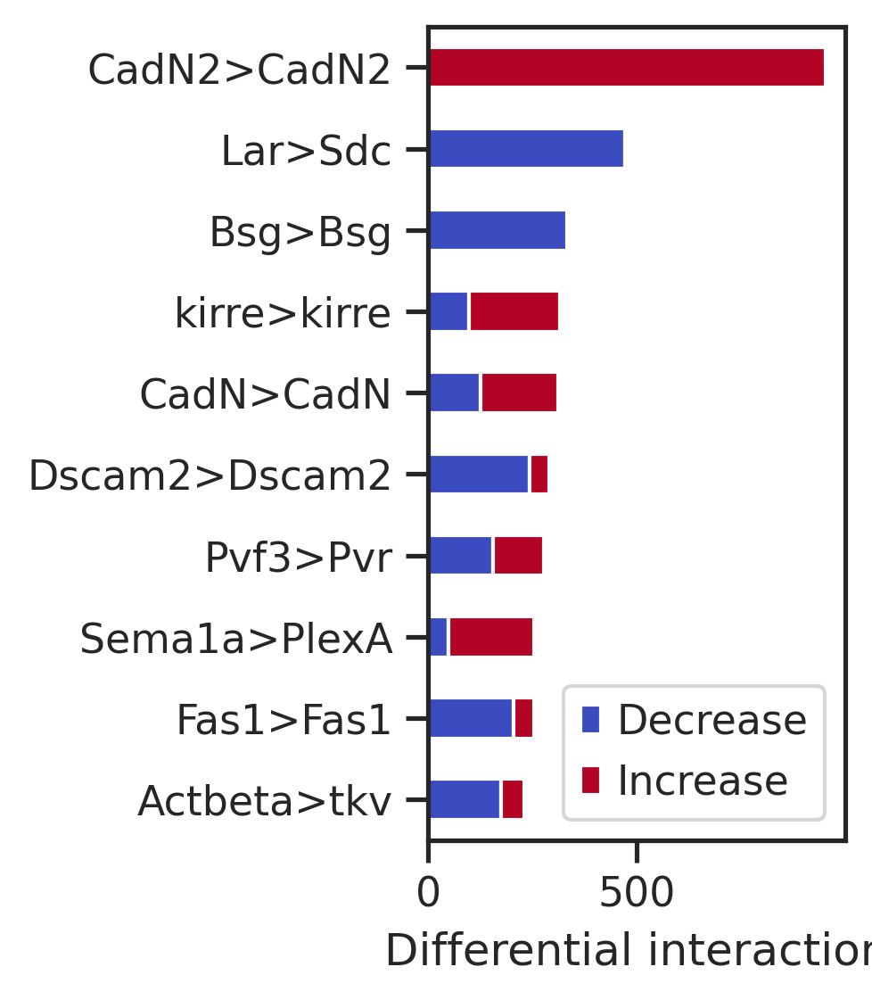

In [149]:
fig, ax = plt.subplots(figsize=(2, 4))
LR_count_Df_top10.iloc[:,[0,1,3]].iloc[::-1,:].plot(x='LR_pair', kind='barh', stacked=True, colormap='coolwarm', mark_right = True, ax=ax)
plt.ylabel('')
plt.xlabel('Differential interaction')
plt.savefig(f'{figure6PicFolder}/difCCC_neuToPeri_top10_barplot_colorDirection.pdf', bbox_inches='tight')

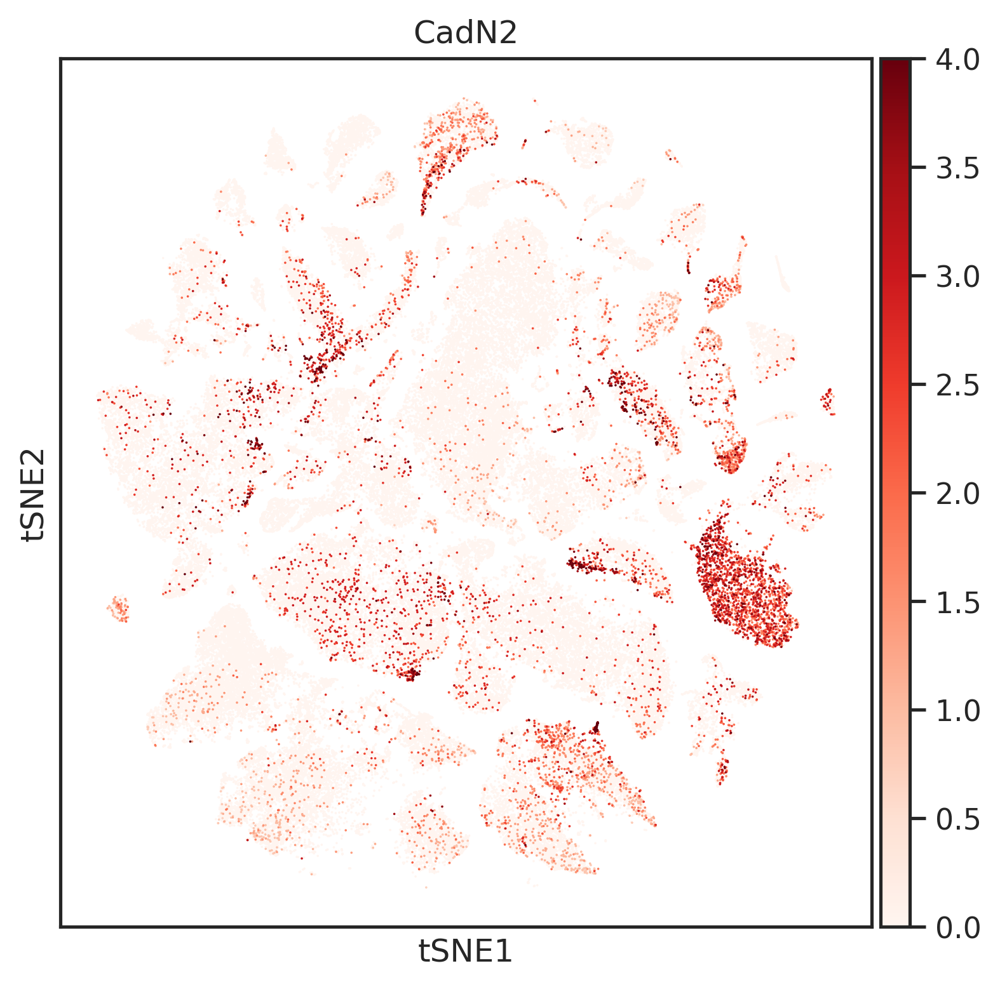

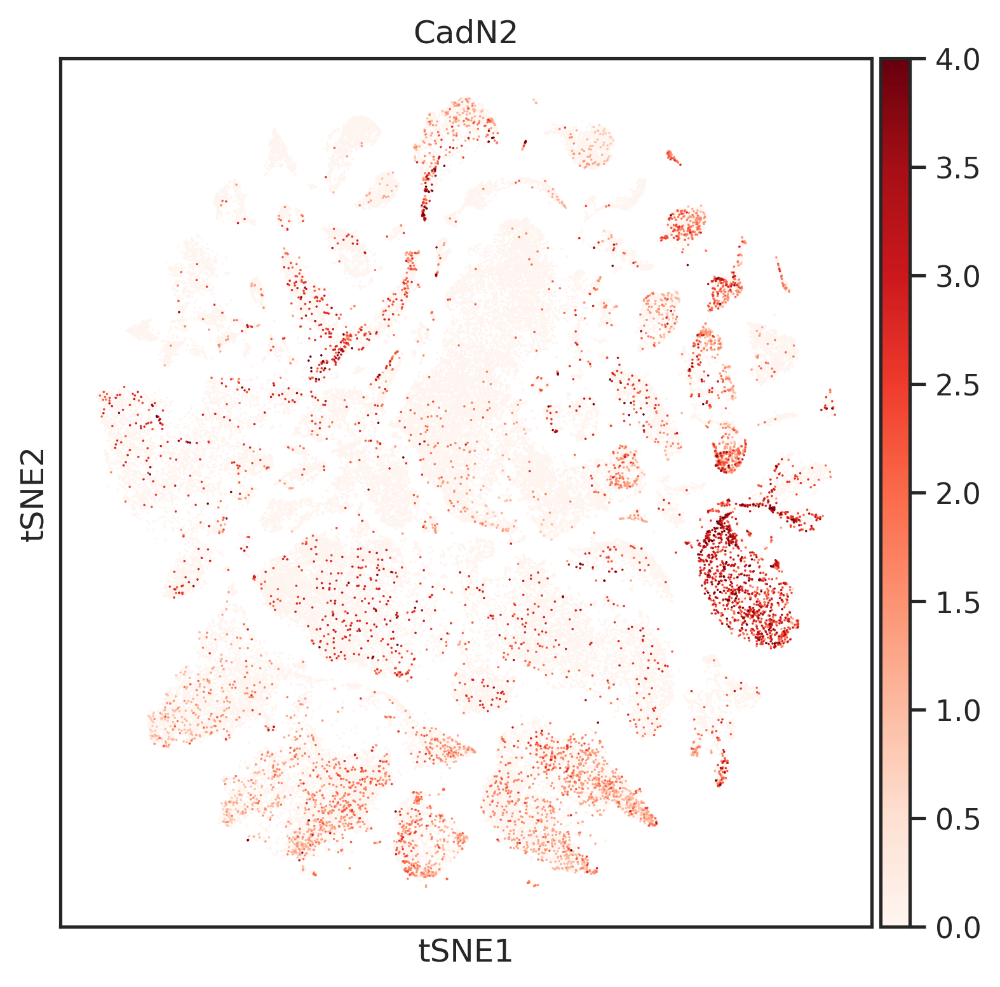

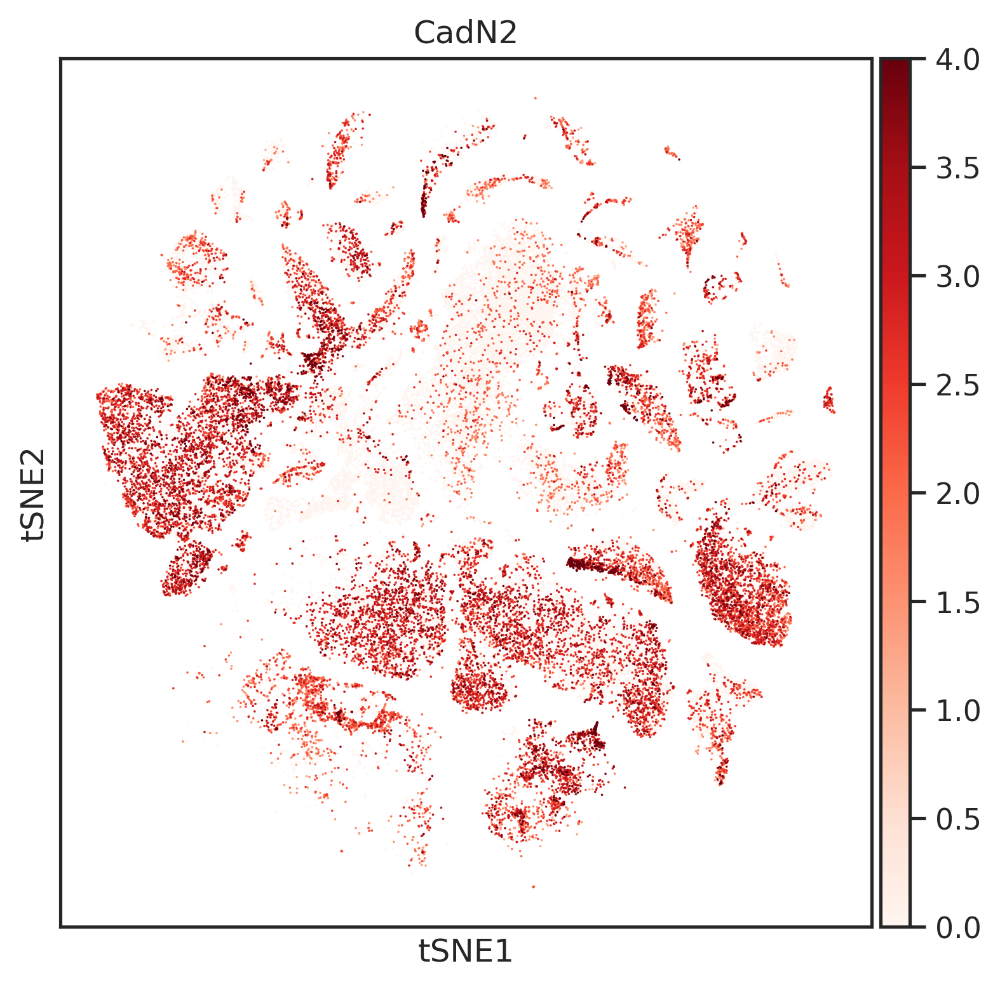

In [123]:
with rc_context({'figure.figsize': (6, 6)}):
    for genotype in genotype_L:
        g=sc.pl.tsne(adata_body[adata_body.obs.genotype == genotype], color='CadN2', cmap='Reds', vmax=4, show=False, frameon=True, size=3)
        plt.savefig(f'{figure6PicFolder}/tsne_CadN2_{genotype}.pdf')

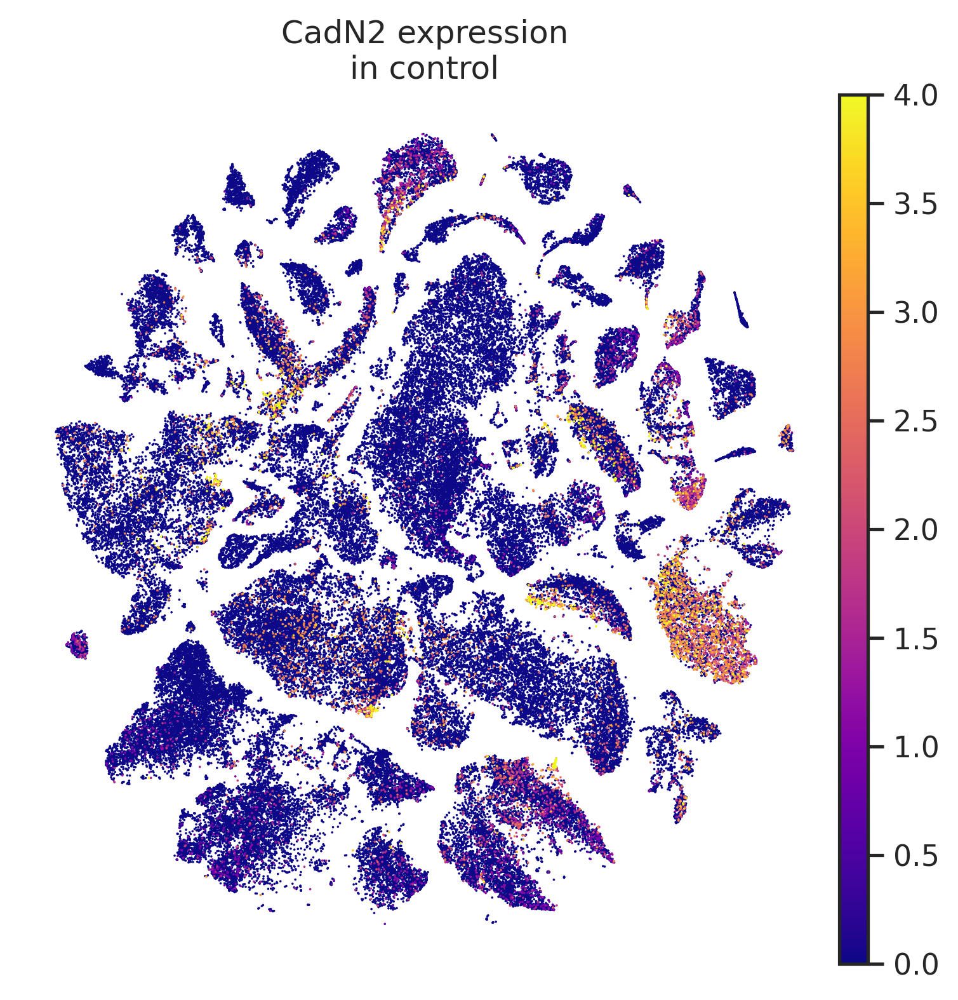

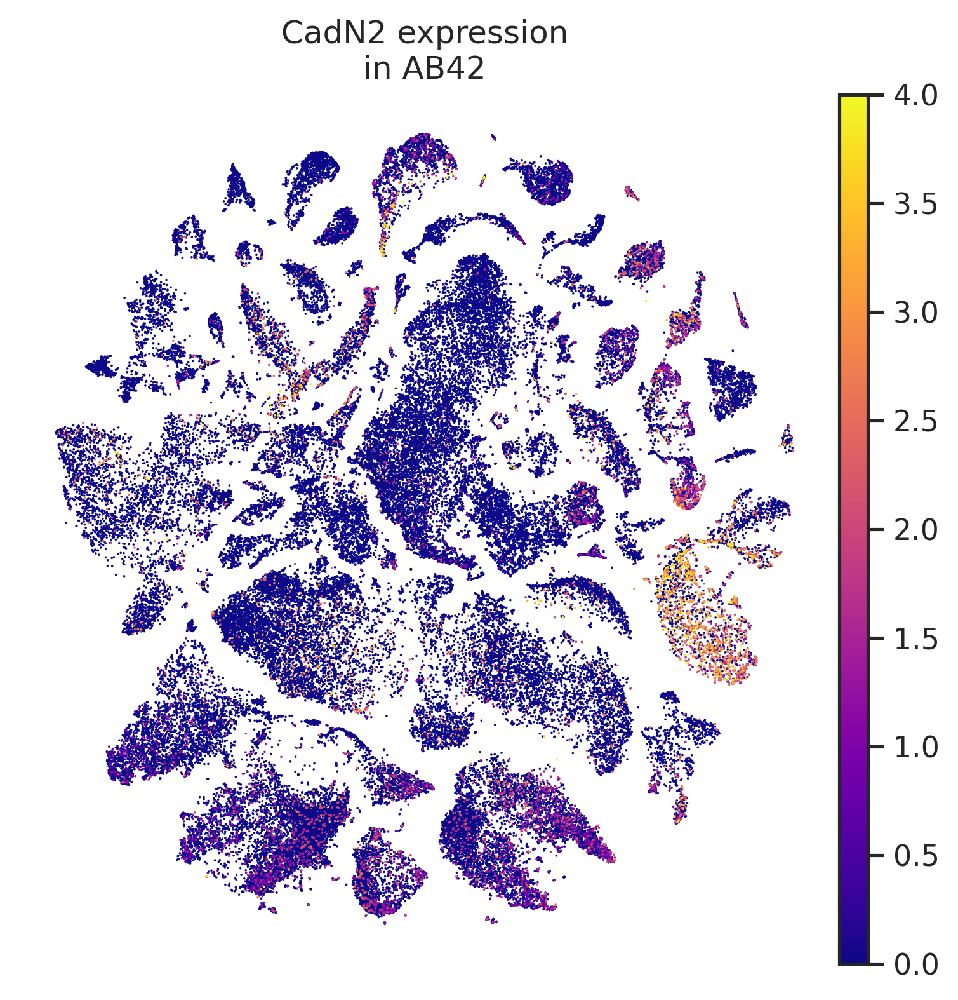

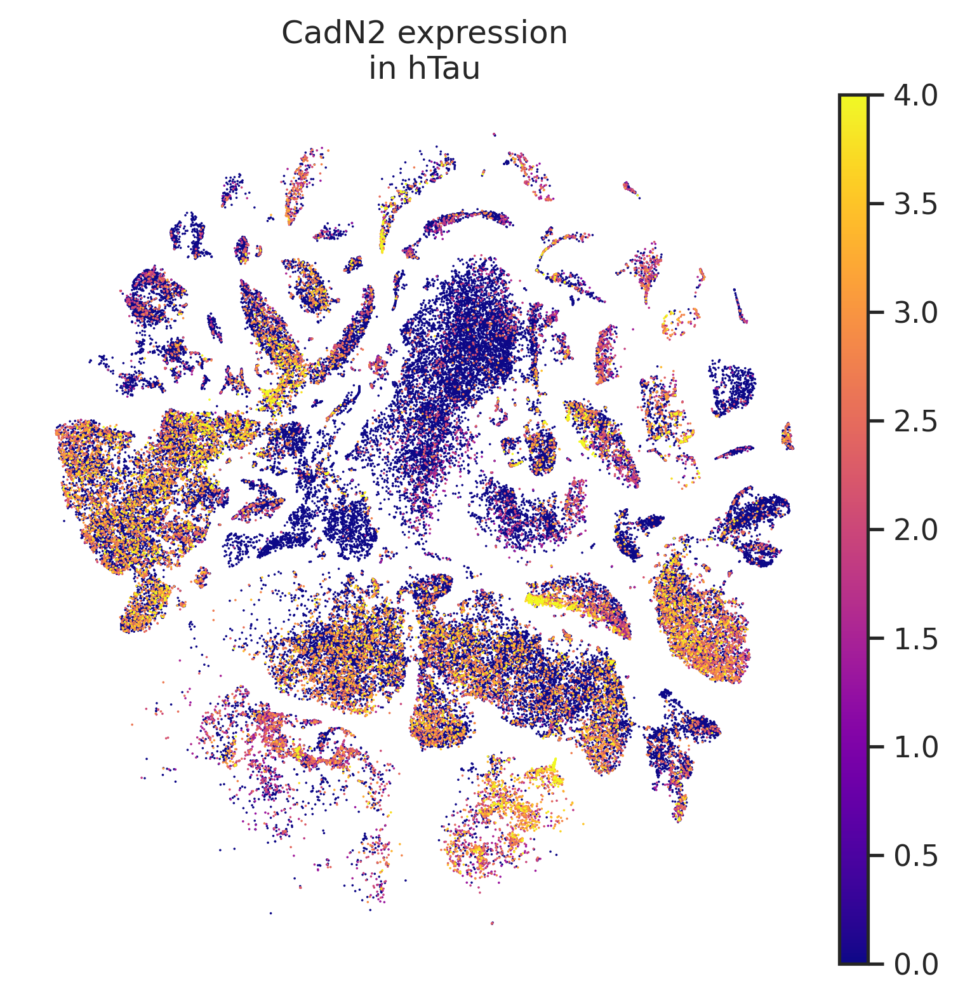

In [121]:
with rc_context({'figure.figsize': (6, 6)}):
    for genotype in genotype_L:
        g=sc.pl.tsne(adata_body[adata_body.obs.genotype == genotype], color='CadN2', cmap='plasma', vmax=4, show=False, frameon=False, title=f'CadN2 expression\nin {genotype}', size=3)
        plt.savefig(f'{figure6PicFolder}/tsne_CadN2_{genotype}_plasma.pdf')

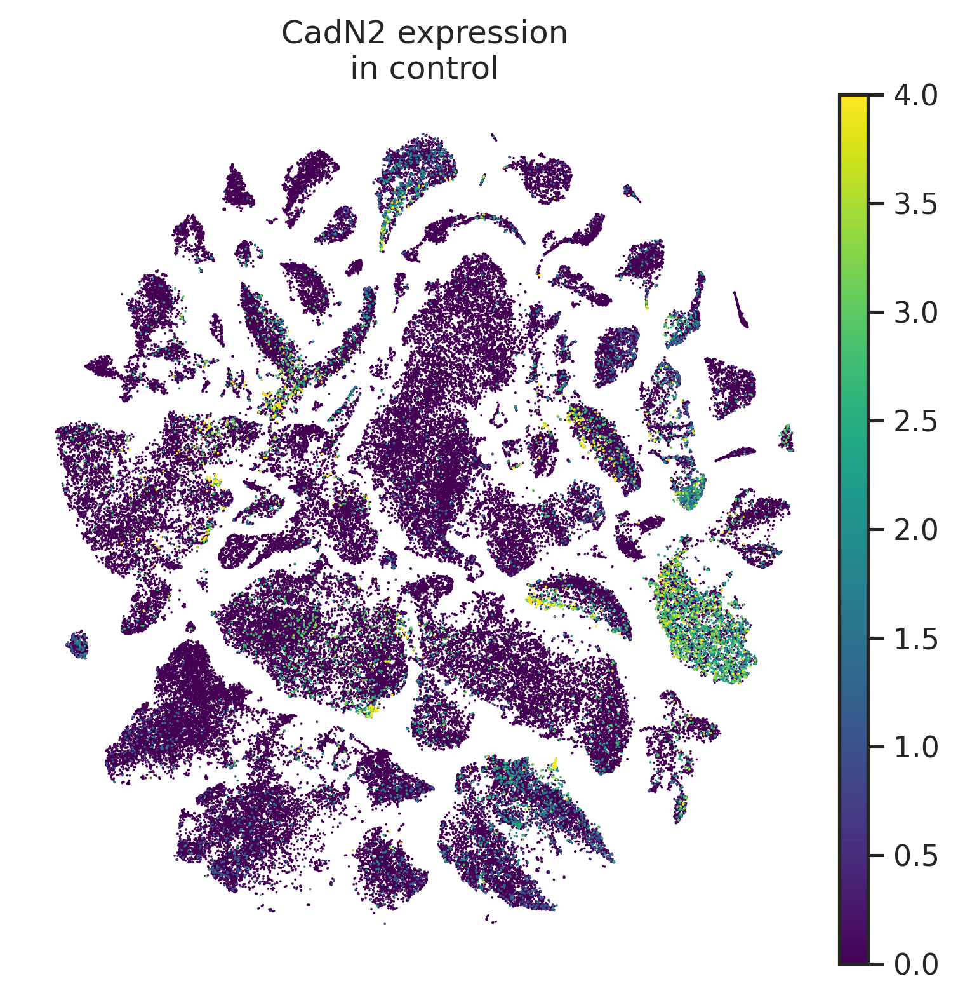

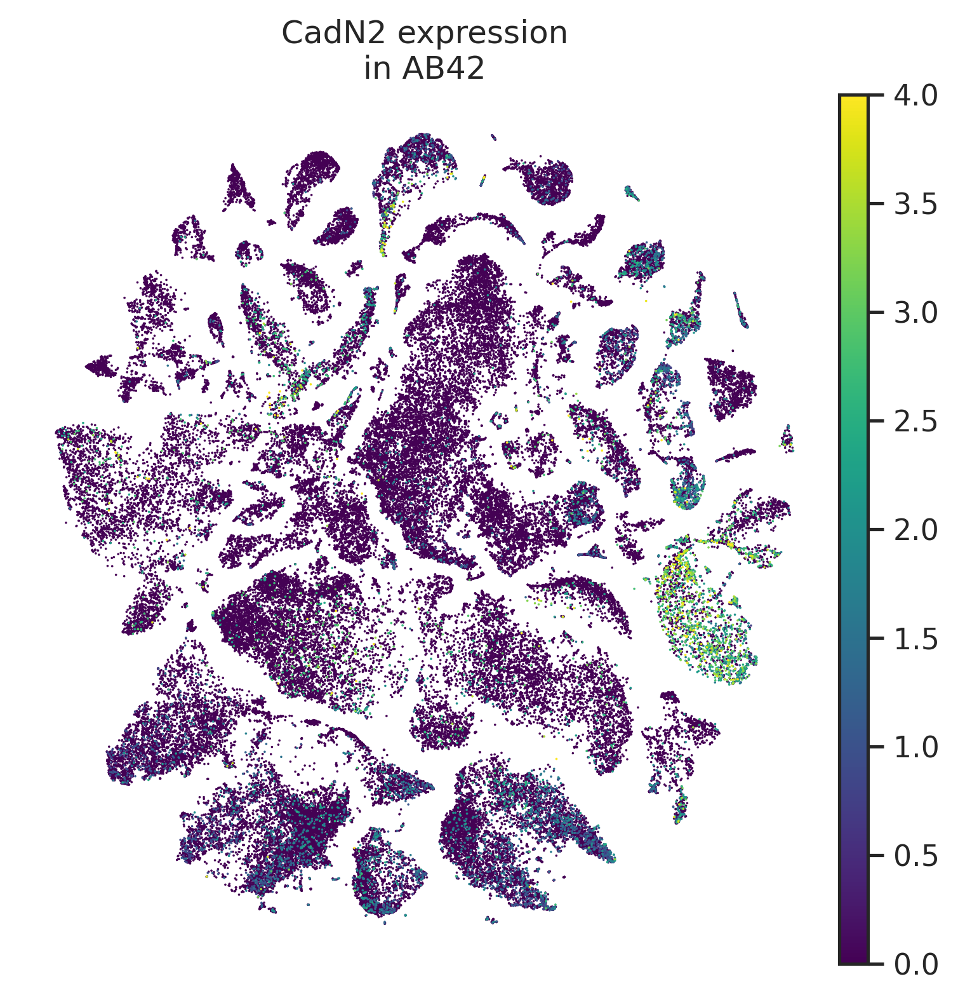

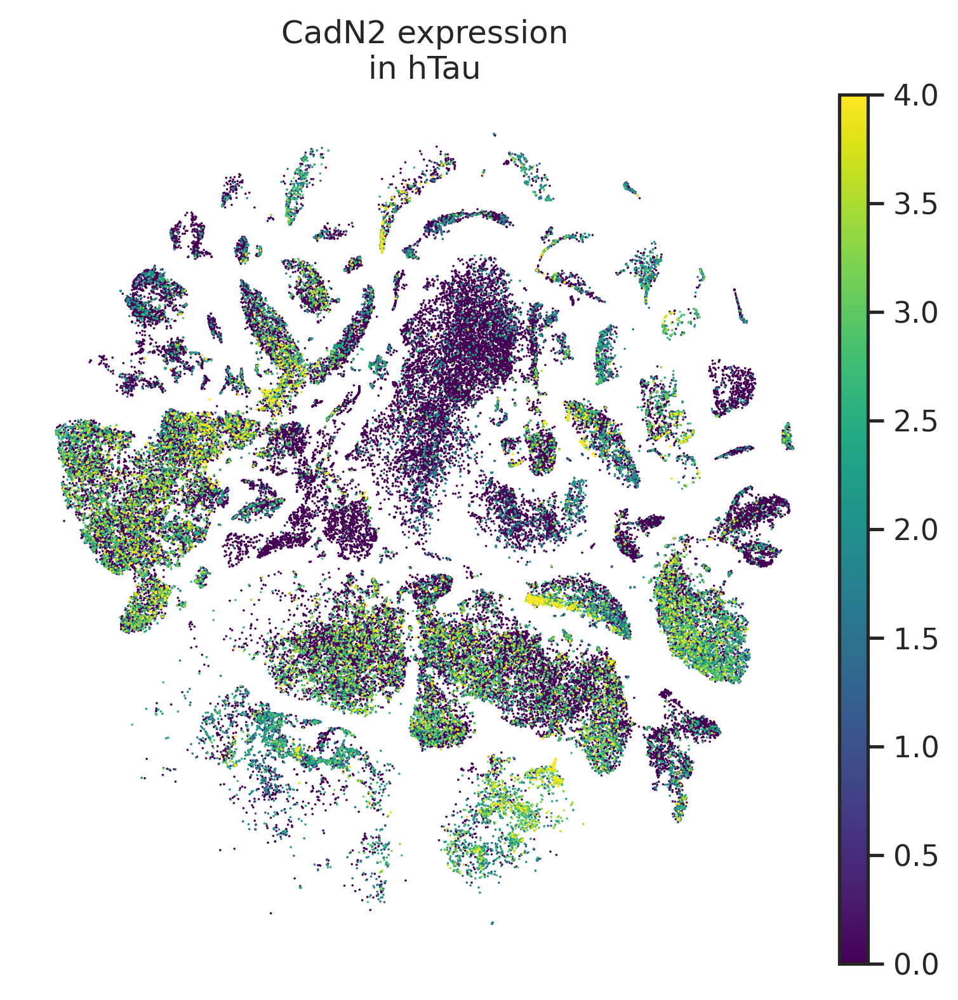

In [122]:
with rc_context({'figure.figsize': (6, 6)}):
    for genotype in genotype_L:
        g=sc.pl.tsne(adata_body[adata_body.obs.genotype == genotype], color='CadN2', cmap='viridis', vmax=4, show=False, frameon=False, title=f'CadN2 expression\nin {genotype}', size=3)
        plt.savefig(f'{figure6PicFolder}/tsne_CadN2_{genotype}_viridis.pdf')

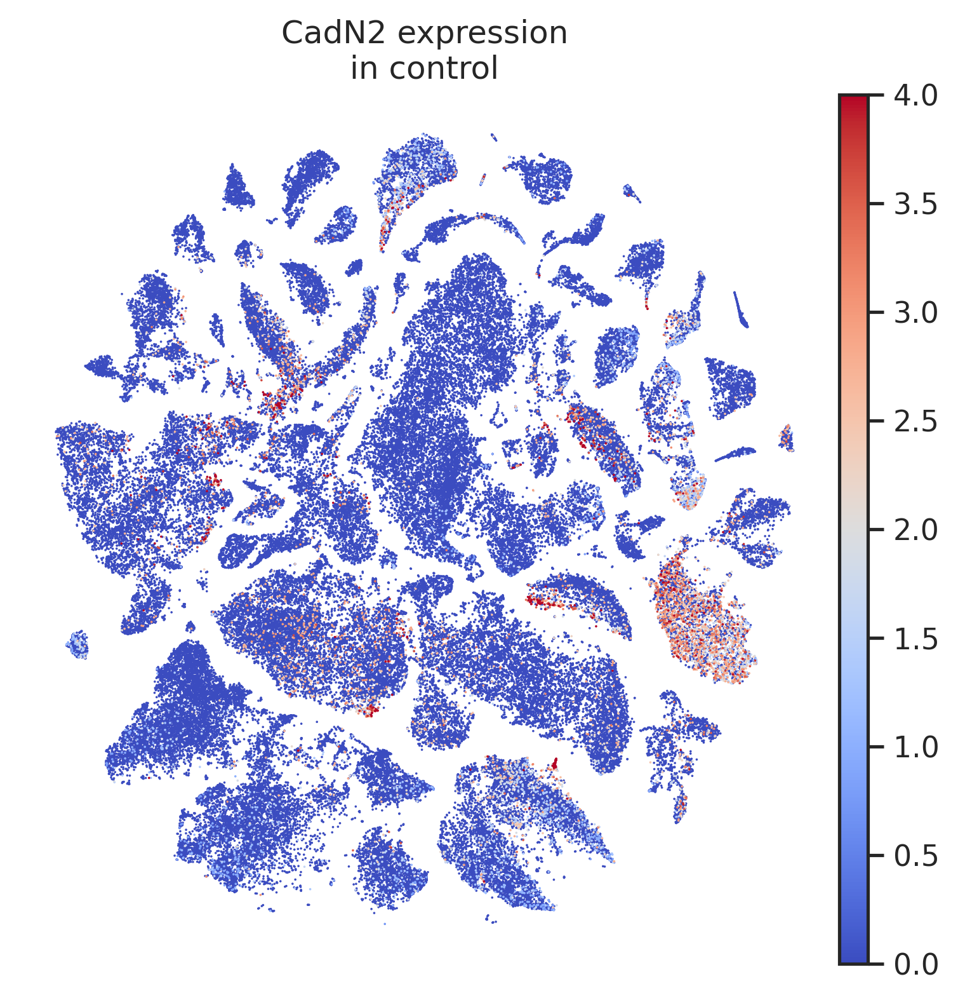

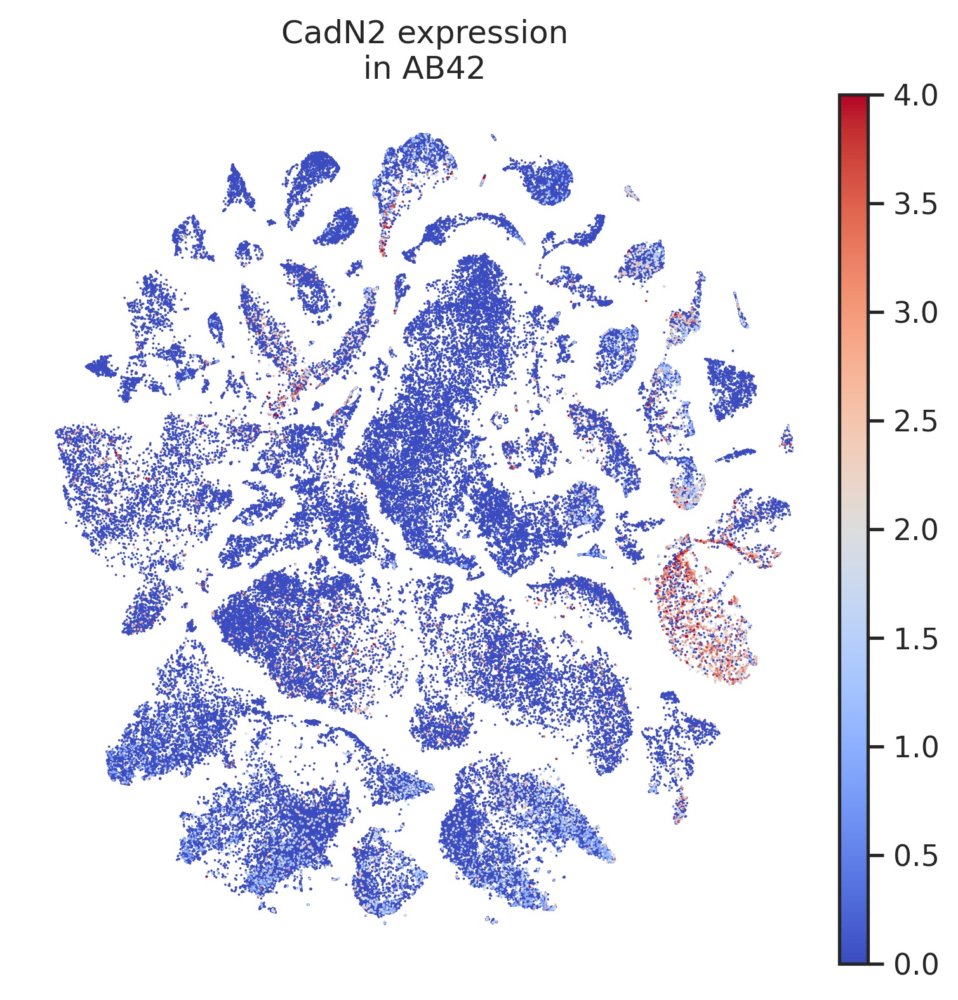

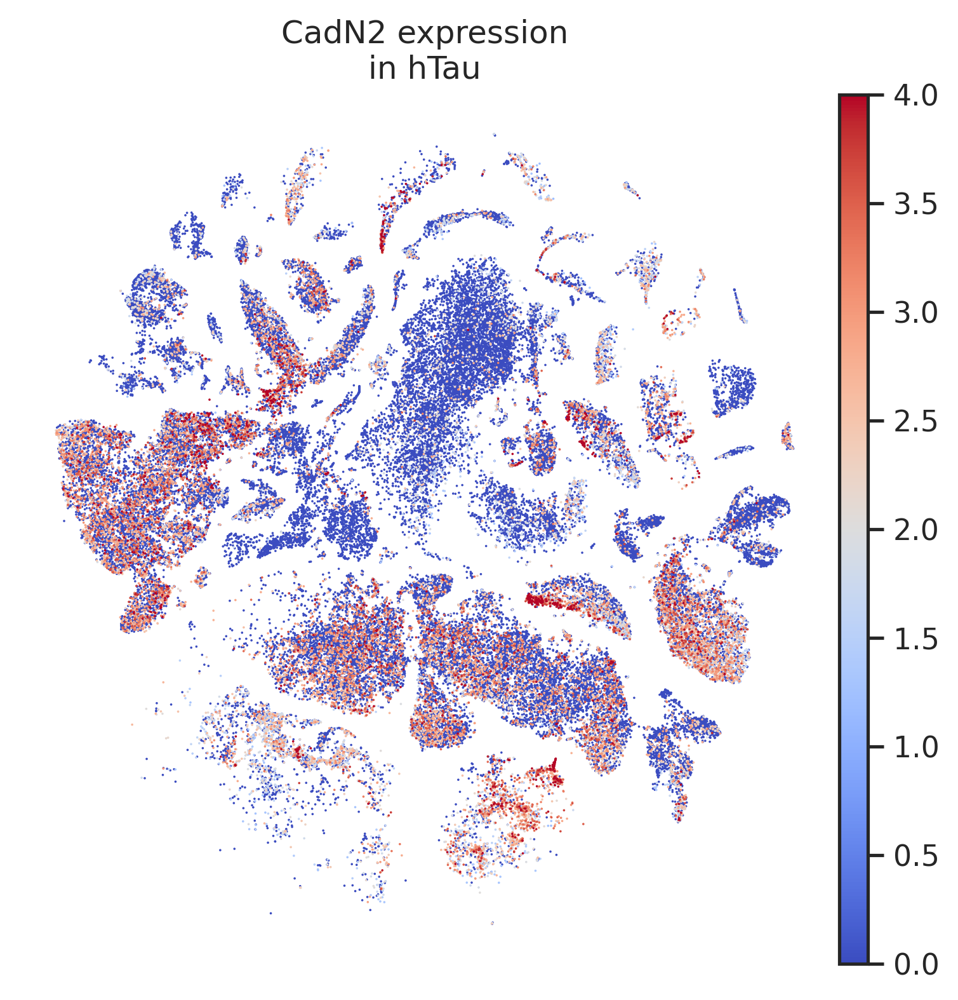

In [130]:
with rc_context({'figure.figsize': (6, 6)}):
    for genotype in genotype_L:
        g=sc.pl.tsne(adata_body[adata_body.obs.genotype == genotype], color='CadN2', cmap='coolwarm', vmax=4, show=False, frameon=False, title=f'CadN2 expression\nin {genotype}', size=3)
        plt.savefig(f'{figure6PicFolder}/tsne_CadN2_{genotype}_coolwarm.pdf')

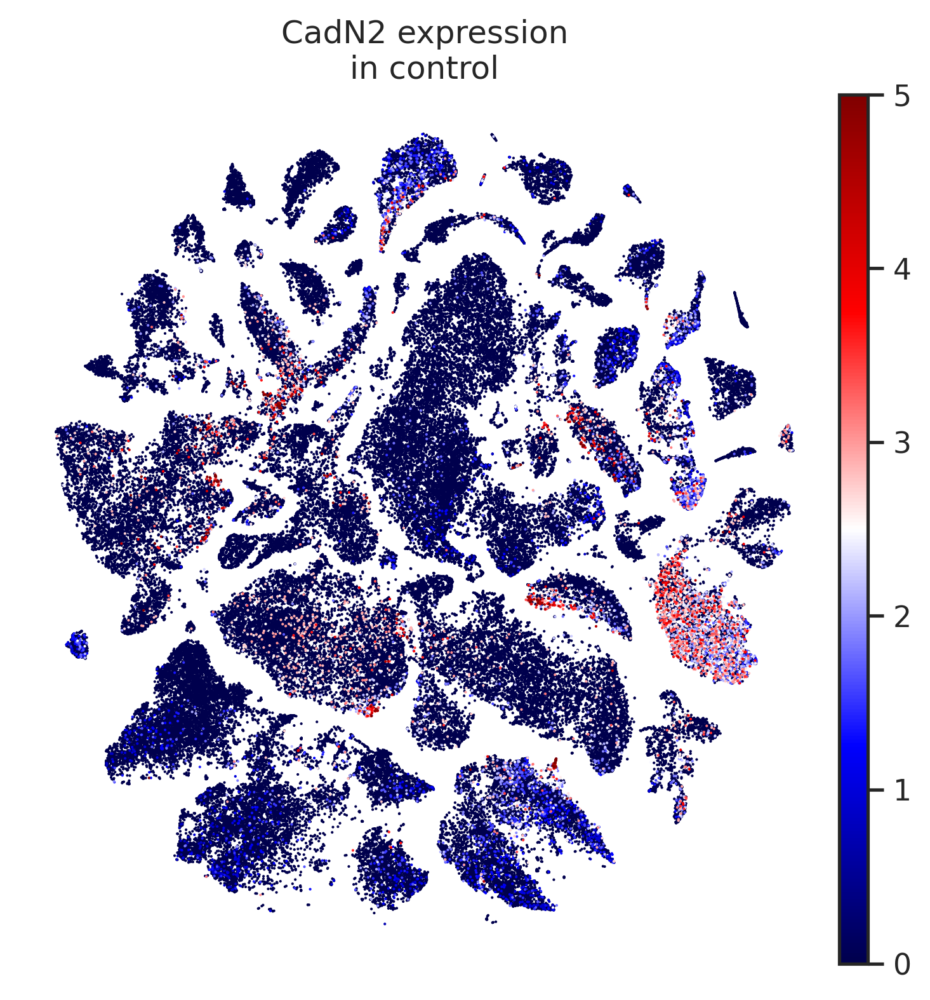

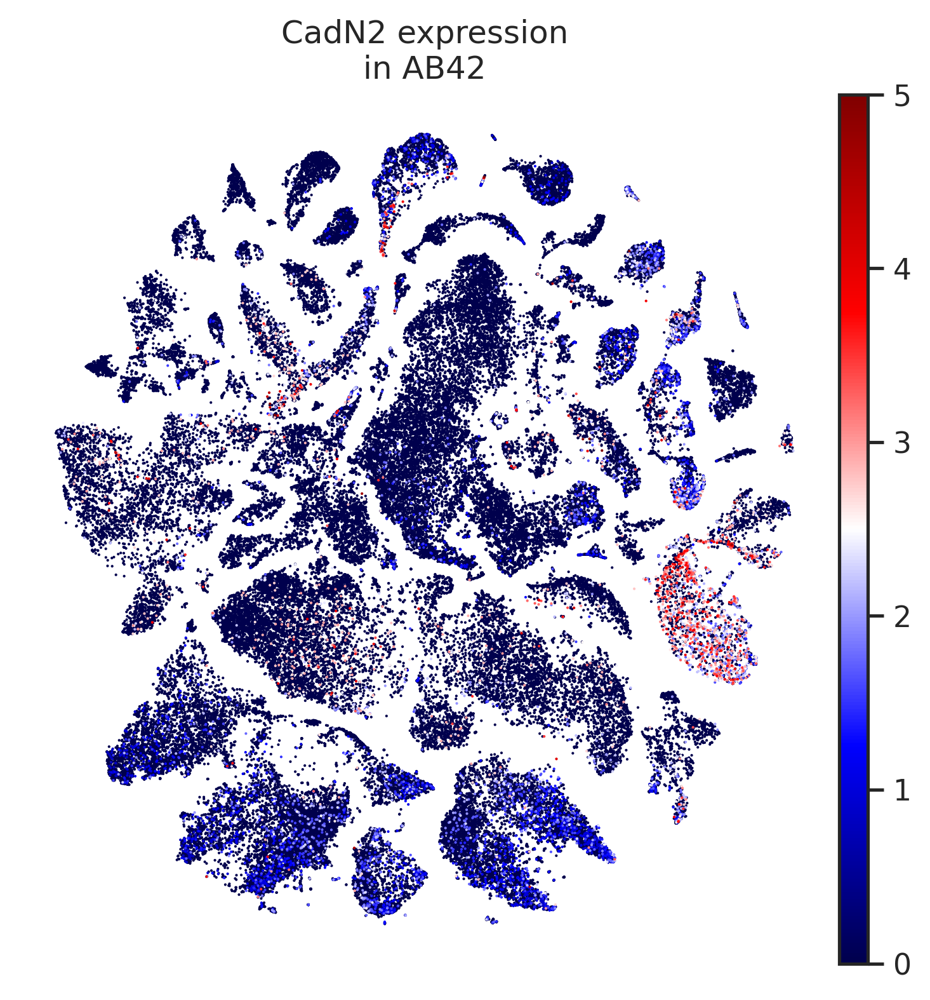

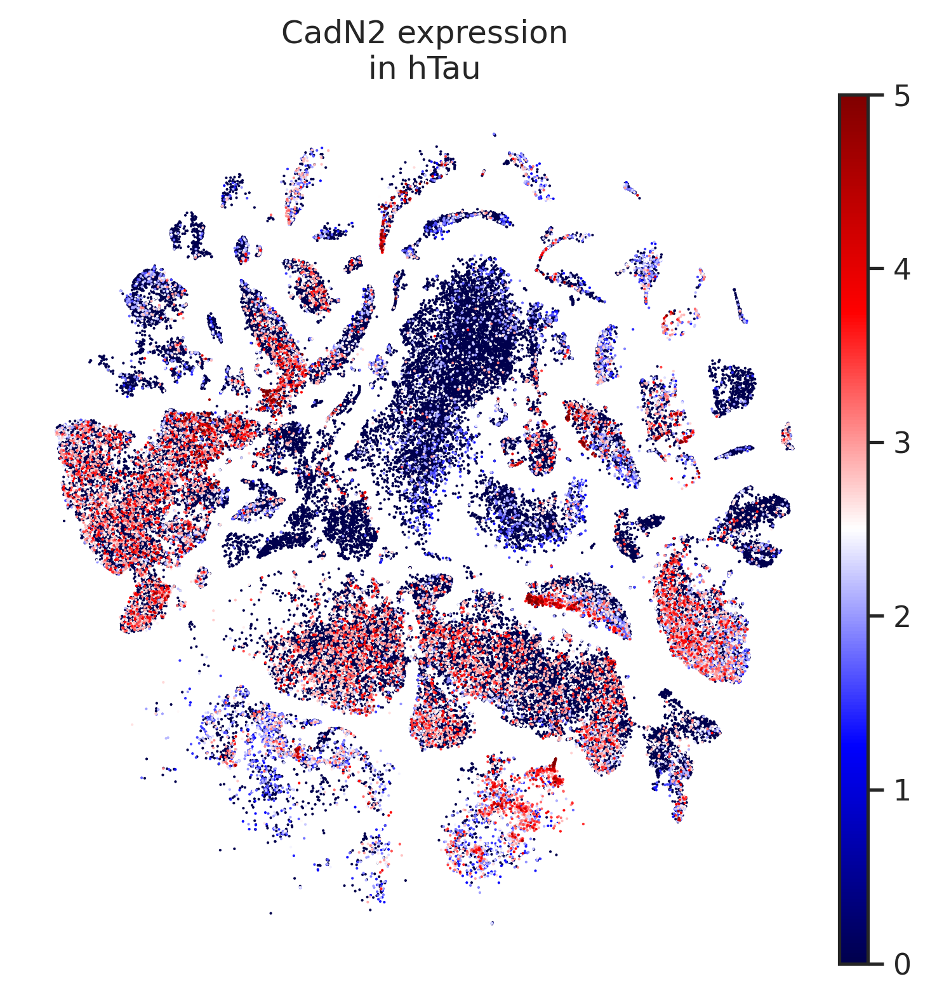

In [135]:
with rc_context({'figure.figsize': (6, 6)}):
    for genotype in genotype_L:
        g=sc.pl.tsne(adata_body[adata_body.obs.genotype == genotype], color='CadN2', cmap='seismic', vmax=5, show=False, frameon=False, title=f'CadN2 expression\nin {genotype}', size=4)
        plt.savefig(f'{figure6PicFolder}/tsne_CadN2_{genotype}_seismic.pdf')

# Fig 6C: Generate Neuron<->Periphery matrix

## Load h5ad

In [27]:
adata_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.6/adfca_head_v0.6_woHarmony_raw.h5ad')
adata_body = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.6/adfca_body_v0.6_woHarmony_raw.h5ad')

In [28]:
adata_headBody = adata_head.concatenate(adata_body, join='outer')
adata_headBody

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


AnnData object with n_obs × n_vars = 624458 × 16219
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'leiden_1.0', 'leiden_1.5', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'leiden_7.0', 'leiden_8.0', 'leiden_9.0', 'leiden_10.0', 'adfca_annotation_group', 'adfca_annotation_subcluster'
    var: 'gene_ids', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'
    layers: 'logNormalize_exp', 'umi_counts'

## Load neuron list

In [29]:
# neuronCellType_L
broadNeuron_L = [broadtype for broadtype in pd.Categorical(adata_headBody.obs.adfca_annotation_broad).categories if 'neuron' in broadtype] # 
broadNeuron_L

['CNS neuron', 'PNS neuron', 'sensory neuron']

In [30]:
annotation_Df = pd.read_csv(f'/data/tcl/Project/ADFCA/adataProcess/v0.6/adfca_annotation_detailed_and_broad_detailed.csv')
annotation_Df

,adfca_annotation_broad,adfca_annotation_group,adfca_annotation
0,CNS neuron,ABeta42-specific cluster,ABeta42-specific cluster
1,CNS neuron,Poxn neuron,Poxn neuron
2,CNS neuron,T neuron,T neuron T2
3,CNS neuron,T neuron,T neuron T2a
4,CNS neuron,T neuron,T neuron T3
...,...,...,...
178,sensory neuron,sensory neuron,scolopidial neuron
179,tracheal cell,tracheal cell,adult tracheal cell_body
180,tracheal cell,tracheal cell,adult tracheal cell_head
181,unannotated,unannotated,antimicrobial peptide-producing cell


In [31]:
neuronCellType_L = annotation_Df[annotation_Df.adfca_annotation_broad.isin(broadNeuron_L)].adfca_annotation.to_list()
nonNeuronCellType_L = annotation_Df[~annotation_Df.adfca_annotation_broad.isin(broadNeuron_L)].adfca_annotation.to_list()
# neuronCellType_L

In [32]:
neuN700_L = list(set(neuronCellType_L) & set(celltypeN700_L))
# neuN700_L

In [33]:
delta_DEG_Df_e05_z2 = pd.read_csv(f'{figure6Folder}/delta_DEG_Df_e05_z2.csv')
delta_DEG_Df_e05_z2_Neu = pd.read_csv(f'{figure6Folder}/delta_DEG_Df_e05_z2_Neu.csv')
delta_DEG_Df_e05_z2_Peri = pd.read_csv(f'{figure6Folder}/delta_DEG_Df_e05_z2_Peri')

## output number of LR z2 pairs

In [34]:
perN700_L = list(set(nonNeuronCellType_L) & set(celltypeN700_L))

In [35]:
neuToPer_Df = pd.DataFrame(columns=neuN700_L, index=perN700_L)
perToNeu_Df = neuToPer_Df.copy()

In [36]:
delta_DEG_Df_e05_z2_Neu[delta_DEG_Df_e05_z2_Neu.receptor_celltype.isin(neuronCellType_L)]

,LR_pair,pathway_GO,Gene_secreted,Gene_receptor,cellTypePair,controlScore,tauScore,deltaScore,controlPvalue,tauPvalue,...,ligand_adj,ligand_logFC,receptor_adj,receptor_logFC,ligand_-log10Padj,receptor_-log10Padj,abs_deltaScore,controlPvalue_-log10,tauPvalue_-log10,Z Score


In [37]:
delta_DEG_Df_e05_z2_Neu[delta_DEG_Df_e05_z2_Neu.ligand_celltype.isin(nonNeuronCellType_L)]

,LR_pair,pathway_GO,Gene_secreted,Gene_receptor,cellTypePair,controlScore,tauScore,deltaScore,controlPvalue,tauPvalue,...,ligand_adj,ligand_logFC,receptor_adj,receptor_logFC,ligand_-log10Padj,receptor_-log10Padj,abs_deltaScore,controlPvalue_-log10,tauPvalue_-log10,Z Score


In [50]:
delta_DEG_Df_e05_z2_Peri.cellTypePair.value_counts().head(15)

enterocyte of posterior adult midgut epithelium>ocellus retinula cell             10
adult hindgut>lamina monopolar neuron L3                                          10
adult hindgut>transmedullary neuron Tm4                                           10
adult hindgut>medullary intrinsic neuron Mi9                                      10
male accessory gland main cell_roX1+>lobula columnar neuron LC17                  10
enterocyte of posterior adult midgut epithelium>olfactory projection neuron       10
adult hindgut>neuron 6                                                             9
enterocyte of posterior adult midgut epithelium>medullary intrinsic neuron Mi9     9
adult hindgut>lobula columnar neuron LC17                                          9
enterocyte of posterior adult midgut epithelium>lobula columnar neuron LC16        9
male accessory gland main cell_roX1+>olfactory projection neuron                   9
enterocyte of posterior adult midgut epithelium>neuron 8         

In [38]:
for i, neuCt in enumerate(neuToPer_Df.columns):
    for j, perCt in enumerate(neuToPer_Df.index):
        # print(i,j,neuCt,perCt)
        # print('Number of differential CCCs: ', len(delta_DEG_Df_e05_z2_Neu[ (delta_DEG_Df_e05_z2_Neu.ligand_celltype == neuCt) & (delta_DEG_Df_e05_z2_Neu.receptor_celltype == perCt) ]))
        
        neuToPer_Df.iloc[j, i] = len(delta_DEG_Df_e05_z2_Neu[ (delta_DEG_Df_e05_z2_Neu.ligand_celltype == neuCt) & (delta_DEG_Df_e05_z2_Neu.receptor_celltype == perCt) ])

In [53]:
for i, neuCt in enumerate(perToNeu_Df.columns):
    for j, perCt in enumerate(perToNeu_Df.index):
        # print(i,j,neuCt,perCt)
        # print('Number of differential CCCs: ', len(delta_DEG_Df_e05_z2_Peri[ (delta_DEG_Df_e05_z2_Peri.ligand_celltype == perCt) & (delta_DEG_Df_e05_z2_Peri.receptor_celltype == neuCt) ]))
        
        perToNeu_Df.iloc[j, i] = len(delta_DEG_Df_e05_z2_Peri[ (delta_DEG_Df_e05_z2_Peri.ligand_celltype == perCt) & (delta_DEG_Df_e05_z2_Peri.receptor_celltype == neuCt) ])

In [54]:
perToNeu_Df.head()

,transmedullary Y neuron TmY3,neuron 4,lamina intrinsic neuron,adult peripheral nervous system,neuron 2,lamina monopolar neuron L3,lamina monopolar neuron L4,cone cell,lamina monopolar neuron L1,ABeta42-specific cluster,...,medullary intrinsic neuron Mi1,olfactory receptor neuron,lamina monopolar neuron L5,auditory sensory neuron,centrifugal neuron C2,transmedullary neuron Tm9,transmedullary neuron Tm2,transmedullary neuron Tm20,transmedullary Y neuron TmY8,neuron 1
subperineurial glial cell_head,2,1,0,2,2,3,0,0,0,2,...,2,1,1,1,2,3,1,3,1,3
germline cell,1,0,0,1,1,1,1,0,0,0,...,2,1,0,1,0,1,1,0,0,0
seminal vesicle & testis epithelia,4,3,3,4,3,4,2,4,1,4,...,4,0,3,3,3,7,3,5,3,3
crop,0,0,0,1,2,1,0,1,0,0,...,2,0,0,0,1,0,1,0,0,0
perineurial glial sheath,3,3,0,3,3,3,1,3,0,1,...,2,3,3,3,2,3,4,2,2,1


In [55]:
neuToPer_Df.to_csv(f'{figure6Folder}/neuToPer_Df.csv')
perToNeu_Df.to_csv(f'{figure6Folder}/perToNeu_Df.csv')

neuToPer_Df.T.to_csv(f'{figure6Folder}/neuToPer_Df_T.csv')
perToNeu_Df.T.to_csv(f'{figure6Folder}/perToNeu_Df_T.csv')

**Generate chord plot using R - circlize**

# Differential CCCs

## Load h5ad

In [56]:
adata_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.6/adfca_head_v0.6_woHarmony_raw.h5ad')
adata_body = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.6/adfca_body_v0.6_woHarmony_raw.h5ad')

In [57]:
adata_headBody = adata_head.concatenate(adata_body, join='outer')
adata_headBody

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


AnnData object with n_obs × n_vars = 624458 × 16219
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'leiden_1.0', 'leiden_1.5', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'leiden_7.0', 'leiden_8.0', 'leiden_9.0', 'leiden_10.0', 'adfca_annotation_group', 'adfca_annotation_subcluster'
    var: 'gene_ids', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'
    layers: 'logNormalize_exp', 'umi_counts'

## Load neuron list

In [58]:
# neuronCellType_L
broadNeuron_L = [broadtype for broadtype in pd.Categorical(adata_headBody.obs.adfca_annotation_broad).categories if 'neuron' in broadtype] # 
broadNeuron_L

['CNS neuron', 'PNS neuron', 'sensory neuron']

In [59]:
annotation_Df = pd.read_csv(f'/data/tcl/Project/ADFCA/adataProcess/v0.6/adfca_annotation_detailed_and_broad_detailed.csv')
annotation_Df

,adfca_annotation_broad,adfca_annotation_group,adfca_annotation
0,CNS neuron,ABeta42-specific cluster,ABeta42-specific cluster
1,CNS neuron,Poxn neuron,Poxn neuron
2,CNS neuron,T neuron,T neuron T2
3,CNS neuron,T neuron,T neuron T2a
4,CNS neuron,T neuron,T neuron T3
...,...,...,...
178,sensory neuron,sensory neuron,scolopidial neuron
179,tracheal cell,tracheal cell,adult tracheal cell_body
180,tracheal cell,tracheal cell,adult tracheal cell_head
181,unannotated,unannotated,antimicrobial peptide-producing cell


In [60]:
neuronCellType_L = annotation_Df[annotation_Df.adfca_annotation_broad.isin(broadNeuron_L)].adfca_annotation.to_list()
nonNeuronCellType_L = annotation_Df[~annotation_Df.adfca_annotation_broad.isin(broadNeuron_L)].adfca_annotation.to_list()
# neuronCellType_L

In [61]:
neuN700_L = list(set(neuronCellType_L) & set(celltypeN700_L))
# neuN700_L

In [62]:
delta_DEG_Df_e05_z2 = pd.read_csv(f'{figure6Folder}/delta_DEG_Df_e05_z2.csv')
delta_DEG_Df_e05_z2

,LR_pair,pathway_GO,Gene_secreted,Gene_receptor,cellTypePair,controlScore,tauScore,deltaScore,controlPvalue,tauPvalue,...,ligand_adj,ligand_logFC,receptor_adj,receptor_logFC,ligand_-log10Padj,receptor_-log10Padj,abs_deltaScore,controlPvalue_-log10,tauPvalue_-log10,Z Score
0,Sdc>Lar,other|nan,Sdc,Lar,16-cell germline cyst in germarium region 2a a...,1.244238,1.077359,-0.166878,0.0,0.0,...,0.002772,-0.491862,1.000000e+00,-0.313898,2.557279,-0.000000,0.166878,inf,inf,-2.277281
1,Bsg>Bsg,other|homophilic cell adhesion via plasma memb...,Bsg,Bsg,16-cell germline cyst in germarium region 2a a...,1.511225,1.363050,-0.148175,0.0,0.0,...,0.696155,-0.341356,1.000000e+00,-0.312404,0.157294,-0.000000,0.148175,inf,inf,-2.024708
2,Sdc>Lar,other|nan,Sdc,Lar,16-cell germline cyst in germarium region 2a a...,1.327977,1.153000,-0.174977,0.0,0.0,...,0.002772,-0.491862,1.000000e+00,-0.329973,2.557279,-0.000000,0.174977,inf,inf,-2.386647
3,ed>ed,other|homophilic cell adhesion via plasma memb...,ed,ed,16-cell germline cyst in germarium region 2a a...,0.841821,1.007792,0.165971,0.0,0.0,...,0.773857,-0.372139,1.000000e+00,0.717518,0.111339,-0.000000,0.165971,inf,inf,2.217546
4,rst>rst,other|homophilic cell adhesion via plasma memb...,rst,rst,16-cell germline cyst in germarium region 2a a...,0.918176,0.594688,-0.323488,0.0,0.0,...,1.000000,-0.040845,1.038155e-52,-1.212743,-0.000000,51.983738,0.323488,inf,inf,-4.392149
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17081,Lar>Sdc,other|nan,Lar,Sdc,transmedullary Y neuron TmY8>transmedullary Y ...,1.018836,0.829631,-0.189205,0.0,0.0,...,1.000000,-0.504876,1.000000e+00,-0.413045,-0.000000,-0.000000,0.189205,inf,inf,-2.578781
17082,Sema1a>PlexA,other|axon guidance,Sema1a,PlexA,transmedullary Y neuron TmY8>transmedullary Y ...,0.609536,0.817987,0.208451,0.0,0.0,...,1.000000,0.602533,1.000000e+00,0.546172,-0.000000,-0.000000,0.208451,inf,inf,2.791204
17083,Lar>Lar,other|homophilic cell adhesion via plasma memb...,Lar,Lar,transmedullary Y neuron TmY8>transmedullary Y ...,0.881810,0.688072,-0.193738,0.0,0.0,...,1.000000,-0.504876,1.000000e+00,-0.504876,-0.000000,-0.000000,0.193738,inf,inf,-2.640000
17084,Lar>Sdc,other|nan,Lar,Sdc,transmedullary Y neuron TmY8>transmedullary Y ...,1.007469,0.793960,-0.213509,0.0,0.0,...,1.000000,-0.504876,1.000000e+00,-0.556892,-0.000000,-0.000000,0.213509,inf,inf,-2.906986


In [63]:
delta_DEG_Df_e05_z2.columns

Index(['LR_pair', 'pathway_GO', 'Gene_secreted', 'Gene_receptor',
       'cellTypePair', 'controlScore', 'tauScore', 'deltaScore',
       'controlPvalue', 'tauPvalue', 'ligand_celltype', 'receptor_celltype',
       'ligand_adj', 'ligand_logFC', 'receptor_adj', 'receptor_logFC',
       'ligand_-log10Padj', 'receptor_-log10Padj', 'abs_deltaScore',
       'controlPvalue_-log10', 'tauPvalue_-log10', 'Z Score'],
      dtype='object')

In [88]:
neuToPer_Df = pd.read_csv(f'{figure6Folder}/neuToPer_Df.csv', index_col=0)
perToNeu_Df = pd.read_csv(f'{figure6Folder}/perToNeu_Df.csv', index_col=0)

In [89]:
neuToPer_Df.head()

,transmedullary Y neuron TmY3,neuron 4,lamina intrinsic neuron,adult peripheral nervous system,neuron 2,lamina monopolar neuron L3,lamina monopolar neuron L4,cone cell,lamina monopolar neuron L1,ABeta42-specific cluster,...,medullary intrinsic neuron Mi1,olfactory receptor neuron,lamina monopolar neuron L5,auditory sensory neuron,centrifugal neuron C2,transmedullary neuron Tm9,transmedullary neuron Tm2,transmedullary neuron Tm20,transmedullary Y neuron TmY8,neuron 1
subperineurial glial cell_head,1,2,1,3,3,3,0,0,0,2,...,3,1,1,2,3,4,2,2,2,3
germline cell,2,0,0,1,1,1,1,0,0,0,...,2,1,0,1,0,1,1,0,0,0
seminal vesicle & testis epithelia,1,0,2,1,1,1,0,2,0,2,...,1,0,2,0,2,3,0,1,0,2
crop,0,1,0,1,2,2,0,3,0,0,...,3,0,0,0,1,2,1,1,0,0
perineurial glial sheath,4,4,0,4,3,6,1,5,1,1,...,3,3,3,4,4,5,4,3,3,2


In [90]:
perToNeu_Df.head()

,transmedullary Y neuron TmY3,neuron 4,lamina intrinsic neuron,adult peripheral nervous system,neuron 2,lamina monopolar neuron L3,lamina monopolar neuron L4,cone cell,lamina monopolar neuron L1,ABeta42-specific cluster,...,medullary intrinsic neuron Mi1,olfactory receptor neuron,lamina monopolar neuron L5,auditory sensory neuron,centrifugal neuron C2,transmedullary neuron Tm9,transmedullary neuron Tm2,transmedullary neuron Tm20,transmedullary Y neuron TmY8,neuron 1
subperineurial glial cell_head,2,1,0,2,2,3,0,0,0,2,...,2,1,1,1,2,3,1,3,1,3
germline cell,1,0,0,1,1,1,1,0,0,0,...,2,1,0,1,0,1,1,0,0,0
seminal vesicle & testis epithelia,4,3,3,4,3,4,2,4,1,4,...,4,0,3,3,3,7,3,5,3,3
crop,0,0,0,1,2,1,0,1,0,0,...,2,0,0,0,1,0,1,0,0,0
perineurial glial sheath,3,3,0,3,3,3,1,3,0,1,...,2,3,3,3,2,3,4,2,2,1


In [91]:
neuToPer_counts_L_Df = pd.DataFrame(neuToPer_Df.sum(axis=0).sort_values(ascending=False), columns=['counts'])
neuToPer_counts_L_Df.head()

,counts
lamina monopolar neuron L3,172
lobula columnar neuron LC17,167
transmedullary neuron Tm9,166
olfactory projection neuron,161
transmedullary neuron Tm4,158


In [92]:
neuToPer_counts_R_Df = pd.DataFrame(neuToPer_Df.sum(axis=1).sort_values(ascending=False), columns=['counts'])
neuToPer_counts_R_Df.head()

,counts
enterocyte of posterior adult midgut epithelium,497
adult hindgut,376
enterocyte of anterior adult midgut epithelium,243
male accessory gland main cell_roX1+,240
adult fat body_head,235


In [93]:
perToNeu_counts_L_Df = pd.DataFrame(perToNeu_Df.sum(axis=1).sort_values(ascending=False), columns=['counts'])
perToNeu_counts_L_Df.head()

,counts
enterocyte of posterior adult midgut epithelium,372
adult hindgut,372
male accessory gland main cell_roX1+,279
adult fat body_body,205
adult fat body_head,203


In [94]:
perToNeu_counts_R_Df = pd.DataFrame(perToNeu_Df.sum(axis=0).sort_values(ascending=False), columns=['counts'])
perToNeu_counts_R_Df.head()

,counts
lamina monopolar neuron L3,153
lobula columnar neuron LC17,153
olfactory projection neuron,144
neuron 2,137
transmedullary neuron Tm9,136


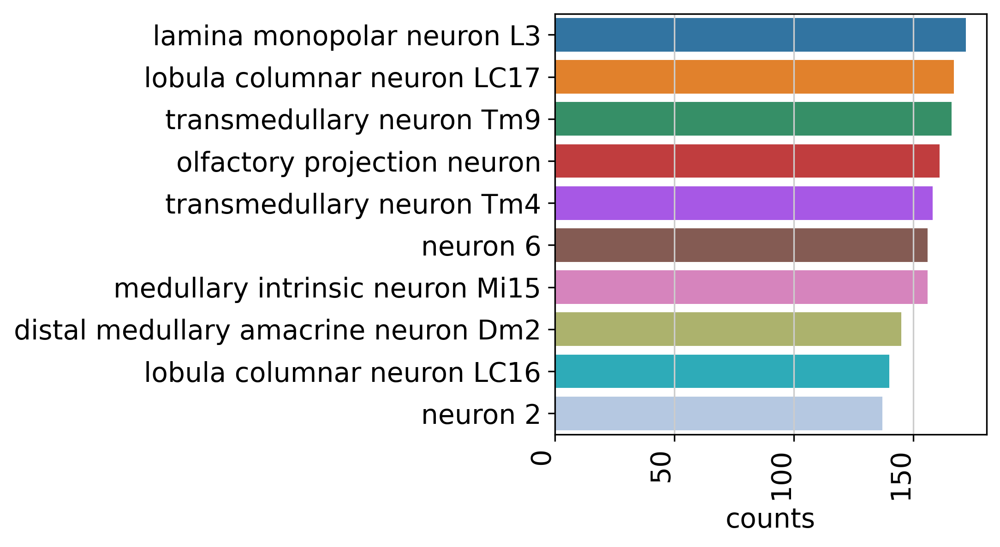

In [71]:
fig, ax = plt.subplots(figsize=(4, 4))
sns.barplot(x = neuToPer_counts_L_Df.counts[:10], y= neuToPer_counts_L_Df.index.to_list()[:10])
plt.xticks(rotation=90, horizontalalignment='right')
plt.savefig(f'{figure6PicFolder}/neuToPer_counts_L_Df__top10.pdf', bbox_inches='tight')

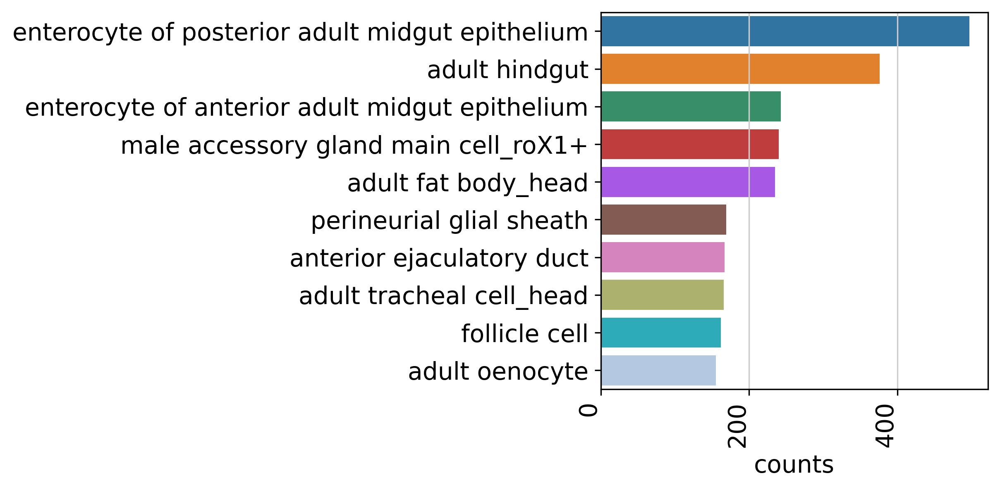

In [72]:
fig, ax = plt.subplots(figsize=(4, 4))
sns.barplot(x = neuToPer_counts_R_Df.counts[:10], y= neuToPer_counts_R_Df.index.to_list()[:10])
plt.xticks(rotation=90, horizontalalignment='right')
plt.savefig(f'{figure6PicFolder}/neuToPer_counts_R_Df__top10.pdf', bbox_inches='tight')

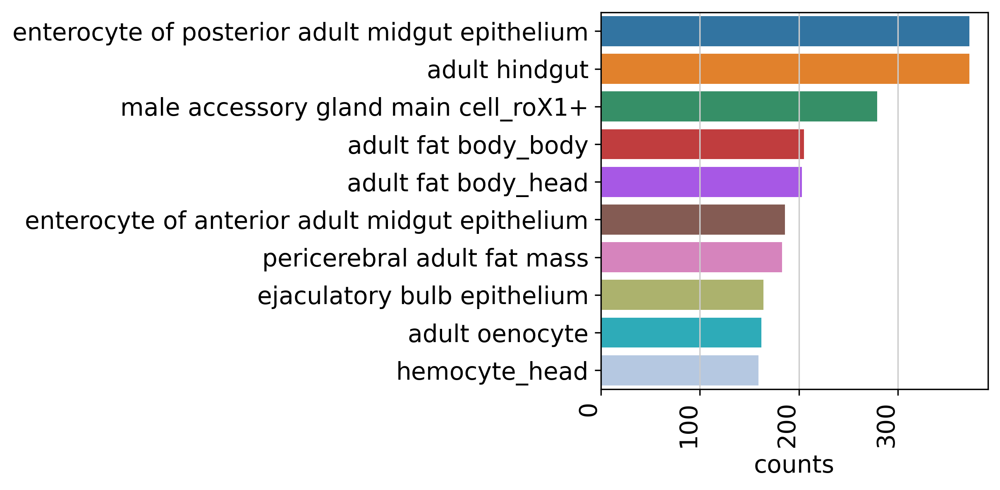

In [73]:
fig, ax = plt.subplots(figsize=(4, 4))
sns.barplot(x = perToNeu_counts_L_Df.counts[:10], y= perToNeu_counts_L_Df.index.to_list()[:10])
plt.xticks(rotation=90, horizontalalignment='right')
plt.savefig(f'{figure6PicFolder}/perToNeu_counts_L_Df__top10.pdf', bbox_inches='tight')

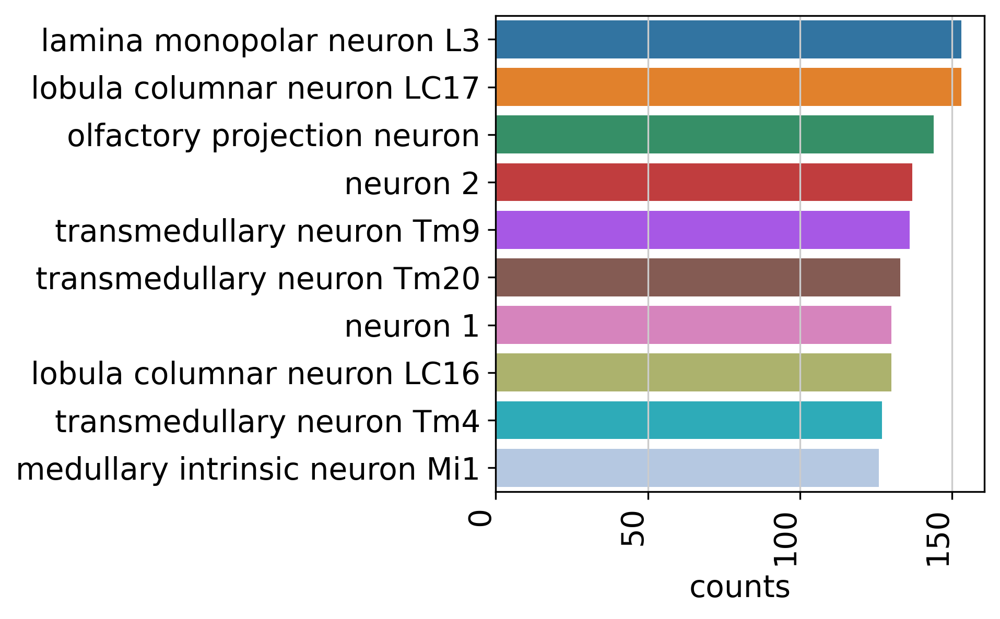

In [74]:
fig, ax = plt.subplots(figsize=(4, 4))
sns.barplot(x = perToNeu_counts_R_Df.counts[:10], y= perToNeu_counts_R_Df.index.to_list()[:10])
plt.xticks(rotation=90, horizontalalignment='right')
plt.savefig(f'{figure6PicFolder}/perToNeu_counts_R_Df__top10.pdf', bbox_inches='tight')

# Finished